<a href="https://colab.research.google.com/github/mrrajabzadeh/Google-Trends/blob/main/LSTM_Model_12_18.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install tensorflow==2.10.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 578.0/578.0 MB 571.0 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 20.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 kB 1.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 34.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 92.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 438.7/438.7 kB 20.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.9/4.9 MB 81.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 781.3/781.3 kB 34.8 MB/s eta 0:00:00
  Attempting uninstall: keras
    Found existing installation: keras 2.15.0
    Uninstalling keras-2.15.0:
      Successfully uninstalled keras-2.15.0
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.15.0
    Uninstalling tensorflow-estimator-2.15.0:
      Successfully uninstalled tensorflow-estimator-2.15.0
  Attemp

In [2]:
pip install tensorflow-probability==0.14.0

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 46.7 MB/s eta 0:00:00
  Attempting uninstall: tensorflow-probability
    Found existing installation: tensorflow-probability 0.24.0
    Uninstalling tensorflow-probability-0.24.0:
      Successfully uninstalled tensorflow-probability-0.24.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
distrax 0.1.5 requires tensorflow-probability>=0.15.0, but you have tensorflow-probability 0.14.0 which is incompatible.


In [3]:
pip install imblearn openpyxl

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.9/250.9 kB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 238.4/238.4 kB 14.2 MB/s eta 0:00:00


In [4]:
# Import required libraries
import numpy as np
import pandas as pd
import tensorflow_probability as tfp
import tensorflow as tf
import imblearn
from datetime import datetime, timedelta
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Masking, LSTM, TimeDistributed, Layer, Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint
from imblearn.over_sampling import SMOTE
import glob
import matplotlib.pyplot as plt
import seaborn as sns
from openpyxl import Workbook
from tensorflow.keras.regularizers import l2
from sklearn.utils import resample
from tensorflow.keras import backend as K

# Print TensorFlow version
print("TensorFlow version:", tf.__version__)
print("tensorflow_probability version:", tfp.__version__)

TensorFlow version: 2.10.0
tensorflow_probability version: 0.14.0


In [5]:
from google.colab import drive
drive.mount('/content/drive')
import pandas as pd

# Define the path to your file in Google Drive
csv_save_path = '/content/drive/My Drive/Merged/df_variables.csv'

# Load the CSV into a DataFrame
df = pd.read_csv(csv_save_path)

# Display the first few rows of the DataFrame to confirm it's loaded correctly
df.head()

Mounted at /content/drive


,PT_ID,ENCOUNTER_DTTM,VISIT_TYPE,STATUS_CD,SCHD_DTTM,CNCL_DTTM,CNCL_REASON_DESCR,cancelled_within_24h,Valid_Previous_Indices,Row_Index,...,Encounter_Weekday,Weekend_Indicator,Encounter_Hour,Avg_Encounter_Frequency_Hours,First_Follow_Up,Last_Appointment_Status,Avg_Schd_Encounter_Diff_Hours,Average_Arrival_Lag,Average_Arrival_Lag_Hours,Time_Since_Last_Visit
0,0000C0F3-3936-4E57-8113-EA5CB520DAFA,2021-12-16 11:15:00,BLOOD DRAW,Completed,2021-06-24 15:09:15,NaN,NaN,0,[],0,...,Thursday,0,before 12pm,NaN,First,NaN,NaN,NaN,NaN,NaN
1,0000C0F3-3936-4E57-8113-EA5CB520DAFA,2021-12-16 12:30:00,ESTABLISHED PATIENT,Completed,2021-06-24 15:09:16,NaN,NaN,0,[],1,...,Thursday,0,between 12-18pm,NaN,Follow-Up,NaN,NaN,NaN,NaN,NaN
2,0000C0F3-3936-4E57-8113-EA5CB520DAFA,2022-06-09 12:00:00,ESTABLISHED PATIENT,Canceled,2021-12-17 15:07:58,2022-04-21,Provider - Personal,0,"[0, 1]",2,...,Thursday,0,between 12-18pm,0.3125,Follow-Up,Completed,4196.720694,-1 days +23:35:46.500000,-0.40375,26.632778
3,0000C0F3-3936-4E57-8113-EA5CB520DAFA,2022-03-10 11:10:00,BLOOD DRAW,Completed,2021-12-17 15:07:59,NaN,NaN,0,"[0, 1]",3,...,Thursday,0,before 12pm,0.3125,Follow-Up,Completed,4196.720694,-1 days +23:35:46.500000,-0.40375,26.633056
4,0000C0F3-3936-4E57-8113-EA5CB520DAFA,2022-06-09 10:50:00,BLOOD DRAW,Canceled,2021-12-17 15:07:59,2022-04-21,Provider - Personal,0,"[0, 1]",4,...,Thursday,0,before 12pm,0.3125,Follow-Up,Completed,4196.720694,-1 days +23:35:46.500000,-0.40375,26.633056


In [6]:
for column in df.columns:
    print(column)

PT_ID
ENCOUNTER_DTTM
VISIT_TYPE
STATUS_CD
SCHD_DTTM
CNCL_DTTM
CNCL_REASON_DESCR
cancelled_within_24h
Valid_Previous_Indices
Row_Index
Cancellation_Count
Patient Choice
Clinic Management
Patient Health
Socioeconomic
Provider Choice
No_Show_Left_Count
Provider_Change_Count
Provider_Changed_Last_Visit
Department_Change_Count
Department_Changed_Last_Visit
Last_Visit_Duration
Avg_STD_DURATION
Rescheduled_Appointments_Count
Encounter_Month
Encounter_Weekday
Weekend_Indicator
Encounter_Hour
Avg_Encounter_Frequency_Hours
First_Follow_Up
Last_Appointment_Status
Avg_Schd_Encounter_Diff_Hours
Average_Arrival_Lag
Average_Arrival_Lag_Hours
Time_Since_Last_Visit


In [7]:
import pandas as pd
from keras.utils import to_categorical

# Sample function to create primary_head_label
def build_primary_head_label(row):
    # If the appointment is complete
    if row['STATUS_CD'] == 'Completed':
        return 0  # Complete

    # If it's a no-show (No Show, Left without Seen, or canceled within 24h)
    if row['STATUS_CD'] in ['No Show', 'Left without seen'] or row['cancelled_within_24h'] == 1:
        return 1  # No Show

    # If the appointment is canceled (before 24 hours)
    if row['STATUS_CD'] == 'Canceled' and row['cancelled_within_24h'] == 0:
        return 2  # Canceled

    # Return NaN for invalid or missing data
    return pd.NA

# Function to create mask for third head (reason for no-show)
def build_third_head_mask(row):
    # Return 1 (True) if it's a no-show or left without seen
    if row['STATUS_CD'] in ['No Show', 'Left without seen']:
        return 1
    return 0  # Otherwise, return 0 (False)

# Apply the function to build the primary_head_label
df['primary_head_label'] = df.apply(build_primary_head_label, axis=1)

# Apply the function to create a mask for the third head
df['third_head_mask'] = df.apply(build_third_head_mask, axis=1)

# Step 1: Fill any NaN values with 0 (representing 'Completed')
print(df['primary_head_label'].isnull().sum())
df['primary_head_label'].fillna(0, inplace=True)

# Step 2: One-hot encode the integer-encoded labels
one_hot_primary_label = to_categorical(df['primary_head_label'], num_classes=3)

# Step 3: Convert the one-hot encoded array into a DataFrame
one_hot_primary_label_df = pd.DataFrame(one_hot_primary_label, columns=['Completed', 'No Show', 'Canceled'])

# Step 4: Reset the index to ensure alignment with the original DataFrame
one_hot_primary_label_df.index = df.index

# Step 5: Concatenate the one-hot encoded columns with the original DataFrame
df = pd.concat([df, one_hot_primary_label_df], axis=1)

# Display the first few rows to verify the result
print(df[['STATUS_CD', 'cancelled_within_24h', 'primary_head_label', 'Completed', 'No Show', 'Canceled', 'third_head_mask']].head())






44


<ipython-input-7-9fdcf683fc4b>:36: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['primary_head_label'].fillna(0, inplace=True)


   STATUS_CD  cancelled_within_24h  primary_head_label  Completed  No Show  \
0  Completed                     0                   0        1.0      0.0   
1  Completed                     0                   0        1.0      0.0   
2   Canceled                     0                   2        0.0      0.0   
3  Completed                     0                   0        1.0      0.0   
4   Canceled                     0                   2        0.0      0.0   

   Canceled  third_head_mask  
0       0.0                0  
1       0.0                0  
2       1.0                0  
3       0.0                0  
4       1.0                0  


<ipython-input-7-9fdcf683fc4b>:36: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['primary_head_label'].fillna(0, inplace=True)


In [8]:
import pandas as pd

# Define the reason_category_mapping as provided
reason_category_mapping = {
    'Patient Choice': [
        'Canceled via automated reminder system', 'Cancelled via Interface', 'Deleted via Interface',
        'Moved', 'Patient', 'Patient - Personal','Personal Reasons', 'Patient - Sought Care Elsewhere', 'Unhappy/Changed Provider','Sought Care Elsewhere'
    ],
    'Clinic Management': [
        'Changed by Radiology', 'Discharged', 'Displaced Appointment', 'Edu/Meeting', 'Error',
        'Institution', 'Order Discontinued', 'Prep/Med/Results Unavailable', 'Schedule Order Error',
        'Scheduled from Wait List','Institution - Appt Made in Error', 'Cancelled via automated reminder system','Level of Care Change','Institution - Condition Warrants Cancellation'
    ],
    'Patient Health': [
        'Clinically Caused', 'Deceased', 'Feeling Better', 'Hospitalized', 'Labs Out of Acceptable Range',
        'Level of Care Change', 'Oncology Treatment Plan Changes','Patient Dismissed From Practice'
    ],
    'Socioeconomic': [
        'Financial', 'Lack of Transportation','Financial Concerns'
    ],
    'Provider Choice': [
        'MD Appointment', 'Provider', 'Provider - Personal', 'Provider - Professional','Provider Departure'
    ]
}

# Reverse the mapping to create a dictionary that maps each reason description to its category
reason_to_category = {}
for category, reasons in reason_category_mapping.items():
    for reason in reasons:
        reason_to_category[reason] = category

# Function to map the CNCL_REASON_DESCR to the appropriate category label
def map_reason_to_category(reason):
    return reason_to_category.get(reason, 'Unknown')  # Default to 'Unknown' if reason is not in the mapping

# Apply the function to create the label for both cancellation and no-show reasons
df['reason_category_label'] = df['CNCL_REASON_DESCR'].apply(map_reason_to_category)

# Create two separate datasets: one for cancellations and one for no-shows
# Cancellation reasons: STATUS_CD == 'Canceled' and row['cancelled_within_24h'] == 0
df['cancellation_flag'] = (df['STATUS_CD'] == 'Canceled') & (df['cancelled_within_24h'] == 0)

# No-show reasons: STATUS_CD in ['No Show', 'Left without seen'] or row['cancelled_within_24h'] == 1
df['noshows_flag'] = (df['STATUS_CD'].isin(['No Show', 'Left without seen'])) | (df['cancelled_within_24h'] == 1)

# Apply pd.get_dummies() separately for cancellation and no-show reasons, using different prefixes
df_cancellation = pd.get_dummies(df[df['cancellation_flag']], columns=['reason_category_label'], prefix='cancellation_reasons')
df_noshows = pd.get_dummies(df[df['noshows_flag']], columns=['reason_category_label'], prefix='noshows_reasons')

# Merge the dummy columns back into the original dataframe, filling NaNs with 0 for the cases where there are no reasons
df = pd.merge(df, df_cancellation[[col for col in df_cancellation.columns if col.startswith('cancellation_reasons_')]],
              left_index=True, right_index=True, how='left').fillna(0)

df = pd.merge(df, df_noshows[[col for col in df_noshows.columns if col.startswith('noshows_reasons_')]],
              left_index=True, right_index=True, how='left').fillna(0)

# Convert all dummy columns (which may be True/False) to 1/0 integers
df = df.astype({col: int for col in df.columns if col.startswith('cancellation_reasons_') or col.startswith('noshows_reasons_')})

# Display the first few rows to verify the result
print(df.head())


                                  PT_ID       ENCOUNTER_DTTM  \
0  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2021-12-16 11:15:00   
1  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2021-12-16 12:30:00   
2  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2022-06-09 12:00:00   
3  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2022-03-10 11:10:00   
4  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2022-06-09 10:50:00   

            VISIT_TYPE  STATUS_CD            SCHD_DTTM   CNCL_DTTM  \
0           BLOOD DRAW  Completed  2021-06-24 15:09:15           0   
1  ESTABLISHED PATIENT  Completed  2021-06-24 15:09:16           0   
2  ESTABLISHED PATIENT   Canceled  2021-12-17 15:07:58  2022-04-21   
3           BLOOD DRAW  Completed  2021-12-17 15:07:59           0   
4           BLOOD DRAW   Canceled  2021-12-17 15:07:59  2022-04-21   

     CNCL_REASON_DESCR  cancelled_within_24h Valid_Previous_Indices  \
0                    0                     0                     []   
1                    0                     0        

In [9]:
# 1. Total number of cancellations and no-shows
total_df = len(df)

total_shows = df['STATUS_CD'].eq('Completed').sum()

total_cancellations = df[
    (df['STATUS_CD'] == 'Canceled') & (df['cancelled_within_24h'] == 0)
].shape[0]

total_no_shows = df[
    (df['STATUS_CD'].isin(['No Show', 'Left without seen'])) |
    ((df['STATUS_CD'] == 'Canceled') & (df['cancelled_within_24h'] == 1))
].shape[0]

print(f"Total data: {total_df}")
print(f"Total Shows: {total_shows}")
print(f"Total Cancellations: {total_cancellations}")
print(f"Total No Shows: {total_no_shows}")

# Print the number of occurrences of each cancellation reason
print("Number of occurrences for each Cancellation Reason:")
cancellation_reason_cols = [col for col in df.columns if col.startswith('cancellation_reasons_')]
for col in cancellation_reason_cols:
    print(f"{col}: {df[col].sum()}")

# Print the number of occurrences of each no-show reason
print("\nNumber of occurrences for each No Show Reason:")
noshows_reason_cols = [col for col in df.columns if col.startswith('noshows_reasons_')]
for col in noshows_reason_cols:
    print(f"{col}: {df[col].sum()}")

Total data: 2745728
Total Shows: 1774639
Total Cancellations: 846565
Total No Shows: 124480
Number of occurrences for each Cancellation Reason:
cancellation_reasons_Clinic Management: 221148
cancellation_reasons_Patient Choice: 254716
cancellation_reasons_Patient Health: 19400
cancellation_reasons_Provider Choice: 349450
cancellation_reasons_Socioeconomic: 1484
cancellation_reasons_Unknown: 367

Number of occurrences for each No Show Reason:
noshows_reasons_Clinic Management: 13478
noshows_reasons_Patient Choice: 35170
noshows_reasons_Patient Health: 2766
noshows_reasons_Provider Choice: 36131
noshows_reasons_Socioeconomic: 374
noshows_reasons_Unknown: 36561


In [10]:
# List of categorical variables to one-hot encode
categorical_features = ['First_Follow_Up', 'Encounter_Month', 'Encounter_Weekday',
                        'Last_Appointment_Status', 'Encounter_Hour']

# Apply one-hot encoding directly inside the DataFrame
df = pd.get_dummies(df, columns=categorical_features)

# Display the first few rows of the updated DataFrame
print(df.head())


                                  PT_ID       ENCOUNTER_DTTM  \
0  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2021-12-16 11:15:00   
1  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2021-12-16 12:30:00   
2  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2022-06-09 12:00:00   
3  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2022-03-10 11:10:00   
4  0000C0F3-3936-4E57-8113-EA5CB520DAFA  2022-06-09 10:50:00   

            VISIT_TYPE  STATUS_CD            SCHD_DTTM   CNCL_DTTM  \
0           BLOOD DRAW  Completed  2021-06-24 15:09:15           0   
1  ESTABLISHED PATIENT  Completed  2021-06-24 15:09:16           0   
2  ESTABLISHED PATIENT   Canceled  2021-12-17 15:07:58  2022-04-21   
3           BLOOD DRAW  Completed  2021-12-17 15:07:59           0   
4           BLOOD DRAW   Canceled  2021-12-17 15:07:59  2022-04-21   

     CNCL_REASON_DESCR  cancelled_within_24h Valid_Previous_Indices  \
0                    0                     0                     []   
1                    0                     0        

In [11]:
# List of columns to fill NaN with 0 and convert to int
columns_to_process = [
    'First_Follow_Up_First', 'First_Follow_Up_Follow-Up',
    'Encounter_Month_1.0', 'Encounter_Month_2.0', 'Encounter_Month_3.0',
    'Encounter_Month_4.0', 'Encounter_Month_5.0', 'Encounter_Month_6.0',
    'Encounter_Month_7.0', 'Encounter_Month_8.0', 'Encounter_Month_9.0',
    'Encounter_Month_10.0', 'Encounter_Month_11.0', 'Encounter_Month_12.0',
    'Encounter_Weekday_Friday', 'Encounter_Weekday_Monday',
    'Encounter_Weekday_Saturday', 'Encounter_Weekday_Sunday',
    'Encounter_Weekday_Thursday', 'Encounter_Weekday_Tuesday',
    'Encounter_Weekday_Wednesday', 'Last_Appointment_Status_Arrived',
    'Last_Appointment_Status_Canceled', 'Last_Appointment_Status_Completed',
    'Last_Appointment_Status_Left without seen', 'Last_Appointment_Status_No Show',
    'Encounter_Hour_after 18pm', 'Encounter_Hour_before 12pm',
    'Encounter_Hour_between 12-18pm', 'Department_Changed_Last_Visit',
    'Provider_Changed_Last_Visit'
]

# Fill NaN values with 0 only for the specified columns
df[columns_to_process] = df[columns_to_process].fillna(0)

# Convert these columns to integers
df[columns_to_process] = df[columns_to_process].astype(int)

# Display the first few rows of the updated DataFrame
print(df[columns_to_process].head())



   First_Follow_Up_First  First_Follow_Up_Follow-Up  Encounter_Month_1.0  \
0                      1                          0                    0   
1                      0                          1                    0   
2                      0                          1                    0   
3                      0                          1                    0   
4                      0                          1                    0   

   Encounter_Month_2.0  Encounter_Month_3.0  Encounter_Month_4.0  \
0                    0                    0                    0   
1                    0                    0                    0   
2                    0                    0                    0   
3                    0                    1                    0   
4                    0                    0                    0   

   Encounter_Month_5.0  Encounter_Month_6.0  Encounter_Month_7.0  \
0                    0                    0                    0  

Frist splitting then undersampling

In [ ]:
from sklearn.model_selection import train_test_split
import pandas as pd

# ----------------------
# Step 1: Split Data by Patients
# ----------------------

unique_patient_ids = df['PT_ID'].unique()

train_patient_ids, temp_patient_ids = train_test_split(unique_patient_ids, test_size=0.4, random_state=42)
val_patient_ids, test_patient_ids = train_test_split(temp_patient_ids, test_size=0.5, random_state=42)

train_df = df[df['PT_ID'].isin(train_patient_ids)]
val_df = df[df['PT_ID'].isin(val_patient_ids)]
test_df = df[df['PT_ID'].isin(test_patient_ids)]

print(f"Train set: {train_df['PT_ID'].nunique()} patients")
print(f"Validation set: {val_df['PT_ID'].nunique()} patients")
print(f"Test set: {test_df['PT_ID'].nunique()} patients")

# ----------------------
# Step 2: Undersampling on Train Set Only
# ----------------------

# Define masks on train_df
shows_mask = train_df['STATUS_CD'].eq('Completed')
cancellations_mask = (train_df['STATUS_CD'] == 'Canceled') & (train_df['cancelled_within_24h'] == 0)
no_shows_mask = (
    train_df['STATUS_CD'].isin(['No Show', 'Left without seen']) |
    ((train_df['STATUS_CD'] == 'Canceled') & (train_df['cancelled_within_24h'] == 1))
)

# Count categories in training data
total_shows = shows_mask.sum()
total_cancellations = cancellations_mask.sum()
total_no_shows = no_shows_mask.sum()

print("\nTraining Data Before Undersampling:")
print(f"Shows: {total_shows}")
print(f"Cancellations: {total_cancellations}")
print(f"No Shows: {total_no_shows}")

# Determine the minimum count
min_count = min(total_shows, total_cancellations, total_no_shows)

# Undersample each category in train_df
shows_sampled = train_df[shows_mask].sample(n=min_count, random_state=42)
cancellations_sampled = train_df[cancellations_mask].sample(n=min_count, random_state=42)
no_shows_sampled = train_df[no_shows_mask].sample(n=min_count, random_state=42)

# Create the balanced training set
train_df = pd.concat([shows_sampled, cancellations_sampled, no_shows_sampled], ignore_index=True)

print("\nTraining Data After Undersampling:")
print("Shows: ", train_df['STATUS_CD'].eq('Completed').sum())
print("Cancellations: ", train_df[(train_df['STATUS_CD'] == 'Canceled') &
                                           (train_df['cancelled_within_24h'] == 0)].shape[0])
print("No-Shows: ", train_df[train_df['STATUS_CD'].isin(['No Show', 'Left without seen']) |
                                      ((train_df['STATUS_CD'] == 'Canceled') &
                                       (train_df['cancelled_within_24h'] == 1))].shape[0])

# ----------------------
# Your final sets:
# train_df: balanced training set
# val_df: unchanged validation set
# test_df: unchanged test set
# ----------------------


Train set: 63656 patients
Validation set: 21219 patients
Test set: 21219 patients

Training Data Before Undersampling:
Shows: 1060997
Cancellations: 507595
No Shows: 74447

Training Data After Undersampling:
Shows:  74447
Cancellations:  74447
No-Shows:  74447


train, validation, and test sets based on the PT_ID (patient ID)

In [ ]:
from sklearn.model_selection import train_test_split

# Step 1: Get the unique patient IDs
unique_patient_ids = df['PT_ID'].unique()

# Step 2: Split the patient IDs into train, temp (validation + test)
train_patient_ids, temp_patient_ids = train_test_split(unique_patient_ids, test_size=0.4, random_state=42)

# Step 3: Split the temp set into validation and test
val_patient_ids, test_patient_ids = train_test_split(temp_patient_ids, test_size=0.5, random_state=42)

# Step 4: Assign patients to the train, validation, and test sets
train_df = df[df['PT_ID'].isin(train_patient_ids)]
val_df = df[df['PT_ID'].isin(val_patient_ids)]
test_df = df[df['PT_ID'].isin(test_patient_ids)]

# Output the number of patients in each set for verification
print(f"Train set: {train_df['PT_ID'].nunique()} patients")
print(f"Validation set: {val_df['PT_ID'].nunique()} patients")
print(f"Test set: {test_df['PT_ID'].nunique()} patients")


Train set: 63656 patients
Validation set: 21219 patients
Test set: 21219 patients


Split based on the length of appointment sequences for each patient

In [ ]:
import pandas as pd
import numpy as np

# Step 1: Sort the data by patient ID and scheduled time
df = df.sort_values(by=['PT_ID', 'SCHD_DTTM'])

# Initialize empty lists to hold the train, validation, and test data
train_data = []
val_data = []
test_data = []

# Step 2: Group by PT_ID (patient ID)
grouped = df.groupby('PT_ID')

# Step 3: For each patient, split their data based on the sequence length
for patient_id, group in grouped:
    # Determine the number of appointments for this patient
    n_appointments = len(group)

    # Calculate the indices for train, validation, and test splits
    train_end = int(0.6 * n_appointments)  # First 60% for training
    val_end = train_end + int(0.2 * n_appointments)  # Next 20% for validation

    # Split the data for this patient
    train_data.append(group.iloc[:train_end])  # First 60% for training
    val_data.append(group.iloc[train_end:val_end])  # Next 20% for validation
    test_data.append(group.iloc[val_end:])  # Last 20% for test

# Step 4: Concatenate the train, validation, and test sets for all patients
train_df = pd.concat(train_data)
val_df = pd.concat(val_data)
test_df = pd.concat(test_data)

# Verify the size of each set
print(f"Train set: {len(train_df)} rows")
print(f"Validation set: {len(val_df)} rows")
print(f"Test set: {len(test_df)} rows")


Train set: 1605143 rows
Validation set: 504323 rows
Test set: 636262 rows


Standardize numerical features using the train data to prevent data leakage

In [ ]:
from sklearn.preprocessing import StandardScaler

# Step 1: List of numerical features to standardize
numerical_features = [
    'Cancellation_Count', 'No_Show_Left_Count', 'Provider_Change_Count', 'Department_Change_Count',
    'Last_Visit_Duration', 'Avg_STD_DURATION', 'Rescheduled_Appointments_Count',
    'Avg_Encounter_Frequency_Hours', 'Avg_Schd_Encounter_Diff_Hours',
    'Average_Arrival_Lag_Hours', 'Time_Since_Last_Visit'
]

# Step 2: Initialize the StandardScaler
scaler = StandardScaler()

# Step 3: Fit the scaler on the training data (only on numerical columns)
train_df[numerical_features] = scaler.fit_transform(train_df[numerical_features])

# Step 4: Apply the scaler to the validation and test data (do not fit again, just transform)
val_df[numerical_features] = scaler.transform(val_df[numerical_features])
test_df[numerical_features] = scaler.transform(test_df[numerical_features])

# Now your train, validation, and test sets are standardized without data leakage


<ipython-input-38-36376a0a6f5d>:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  val_df[numerical_features] = scaler.transform(val_df[numerical_features])
<ipython-input-38-36376a0a6f5d>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df[numerical_features] = scaler.transform(test_df[numerical_features])


In [ ]:
# Step 1: Calculate the sequence length for each patient
patient_lengths = df.groupby('PT_ID').size()

# Step 2: Determine the maximum sequence length (i.e., the maximum number of appointments any patient has)
max_patient_sequence_length = patient_lengths.max()
max_patient_sequence_length

700

In [ ]:
import numpy as np
# Step 3: Find the 99th percentile
max_length_99_percentile = np.percentile(patient_lengths, 95)
max_length_99_percentile

114.0

Padding for one hot encoded labels

In [ ]:
import numpy as np
import pandas as pd
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Step 1: Ensure the data is sorted by PT_ID and scheduled time
df = df.sort_values(by=['PT_ID', 'SCHD_DTTM'])

# Step 2: Define the full list of features to include in the sequences
features = [
    'Cancellation_Count', 'No_Show_Left_Count', 'Provider_Change_Count', 'Department_Change_Count',
    'Last_Visit_Duration', 'Avg_STD_DURATION', 'Rescheduled_Appointments_Count',
    'Avg_Encounter_Frequency_Hours', 'Avg_Schd_Encounter_Diff_Hours', 'Average_Arrival_Lag_Hours',
    'Time_Since_Last_Visit', 'First_Follow_Up_First', 'First_Follow_Up_Follow-Up',
    'Encounter_Month_1.0', 'Encounter_Month_2.0', 'Encounter_Month_3.0', 'Encounter_Month_4.0',
    'Encounter_Month_5.0', 'Encounter_Month_6.0', 'Encounter_Month_7.0', 'Encounter_Month_8.0',
    'Encounter_Month_9.0', 'Encounter_Month_10.0', 'Encounter_Month_11.0', 'Encounter_Month_12.0',
    'Encounter_Weekday_Friday', 'Encounter_Weekday_Monday', 'Encounter_Weekday_Saturday',
    'Encounter_Weekday_Sunday', 'Encounter_Weekday_Thursday', 'Encounter_Weekday_Tuesday',
    'Encounter_Weekday_Wednesday', 'Last_Appointment_Status_Arrived',
    'Last_Appointment_Status_Canceled', 'Last_Appointment_Status_Completed',
    'Last_Appointment_Status_Left without seen', 'Last_Appointment_Status_No Show',
    'Encounter_Hour_after 18pm', 'Encounter_Hour_before 12pm',
    'Encounter_Hour_between 12-18pm', 'Department_Changed_Last_Visit',
    'Provider_Changed_Last_Visit'
]

# Separate cancellation and no-show reasons into two lists of dummy variables
cancellation_reason_columns = [col for col in df.columns if col.startswith('cancellation_reasons_')]
noshows_reason_columns = [col for col in df.columns if col.startswith('noshows_reasons_')]

# Function to extract and pad sequences, including cancellation and no-show reasons
def extract_and_pad_sequences(data, features, cancellation_columns, noshows_columns, max_sequence_length):
    grouped = data.groupby('PT_ID')
    patient_sequences = []
    primary_labels_sequences = []
    cancellation_reason_sequences = []
    noshow_reason_sequences = []
    third_head_masks = []  # For the third head mask

    for patient_id, group in grouped:
        # Extract feature sequences for each patient
        patient_sequences.append(group[features].values)

        # Extract the primary head labels for each patient
        primary_labels_sequences.append(group[['Completed', 'No Show', 'Canceled']].values)

        # Extract the cancellation reasons for each patient
        cancellation_reason_sequences.append(group[cancellation_columns].values)

        # Extract the no-show reasons for each patient
        noshow_reason_sequences.append(group[noshows_columns].values)

        # Extract the third head mask for each patient
        third_head_masks.append(group['third_head_mask'].values)

    # Pad sequences
    padded_sequences = pad_sequences(patient_sequences, maxlen=max_sequence_length, dtype='float32', padding='post', truncating='post', value=99)
    padded_primary_labels = pad_sequences(primary_labels_sequences, maxlen=max_sequence_length, dtype='float32', padding='post', truncating='post', value=99)
    padded_cancellation_reasons = pad_sequences(cancellation_reason_sequences, maxlen=max_sequence_length, dtype='float32', padding='post', truncating='post', value=99)
    padded_noshow_reasons = pad_sequences(noshow_reason_sequences, maxlen=max_sequence_length, dtype='float32', padding='post', truncating='post', value=99)
    padded_third_head_masks = pad_sequences(third_head_masks, maxlen=max_sequence_length, dtype='float32', padding='post', truncating='post', value=99)
    return (np.array(padded_sequences), np.array(padded_primary_labels), np.array(padded_cancellation_reasons),
            np.array(padded_noshow_reasons), np.array(padded_third_head_masks))

# Step 2: Determine max sequence length for the training set (you could also use global max)
max_sequence_length = int(max_length_99_percentile)  # 99% of patients

# Step 3: Extract and pad sequences for training, validation, and test sets
X_train, y_train_primary, y_train_cancellation, y_train_noshow, train_third_head_mask = extract_and_pad_sequences(
    train_df, features, cancellation_reason_columns, noshows_reason_columns, max_sequence_length)

X_val, y_val_primary, y_val_cancellation, y_val_noshow, val_third_head_mask = extract_and_pad_sequences(
    val_df, features, cancellation_reason_columns, noshows_reason_columns, max_sequence_length)

X_test, y_test_primary, y_test_cancellation, y_test_noshow, test_third_head_mask = extract_and_pad_sequences(
    test_df, features, cancellation_reason_columns, noshows_reason_columns, max_sequence_length)

# Step 4: Check shapes of the data
print(f"Training data shape (features): {X_train.shape}")
print(f"Validation data shape (features): {X_val.shape}")
print(f"Test data shape (features): {X_test.shape}")

# Check shapes of the primary labels, reason data, and masks
print(f"Training primary labels shape: {y_train_primary.shape}")
print(f"Training cancellation reason shape: {y_train_cancellation.shape}")
print(f"Training no-show reason shape: {y_train_noshow.shape}")
print(f"Training third head mask shape: {train_third_head_mask.shape}")

print(f"Validation primary labels shape: {y_val_primary.shape}")
print(f"Validation cancellation reason shape: {y_val_cancellation.shape}")
print(f"Validation no-show reason shape: {y_val_noshow.shape}")
print(f"Validation third head mask shape: {val_third_head_mask.shape}")

print(f"Test primary labels shape: {y_test_primary.shape}")
print(f"Test cancellation reason shape: {y_test_cancellation.shape}")
print(f"Test no-show reason shape: {y_test_noshow.shape}")
print(f"Test third head mask shape: {test_third_head_mask.shape}")





Training data shape (features): (43672, 114, 42)
Validation data shape (features): (21219, 114, 42)
Test data shape (features): (21219, 114, 42)
Training primary labels shape: (43672, 114, 3)
Training cancellation reason shape: (43672, 114, 6)
Training no-show reason shape: (43672, 114, 6)
Training third head mask shape: (43672, 114)
Validation primary labels shape: (21219, 114, 3)
Validation cancellation reason shape: (21219, 114, 6)
Validation no-show reason shape: (21219, 114, 6)
Validation third head mask shape: (21219, 114)
Test primary labels shape: (21219, 114, 3)
Test cancellation reason shape: (21219, 114, 6)
Test no-show reason shape: (21219, 114, 6)
Test third head mask shape: (21219, 114)


**Model**

F1

In [ ]:
#F1 Score Metric
from tensorflow.keras.metrics import Metric

class F1Score(Metric):
    def __init__(self, name='f1_score', **kwargs):
        super(F1Score, self).__init__(name=name, **kwargs)
        self.precision = Precision()
        self.recall = Recall()

    def update_state(self, y_true, y_pred, sample_weight=None):
        # Update the state for both precision and recall
        self.precision.update_state(y_true, y_pred, sample_weight)
        self.recall.update_state(y_true, y_pred, sample_weight)

    def result(self):
        # Calculate the precision and recall
        p = self.precision.result()
        r = self.recall.result()
        # Compute F1 score
        return 2 * ((p * r) / (p + r + tf.keras.backend.epsilon()))

    def reset_state(self):
        # Reset the states of both precision and recall
        self.precision.reset_state()
        self.recall.reset_state()

Simple LSTM

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.metrics import AUC, Precision, Recall

num_features = X_train.shape[2]  # This will give you 42, the number of features

def build_multi_headed_lstm_model(input_shape):
    inputs = layers.Input(shape=input_shape)
    masked_inputs = layers.Masking(mask_value=99)(inputs)
    lstm_out = layers.LSTM(256, return_sequences=True)(masked_inputs)
    lstm_out = layers.LSTM(128, return_sequences=True)(lstm_out)

    # Primary output head
    primary_output = layers.TimeDistributed(
        layers.Dense(3, activation='softmax'), name='primary_output')(lstm_out)

    # Cancellation output head
    cancellation_output = layers.TimeDistributed(
        layers.Dense(6, activation='softmax'), name='cancellation_output')(lstm_out)

    # No-show output head
    no_show_output = layers.TimeDistributed(
        layers.Dense(6, activation='softmax'), name='no_show_output')(lstm_out)

    model = models.Model(inputs=inputs, outputs=[primary_output, cancellation_output, no_show_output])

    optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)  # Reduced learning rate
    model.compile(
        optimizer=optimizer,
        loss={
            'primary_output': 'categorical_crossentropy',
            'cancellation_output': 'categorical_crossentropy',
            'no_show_output': 'categorical_crossentropy'
        },
        metrics={
            'primary_output': ['accuracy', Precision(name='precision'), Recall(name='recall'),F1Score(), AUC(name='pr_auc', curve='PR')],
            'cancellation_output': ['accuracy', Precision(name='precision'), Recall(name='recall'),F1Score(), AUC(name='pr_auc', curve='PR')],
            'no_show_output': ['accuracy', Precision(name='precision'), Recall(name='recall'),F1Score(), AUC(name='pr_auc', curve='PR')]
        }
    )
    return model

# Input shape for your dataset is (sequence_length, num_features)
input_shape = (max_sequence_length, num_features)  # (sequence_length=222, num_features=42)
model = build_multi_headed_lstm_model(input_shape=input_shape)

# Summary of the model
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 114, 42)]    0           []                               
                                                                                                  
 masking_3 (Masking)            (None, 114, 42)      0           ['input_4[0][0]']                
                                                                                                  
 lstm_5 (LSTM)                  (None, 114, 256)     306176      ['masking_3[0][0]']              
                                                                                                  
 lstm_6 (LSTM)                  (None, 114, 128)     197120      ['lstm_5[0][0]']                 
                                                                                            

In [ ]:
# Compile the model for primary head only
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss={
        'primary_output': 'categorical_crossentropy',  # Specify loss for primary output
        'cancellation_output': None,  # Disable cancellation output
        'no_show_output': None  # Disable no-show output
    },
    metrics={
        'primary_output': ['accuracy', Precision(name='precision'), Recall(name='recall'),F1Score(), AUC(name='roc_auc', curve='ROC')],

    }
)

In [ ]:
# Skipping real noshows data
y_train_noshow[train_third_head_mask == 1] = np.zeros_like(y_train_noshow[train_third_head_mask == 1])


# Learning Rate Scheduling
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=5 , min_lr=1e-7, verbose=1
)

# Early Stopping to prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=2, restore_best_weights=True, verbose=1
)


# Train the model for primary head only
history = model.fit(
    X_train,  # Input data
    {'primary_output': y_train_primary},  # Only train on primary output
    validation_data=(
        X_val,
        {'primary_output': y_val_primary}
    ),
    epochs=10,  # Adjust epochs based on your needs
    batch_size=512,  # Batch size for training
    callbacks=[lr_scheduler, early_stopping],  # Learning rate scheduler and early stopping
    verbose=1  # Display progress
)

Epoch 1/10


86/86 [==============================] - 911s 11s/step - loss: 0.0394 - primary_output_loss: 0.0394 - primary_output_accuracy: 0.5813 - primary_output_precision: 0.7209 - primary_output_recall: 0.3251 - primary_output_f1_score: 0.4481 - primary_output_roc_auc: 0.7761 - val_loss: 0.8250 - val_primary_output_loss: 0.8250 - val_primary_output_accuracy: 0.1948 - val_primary_output_precision: 0.1624 - val_primary_output_recall: 0.1422 - val_primary_output_f1_score: 0.1516 - val_primary_output_roc_auc: 0.3110 - lr: 0.0010
Epoch 2/10
86/86 [==============================] - 884s 10s/step - loss: 0.0349 - primary_output_loss: 0.0349 - primary_output_accuracy: 0.6417 - primary_output_precision: 0.7219 - primary_output_recall: 0.4939 - primary_output_f1_score: 0.5865 - primary_output_roc_auc: 0.8279 - val_loss: 0.5964 - val_primary_output_loss: 0.5964 - val_primary_output_accuracy: 0.1834 - val_primary_output_precision: 0.1756 - val_primary_output_recall: 0.1643 - val_primary_output_f1_score: 0.

KeyboardInterrupt: 

In [ ]:
# Evaluate the model and generate classification reports
def evaluate_and_report(model, X_test, y_test_primary, y_test_cancellation, y_test_no_show):
    # Get predictions for the test data
    predictions = model.predict(X_test)

    # Process predictions for each output head
    y_pred_primary = np.argmax(predictions[0], axis=-1).flatten()
    y_test_primary = np.argmax(y_test_primary, axis=-1).flatten()

    y_pred_cancellation = np.argmax(predictions[1], axis=-1).flatten()
    y_test_cancellation = np.argmax(y_test_cancellation, axis=-1).flatten()

    y_pred_no_show = np.argmax(predictions[2], axis=-1).flatten()
    y_test_no_show = np.argmax(y_test_no_show, axis=-1).flatten()

    # Generate and print classification reports for each output
    print("\nClassification Report for Primary Output:")
    print(classification_report(y_test_primary, y_pred_primary, zero_division=0))

    print("\nClassification Report for Cancellation Output:")
    print(classification_report(y_test_cancellation, y_pred_cancellation, zero_division=0))

    print("\nClassification Report for No-Show Output:")
    print(classification_report(y_test_no_show, y_pred_no_show, zero_division=0))

# Evaluate the model and print classification reports
evaluate_and_report(model, X_test, y_test_primary, y_test_cancellation, y_test_noshow)

664/664 [==============================] - 82s 120ms/step

Classification Report for Primary Output:
              precision    recall  f1-score   support

           0       0.87      0.04      0.07   2248983
           1       0.01      0.88      0.02     20994
           2       0.11      0.29      0.16    148989

    accuracy                           0.06   2418966
   macro avg       0.33      0.40      0.08   2418966
weighted avg       0.82      0.06      0.08   2418966


Classification Report for Cancellation Output:
              precision    recall  f1-score   support

           0       0.99      0.04      0.08   2308303
           1       0.01      0.04      0.02     47260
           2       0.00      0.00      0.00      3572
           3       0.10      0.18      0.13     59454
           4       0.00      0.19      0.00       311
           5       0.00      0.80      0.00        66

    accuracy                           0.05   2418966
   macro avg       0.18      0.21   

In [ ]:
# Evaluate the model and generate classification reports
def evaluate_and_report(model, X_test, y_test_primary, y_test_cancellation, y_test_no_show):
    # Get predictions for the test data
    predictions = model.predict(X_test)

    # Process predictions for each output head
    y_pred_primary = np.argmax(predictions[0], axis=-1).flatten()
    y_test_primary = np.argmax(y_test_primary, axis=-1).flatten()

    y_pred_cancellation = np.argmax(predictions[1], axis=-1).flatten()
    y_test_cancellation = np.argmax(y_test_cancellation, axis=-1).flatten()

    y_pred_no_show = np.argmax(predictions[2], axis=-1).flatten()
    y_test_no_show = np.argmax(y_test_no_show, axis=-1).flatten()

    # Generate and print classification reports for each output
    print("\nClassification Report for Primary Output:")
    print(classification_report(y_test_primary, y_pred_primary, zero_division=0))

    print("\nClassification Report for Cancellation Output:")
    print(classification_report(y_test_cancellation, y_pred_cancellation, zero_division=0))

    print("\nClassification Report for No-Show Output:")
    print(classification_report(y_test_no_show, y_pred_no_show, zero_division=0))

# Evaluate the model and print classification reports
evaluate_and_report(model, X_test, y_test_primary, y_test_cancellation, y_test_noshow)

664/664 [==============================] - 28s 42ms/step

Classification Report for Primary Output:
              precision    recall  f1-score   support

           0       0.93      0.98      0.96   2250444
           1       0.04      0.00      0.01     22048
           2       0.20      0.06      0.09    146474

    accuracy                           0.92   2418966
   macro avg       0.39      0.35      0.35   2418966
weighted avg       0.88      0.92      0.90   2418966


Classification Report for Cancellation Output:
              precision    recall  f1-score   support

           0       0.90      0.11      0.19   2309909
           1       0.03      0.02      0.02     46859
           2       0.00      0.00      0.00      3529
           3       0.05      0.00      0.01     58292
           4       0.00      0.79      0.00       311
           5       0.00      0.00      0.00        66

    accuracy                           0.10   2418966
   macro avg       0.16      0.15    

Bayesian Layer

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
import tensorflow_probability as tfp
from tensorflow.keras.metrics import Precision, Recall


num_features = X_train.shape[2]  # This will give you 42, the number of features

# Bayesian Dense Layer
class MyDenseVariational(layers.Layer):
    def __init__(self, units, kl_weight=1, activation='sigmoid', **kwargs):
        super(MyDenseVariational, self).__init__(**kwargs)
        self.units = units
        self.kl_weight = kl_weight
        self.activation = tf.keras.activations.get(activation)

    def build(self, input_shape):
        # Initialize weights for the posterior distribution
        self.w_mean = self.add_weight(name="w_mean", shape=(input_shape[-1], self.units),
                                      initializer='random_normal', trainable=True)
        self.w_stddev = self.add_weight(name="w_stddev", shape=(input_shape[-1], self.units),
                                        initializer='random_normal', trainable=True)
        self.bias = self.add_weight(name="bias", shape=(self.units,), initializer="zeros", trainable=True)

    def call(self, inputs, mask=None):
        w_posterior = tfp.distributions.Normal(loc=self.w_mean, scale=tf.nn.softplus(self.w_stddev))
        w_sample = w_posterior.sample()
        kl_divergence = tfp.distributions.kl_divergence(w_posterior, tfp.distributions.Normal(loc=0., scale=1.))
        self.add_loss(self.kl_weight * tf.reduce_mean(kl_divergence))

        outputs = tf.linalg.matmul(inputs, w_sample) + self.bias
        if self.activation:
            outputs = self.activation(outputs)
        return outputs

    def compute_output_shape(self, input_shape):
        return input_shape[:-1] + (self.units,)

    def get_config(self):
        config = super(MyDenseVariational, self).get_config()
        config.update({
            'units': self.units,
            'kl_weight': self.kl_weight,
            'activation': tf.keras.activations.serialize(self.activation)
        })
        return config


**Don't need to fight class imbalance**

Class weights to fight imbalanced data

In [ ]:
from sklearn.utils.class_weight import compute_class_weight
import numpy as np

# Calculate class weights for primary_output (3 classes)
primary_classes = np.argmax(y_train_primary, axis=-1).reshape(-1)  # Flatten to 1D
primary_class_weights = compute_class_weight('balanced', classes=np.unique(primary_classes), y=primary_classes)
primary_class_weight_dict = {i: weight for i, weight in enumerate(primary_class_weights)}

# Calculate class weights for cancellation_output (6 classes)
cancellation_classes = np.argmax(y_train_cancellation, axis=-1).reshape(-1)  # Flatten to 1D
cancellation_class_weights = compute_class_weight('balanced', classes=np.unique(cancellation_classes), y=cancellation_classes)
cancellation_class_weight_dict = {i: weight for i, weight in enumerate(cancellation_class_weights)}

# Calculate class weights for no_show_output (6 classes)
no_show_classes = np.argmax(y_train_noshow, axis=-1).reshape(-1)  # Flatten to 1D
no_show_class_weights = compute_class_weight('balanced', classes=np.unique(no_show_classes), y=no_show_classes)
no_show_class_weight_dict = {i: weight for i, weight in enumerate(no_show_class_weights)}

# Print class weights for debugging
print(f"Primary class weights: {primary_class_weight_dict}")
print(f"Cancellation class weights: {cancellation_class_weight_dict}")
print(f"No Show class weights: {no_show_class_weight_dict}")


Primary class weights: {0: 0.34724601942421757, 1: 64.67062974505416, 2: 9.547961309885762}
Cancellation class weights: {0: 0.17109294627837, 1: 15.641956778726739, 2: 208.3389650597081, 3: 11.624199232052433, 4: 2770.9082352941177, 5: 9535.514170040486}
No Show class weights: {0: 0.16718581746552857, 1: 113.63852166361093, 2: 1380.5814771395076, 3: 111.80973178257774, 4: 10108.463519313305, 5: 15495.21052631579}


In [ ]:
import numpy as np

# Function to compute sample weights based on class distribution
def compute_sample_weights(y_labels, class_weight_dict):
    sample_weights = np.zeros_like(np.argmax(y_labels, axis=-1), dtype=float)
    for class_index, class_weight in class_weight_dict.items():
        sample_weights[np.argmax(y_labels, axis=-1) == class_index] = class_weight
    return sample_weights

# Compute sample weights for each head
sample_weight_primary = compute_sample_weights(y_tfrain_primary, primary_class_weight_dict)
sample_weight_cancellation = compute_sample_weights(y_train_cancellation, cancellation_class_weight_dict)
sample_weight_noshow = compute_sample_weights(y_train_noshow, no_show_class_weight_dict)



class weights masking padding value

In [ ]:
from sklearn.utils.class_weight import compute_class_weight
import numpy as np

# Function to compute class weights while ignoring padding
def compute_class_weights_with_mask(y_labels, padding_value=99):
    """
    Compute class weights ignoring the padding value.

    Parameters:
    - y_labels: Array of one-hot encoded labels of shape (samples, sequence_length, num_classes).
    - padding_value: The value used for padding in the labels.

    Returns:
    - class_weight_dict: Dictionary of class weights.
    """
    # Flatten labels to 1D
    flattened_labels = np.argmax(y_labels, axis=-1).reshape(-1)
    # Exclude padding values
    valid_labels = flattened_labels[flattened_labels != padding_value]
    # Compute class weights
    class_weights = compute_class_weight(
        'balanced',
        classes=np.unique(valid_labels),
        y=valid_labels
    )
    # Create dictionary mapping class indices to weights
    return {i: weight for i, weight in enumerate(class_weights)}

# Calculate class weights for each output
primary_class_weight_dict = compute_class_weights_with_mask(y_train_primary, padding_value=99)
cancellation_class_weight_dict = compute_class_weights_with_mask(y_train_cancellation, padding_value=99)
no_show_class_weight_dict = compute_class_weights_with_mask(y_train_noshow, padding_value=99)

# Print class weights for debugging
print(f"Primary class weights: {primary_class_weight_dict}")
print(f"Cancellation class weights: {cancellation_class_weight_dict}")
print(f"No Show class weights: {no_show_class_weight_dict}")


Primary class weights: {0: 0.3583318865320677, 1: 36.20824476843397, 2: 5.504394089028659}
Cancellation class weights: {0: 0.17453882569034002, 1: 8.554159092998749, 2: 113.60736426826978, 3: 6.941686946140778, 4: 1538.7582697201017, 5: 4896.615384615385}
No Show class weights: {0: 0.16806180411900548, 1: 61.45650406504065, 2: 727.2784125075166, 3: 65.66749918557933, 4: 5625.4139534883725, 5: 59.682408092770785}


In [ ]:
import numpy as np
import tensorflow as tf
from sklearn.utils.class_weight import compute_class_weight


# Function to compute temporal sample weights
def compute_temporal_sample_weights(y_labels, class_weight_dict, padding_value=99):
    """
    Compute temporal sample weights based on class weights and ignore padding.
    """
    sequence_length = y_labels.shape[1]
    argmax_labels = np.argmax(y_labels, axis=-1)  # Shape: (samples, sequence_length)
    sample_weights = np.zeros_like(argmax_labels, dtype=float)

    for class_index, class_weight in class_weight_dict.items():
        sample_weights[argmax_labels == class_index] = class_weight

    # Set weights for padding timesteps to 0
    sample_weights[argmax_labels == padding_value] = 0
    return sample_weights

# Compute temporal sample weights for each output
sample_weight_primary = compute_temporal_sample_weights(y_train_primary, primary_class_weight_dict, padding_value=99)
sample_weight_cancellation = compute_temporal_sample_weights(y_train_cancellation, cancellation_class_weight_dict, padding_value=99)
sample_weight_noshow = compute_temporal_sample_weights(y_train_noshow, no_show_class_weight_dict, padding_value=99)



In [ ]:
# Define and compile the model
def build_multi_headed_lstm_model(input_shape):
    inputs = tf.keras.layers.Input(shape=input_shape)
    masked_inputs = tf.keras.layers.Masking(mask_value=99)(inputs)
    lstm_out = tf.keras.layers.LSTM(128, return_sequences=True)(masked_inputs)

    # Primary output head
    primary_output = tf.keras.layers.TimeDistributed(
        tf.keras.layers.Dense(3, activation='softmax'), name='primary_output'
    )(lstm_out)

    # Cancellation output head
    cancellation_output = tf.keras.layers.TimeDistributed(
        tf.keras.layers.Dense(6, activation='softmax'), name='cancellation_output'
    )(lstm_out)

    # No-show output head
    no_show_output = tf.keras.layers.TimeDistributed(
        tf.keras.layers.Dense(6, activation='softmax'), name='no_show_output'
    )(lstm_out)

    model = tf.keras.models.Model(inputs=inputs, outputs=[primary_output, cancellation_output, no_show_output])
    model.compile(
        optimizer=tf.keras.optimizers.Adam(),
        loss={
            'primary_output': 'categorical_crossentropy',
            'cancellation_output': 'categorical_crossentropy',
            'no_show_output': 'categorical_crossentropy'
        },
        sample_weight_mode='temporal',
        metrics={
            'primary_output': ['accuracy', Precision(name='precision'), Recall(name='recall'),F1Score(), AUC(name='pr_auc', curve='PR')],
            'cancellation_output': ['accuracy', Precision(name='precision'), Recall(name='recall'),F1Score(), AUC(name='pr_auc', curve='PR')],
            'no_show_output': ['accuracy', Precision(name='precision'), Recall(name='recall'),F1Score(), AUC(name='pr_auc', curve='PR')]
        }
    )
    return model

# Input shape based on your data
input_shape = (X_train.shape[1], X_train.shape[2])  # (sequence_length, num_features)
model = build_multi_headed_lstm_model(input_shape)

# Define callbacks
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=1, min_lr=1e-7, verbose=1
)

early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=2, restore_best_weights=True, verbose=1
)




In [ ]:
# Compile the model for primary head only
model.compile(
    optimizer=tf.keras.optimizers.Adam(),
    loss={
        'primary_output': 'categorical_crossentropy',  # Specify loss for primary output
        'cancellation_output': None,  # Disable cancellation output
        'no_show_output': None  # Disable no-show output
    },
    sample_weight_mode={
        'primary_output': 'temporal'
    },
    metrics={
        'primary_output': ['accuracy', Precision(name='precision'), Recall(name='recall'),F1Score(), AUC(name='pr_auc', curve='PR')],

    }
)

In [ ]:
# Train the model for primary head only
history = model.fit(
    X_train,  # Input data
    {'primary_output': y_train_primary},  # Only train on primary output
    validation_data=(
        X_val,
        {'primary_output': y_val_primary}
    ),
    epochs=10,  # Adjust epochs based on your needs
    batch_size=512,  # Batch size for training
    sample_weight={
        'primary_output': sample_weight_primary  # Apply sample weights only for primary output
    },
    callbacks=[lr_scheduler, early_stopping],  # Learning rate scheduler and early stopping
    verbose=1  # Display progress
)



Epoch 1/10


125/125 [==============================] - 246s 2s/step - loss: 0.6010 - primary_output_loss: 0.6010 - primary_output_accuracy: 0.1989 - primary_output_precision: 0.2116 - primary_output_recall: 0.1518 - primary_output_f1_score: 0.1768 - primary_output_pr_auc: 0.2568 - val_loss: 0.3895 - val_primary_output_loss: 0.3895 - val_primary_output_accuracy: 0.2106 - val_primary_output_precision: 0.2252 - val_primary_output_recall: 0.1744 - val_primary_output_f1_score: 0.1966 - val_primary_output_pr_auc: 0.2601 - lr: 0.0010
Epoch 2/10
 43/125 [=========>....................] - ETA: 2:10 - loss: 0.5774 - primary_output_loss: 0.5774 - primary_output_accuracy: 0.2048 - primary_output_precision: 0.2157 - primary_output_recall: 0.1704 - primary_output_f1_score: 0.1904 - primary_output_pr_auc: 0.2593

KeyboardInterrupt: 

In [ ]:
# Evaluate the model and generate classification reports
def evaluate_and_report(model, X_test, y_test_primary):
    # Get predictions for the test data
    predictions = model.predict(X_test)

    # Process predictions for each output head
    y_pred_primary = np.argmax(predictions[0], axis=-1).flatten()
    y_test_primary = np.argmax(y_test_primary, axis=-1).flatten()



    # Generate and print classification reports for each output
    print("\nClassification Report for Primary Output:")
    print(classification_report(y_test_primary, y_pred_primary, zero_division=0))



# Evaluate the model and print classification reports
evaluate_and_report(model, X_test, y_test_primary)

664/664 [==============================] - 28s 42ms/step

Classification Report for Primary Output:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00   2250444
           1       0.02      0.67      0.04     22048
           2       0.05      0.60      0.09    146474

    accuracy                           0.04   2418966
   macro avg       0.02      0.42      0.04   2418966
weighted avg       0.00      0.04      0.01   2418966



*Model with Bayesian layer*


In [ ]:
# Build the Multi-Headed LSTM Model with Bayesian Layer
def build_multi_headed_lstm_model(input_shape):
    # Input layer (sequence length, number of features)
    inputs = layers.Input(shape=input_shape)

    # Masking layer to ignore padded values (99)
    masked_inputs = layers.Masking(mask_value=99)(inputs)

    # First LSTM layer - produces output for every time step
    lstm_out = layers.LSTM(256, return_sequences=True)(masked_inputs)  # Increase from 128 to 256
    lstm_out = layers.LSTM(128, return_sequences=True)(lstm_out)
    lstm_out = layers.Dropout(0.5)(lstm_out)  # Drop 50% of the units


    # Head 1: Primary prediction (Completed, Canceled, No Show) - Bayesian Dense Layer
    primary_head = MyDenseVariational(3, kl_weight=1, activation='softmax', name='primary_output')(lstm_out)

    # Head 2: Cancellation reasons (only used when the primary prediction is "Canceled")
    cancellation_head = MyDenseVariational(6, kl_weight=1, activation='softmax', name='cancellation_output')(lstm_out)

    # Head 3: No-show reasons (semi-supervised learning)
    no_show_head = MyDenseVariational(6, kl_weight=1, activation='softmax', name='no_show_output')(lstm_out)

    # Create the model with three outputs
    model = models.Model(inputs=inputs, outputs=[primary_head, cancellation_head, no_show_head])
    optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2, clipnorm=1)  # Gradient clipping to prevent exploding gradients

    # Compile the model with custom losses for each head
    model.compile(
        optimizer=optimizer,  # You can adjust the learning rate if needed
        loss={
            'primary_output': 'categorical_crossentropy',
            'cancellation_output': 'categorical_crossentropy',
            'no_show_output': 'categorical_crossentropy'
        },
        loss_weights={
            'primary_output': 1.0,
            'cancellation_output': 1.0,
            'no_show_output': 1.0
        },
        metrics={
            'primary_output': ['accuracy', Precision(name='precision'), Recall(name='recall'), F1Score()],
            'cancellation_output': ['accuracy', Precision(name='precision'), Recall(name='recall'), F1Score()],
            'no_show_output': ['accuracy', Precision(name='precision'), Recall(name='recall'), F1Score()]
        }
    )

    return model

# Input shape for your dataset is (sequence_length, num_features)
input_shape = (max_sequence_length, num_features)  # (sequence_length=222, num_features=42)
model = build_multi_headed_lstm_model(input_shape=input_shape)

# Summary of the model
model.summary()

Instructions for updating:
experimental_relax_shapes is deprecated, use reduce_retracing instead


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 222, 42)]    0           []                               
                                                                                                  
 masking (Masking)              (None, 222, 42)      0           ['input_1[0][0]']                
                                                                                                  
 lstm (LSTM)                    (None, 222, 256)     306176      ['masking[0][0]']                
                                                                                                  
 lstm_1 (LSTM)                  (None, 222, 128)     197120      ['lstm[0][0]']                   
                                                                                              

In [ ]:
# Learning Rate Scheduling
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=3, min_lr=1e-7, verbose=1
)

# Early Stopping to prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=3, restore_best_weights=True, verbose=1
)

# Skipping real noshows data
y_train_noshow[train_third_head_mask == 1] = np.zeros_like(y_train_noshow[train_third_head_mask == 1])

history = model.fit(
    X_train,  # Use the original X_train
    {
        'primary_output': y_train_primary,
        'cancellation_output': y_train_cancellation,
        'no_show_output': y_train_noshow
    },
    validation_data=(
        X_val,  # Use the original X_val
        {
            'primary_output': y_val_primary,
            'cancellation_output': y_val_cancellation,
            'no_show_output': y_val_noshow
        }
    ),
    epochs=10,  # Adjust epochs based on how the model performs
    batch_size=256,  # Adjust batch size

    callbacks=[lr_scheduler, early_stopping],  # Use learning rate scheduler and early stopping
    verbose=1
)

Epoch 1/10
 64/249 [======>.......................] - ETA: 27:46 - loss: 11958.8613 - primary_output_loss: 1699.7006 - cancellation_output_loss: 5144.8696 - no_show_output_loss: 5113.8618 - primary_output_accuracy: 0.3135 - primary_output_precision: 0.9237 - primary_output_recall: 0.3252 - primary_output_f1_score: 0.4810 - cancellation_output_accuracy: 0.2067 - cancellation_output_precision: 0.8942 - cancellation_output_recall: 0.1584 - cancellation_output_f1_score: 0.2692 - no_show_output_accuracy: 0.1721 - no_show_output_precision: 0.8888 - no_show_output_recall: 0.1579 - no_show_output_f1_score: 0.2681

KeyboardInterrupt: 

Macro metrics

In [ ]:
import tensorflow as tf

class MacroPrecision(tf.keras.metrics.Metric):
    def __init__(self, name="macro_precision", **kwargs):
        super(MacroPrecision, self).__init__(name=name, **kwargs)
        self.precision_sum = self.add_weight(name="precision_sum", initializer="zeros")
        self.class_count = self.add_weight(name="class_count", initializer="zeros")

    def update_state(self, y_true, y_pred, sample_weight=None):
        # Flatten the predictions and labels across batch and sequence dimensions
        y_pred_classes = tf.reshape(tf.argmax(y_pred, axis=-1), [-1])  # Flatten to 1D
        y_true_classes = tf.reshape(tf.argmax(y_true, axis=-1), [-1])  # Flatten to 1D

        # Get unique classes
        unique_classes = tf.unique(y_true_classes)[0]

        for class_idx in unique_classes:
            # Calculate true positives for the class
            true_positives = tf.reduce_sum(
                tf.cast((y_pred_classes == class_idx) & (y_true_classes == class_idx), tf.float32)
            )
            # Calculate predicted positives for the class
            predicted_positives = tf.reduce_sum(tf.cast(y_pred_classes == class_idx, tf.float32))

            # Precision for the class
            precision = true_positives / (predicted_positives + tf.keras.backend.epsilon())
            self.precision_sum.assign_add(precision)
            self.class_count.assign_add(1.0)

    def result(self):
        return self.precision_sum / self.class_count

    def reset_state(self):
        self.precision_sum.assign(0.0)
        self.class_count.assign(0.0)



In [ ]:
class MacroRecall(tf.keras.metrics.Metric):
    def __init__(self, name="macro_recall", **kwargs):
        super(MacroRecall, self).__init__(name=name, **kwargs)
        self.recall_sum = self.add_weight(name="recall_sum", initializer="zeros")
        self.class_count = self.add_weight(name="class_count", initializer="zeros")

    def update_state(self, y_true, y_pred, sample_weight=None):
        # Flatten the predictions and labels across batch and sequence dimensions
        y_pred_classes = tf.reshape(tf.argmax(y_pred, axis=-1), [-1])  # Flatten to 1D
        y_true_classes = tf.reshape(tf.argmax(y_true, axis=-1), [-1])  # Flatten to 1D

        # Get unique classes
        unique_classes = tf.unique(y_true_classes)[0]

        for class_idx in unique_classes:
            # Calculate true positives for the class
            true_positives = tf.reduce_sum(
                tf.cast((y_pred_classes == class_idx) & (y_true_classes == class_idx), tf.float32)
            )
            # Calculate actual positives for the class
            actual_positives = tf.reduce_sum(tf.cast(y_true_classes == class_idx, tf.float32))

            # Recall for the class
            recall = true_positives / (actual_positives + tf.keras.backend.epsilon())
            self.recall_sum.assign_add(recall)
            self.class_count.assign_add(1.0)

    def result(self):
        return self.recall_sum / self.class_count

    def reset_state(self):
        self.recall_sum.assign(0.0)
        self.class_count.assign(0.0)



In [ ]:
class MacroF1Score(tf.keras.metrics.Metric):
    def __init__(self, name="macro_f1", **kwargs):
        super(MacroF1Score, self).__init__(name=name, **kwargs)
        self.f1_sum = self.add_weight(name="f1_sum", initializer="zeros")
        self.class_count = self.add_weight(name="class_count", initializer="zeros")

    def update_state(self, y_true, y_pred, sample_weight=None):
        # Flatten the predictions and labels across batch and sequence dimensions
        y_pred_classes = tf.reshape(tf.argmax(y_pred, axis=-1), [-1])  # Flatten to 1D
        y_true_classes = tf.reshape(tf.argmax(y_true, axis=-1), [-1])  # Flatten to 1D

        # Get unique classes
        unique_classes = tf.unique(y_true_classes)[0]

        for class_idx in unique_classes:
            # Calculate true positives for the class
            true_positives = tf.reduce_sum(
                tf.cast((y_pred_classes == class_idx) & (y_true_classes == class_idx), tf.float32)
            )
            # Calculate predicted positives and actual positives for the class
            predicted_positives = tf.reduce_sum(tf.cast(y_pred_classes == class_idx, tf.float32))
            actual_positives = tf.reduce_sum(tf.cast(y_true_classes == class_idx, tf.float32))

            # Precision and recall for the class
            precision = true_positives / (predicted_positives + tf.keras.backend.epsilon())
            recall = true_positives / (actual_positives + tf.keras.backend.epsilon())

            # F1 score for the class
            f1 = 2 * (precision * recall) / (precision + recall + tf.keras.backend.epsilon())
            self.f1_sum.assign_add(f1)
            self.class_count.assign_add(1.0)

    def result(self):
        return self.f1_sum / self.class_count

    def reset_state(self):
        self.f1_sum.assign(0.0)
        self.class_count.assign(0.0)



In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.metrics import AUC, Precision, Recall
num_features = X_train.shape[2]  # This will give you 42, the number of features

def build_multi_headed_lstm_model(input_shape):
    inputs = layers.Input(shape=input_shape)
    masked_inputs = layers.Masking(mask_value=99)(inputs)
    lstm_out = layers.LSTM(256, return_sequences=True)(masked_inputs)
    lstm_out = layers.LSTM(128, return_sequences=True)(lstm_out)

    # Primary output head
    primary_output = layers.TimeDistributed(
        layers.Dense(3, activation='softmax'), name='primary_output')(lstm_out)

    # Cancellation output head
    cancellation_output = layers.TimeDistributed(
        layers.Dense(6, activation='softmax'), name='cancellation_output')(lstm_out)

    # No-show output head
    no_show_output = layers.TimeDistributed(
        layers.Dense(6, activation='softmax'), name='no_show_output')(lstm_out)

    model = models.Model(inputs=inputs, outputs=[primary_output, cancellation_output, no_show_output])

    optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)
    model.compile(
        optimizer=optimizer,
        loss={
            'primary_output': 'categorical_crossentropy',
            'cancellation_output': 'categorical_crossentropy',
            'no_show_output': 'categorical_crossentropy'
        },
        metrics={
            'primary_output': [
                MacroPrecision(name='macro_precision'),
                MacroRecall(name='macro_recall'),
                MacroF1Score(name='macro_f1'),
                AUC(name='pr_auc', curve='PR'),
            ],
            'cancellation_output': [
                MacroPrecision(name='macro_precision'),
                MacroRecall(name='macro_recall'),
                MacroF1Score(name='macro_f1'),
            ],
            'no_show_output': [
                MacroPrecision(name='macro_precision'),
                MacroRecall(name='macro_recall'),
                MacroF1Score(name='macro_f1'),
            ]
        }
    )
    return model

# Input shape
input_shape = (max_sequence_length, num_features)
model = build_multi_headed_lstm_model(input_shape=input_shape)
model.summary()


Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 222, 42)]    0           []                               
                                                                                                  
 masking_4 (Masking)            (None, 222, 42)      0           ['input_5[0][0]']                
                                                                                                  
 lstm_8 (LSTM)                  (None, 222, 256)     306176      ['masking_4[0][0]']              
                                                                                                  
 lstm_9 (LSTM)                  (None, 222, 128)     197120      ['lstm_8[0][0]']                 
                                                                                            

In [ ]:
# Skipping real noshows data
y_train_noshow[train_third_head_mask == 1] = np.zeros_like(y_train_noshow[train_third_head_mask == 1])


# Learning Rate Scheduling
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',  # Monitors validation loss
    factor=0.1,          # Reduces learning rate by a factor of 0.1
    patience=5,          # Number of epochs with no improvement before reducing LR
    min_lr=1e-7,         # Minimum learning rate
    verbose=1            # Print updates about LR changes
)

# Early Stopping to prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',       # Monitors validation loss
    patience=3,               # Number of epochs with no improvement before stopping
    restore_best_weights=True, # Restores the best weights after stopping
    verbose=1                 # Print updates about early stopping
)

# Train the Model
history = model.fit(
    X_train,  # Training data
    {
        'primary_output': y_train_primary,          # Labels for the primary output
        'cancellation_output': y_train_cancellation, # Labels for the cancellation output
        'no_show_output': y_train_noshow            # Labels for the no-show output
    },
    validation_data=(
        X_val,  # Validation data
        {
            'primary_output': y_val_primary,          # Labels for the primary output (validation)
            'cancellation_output': y_val_cancellation, # Labels for the cancellation output (validation)
            'no_show_output': y_val_noshow            # Labels for the no-show output (validation)
        }
    ),
    epochs=20,           # Increased epochs for better training convergence
    batch_size=512,      # Adjusted batch size to fit available GPU memory
    callbacks=[lr_scheduler, early_stopping],  # Add learning rate scheduler and early stopping
    verbose=1            # Print detailed training logs
)

Epoch 1/20
 17/125 [===>..........................] - ETA: 33:33 - loss: 0.1505 - primary_output_loss: 0.1003 - cancellation_output_loss: 0.0453 - no_show_output_loss: 0.0049 - primary_output_macro_precision: 0.3159 - primary_output_macro_recall: 0.3295 - primary_output_macro_f1: 0.2918 - primary_output_pr_auc: 0.5778 - cancellation_output_macro_precision: 0.0664 - cancellation_output_macro_recall: 0.1917 - cancellation_output_macro_f1: 0.0289 - no_show_output_macro_precision: 0.0671 - no_show_output_macro_recall: 0.2192 - no_show_output_macro_f1: 0.0142

KeyboardInterrupt: 

**Simple model without class weights and Bayesian Layer**

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.metrics import AUC, Precision, Recall

num_features = X_train.shape[2]  # This will give you 42, the number of features

def build_multi_headed_lstm_model(input_shape):
    inputs = layers.Input(shape=input_shape)
    masked_inputs = layers.Masking(mask_value=99)(inputs)
    lstm_out = layers.LSTM(256, return_sequences=True)(masked_inputs)
    lstm_out = layers.LSTM(128, return_sequences=True)(lstm_out)

    # Primary output head
    primary_output = layers.TimeDistributed(
        layers.Dense(3, activation='softmax'), name='primary_output')(lstm_out)

    # Cancellation output head
    cancellation_output = layers.TimeDistributed(
        layers.Dense(6, activation='softmax'), name='cancellation_output')(lstm_out)

    # No-show output head
    no_show_output = layers.TimeDistributed(
        layers.Dense(6, activation='softmax'), name='no_show_output')(lstm_out)

    model = models.Model(inputs=inputs, outputs=[primary_output, cancellation_output, no_show_output])

    optimizer = tf.keras.optimizers.Adam(learning_rate=1e-2)  # Reduced learning rate
    model.compile(
        optimizer=optimizer,
        loss={
            'primary_output': 'categorical_crossentropy',
            'cancellation_output': 'categorical_crossentropy',
            'no_show_output': 'categorical_crossentropy'
        },
        metrics={
            'primary_output': ['accuracy', Precision(name='precision'), Recall(name='recall'), F1Score(), AUC(name='auc')],
            'cancellation_output': ['accuracy', Precision(name='precision'), Recall(name='recall'), F1Score(), AUC(name='auc')],
            'no_show_output': ['accuracy', Precision(name='precision'), Recall(name='recall'), F1Score(), AUC(name='auc')]
        }
    )
    return model

# Input shape for your dataset is (sequence_length, num_features)
input_shape = (max_sequence_length, num_features)  # (sequence_length=222, num_features=42)
model = build_multi_headed_lstm_model(input_shape=input_shape)

# Summary of the model
model.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 222, 42)]    0           []                               
                                                                                                  
 masking_5 (Masking)            (None, 222, 42)      0           ['input_6[0][0]']                
                                                                                                  
 lstm_10 (LSTM)                 (None, 222, 256)     306176      ['masking_5[0][0]']              
                                                                                                  
 lstm_11 (LSTM)                 (None, 222, 128)     197120      ['lstm_10[0][0]']                
                                                                                            

In [ ]:
# Skipping real noshows data
y_train_noshow[train_third_head_mask == 1] = np.zeros_like(y_train_noshow[train_third_head_mask == 1])


# Learning Rate Scheduling
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=5 , min_lr=1e-7, verbose=1
)

# Early Stopping to prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=2, restore_best_weights=True, verbose=1
)


# Train the model

history = model.fit(
    X_train,  # Use the original X_train
    {
        'primary_output': y_train_primary,
        'cancellation_output': y_train_cancellation,
        'no_show_output': y_train_noshow
    },
    validation_data=(
        X_val,  # Use the original X_val
        {
            'primary_output': y_val_primary,
            'cancellation_output': y_val_cancellation,
            'no_show_output': y_val_noshow
        }
    ),
    epochs=10,  # Adjust epochs based on how the model performs
    batch_size=512,  # Adjust batch size

    callbacks=[lr_scheduler, early_stopping],  # Use learning rate scheduler and early stopping
    verbose=1
)

Epoch 1/10
86/86 [==============================] - 244s 3s/step - loss: 0.1956 - primary_output_loss: 0.1056 - cancellation_output_loss: 0.0554 - no_show_output_loss: 0.0346 - primary_output_accuracy: 0.6578 - primary_output_precision: 0.7231 - primary_output_recall: 0.5573 - primary_output_f1_score: 0.6295 - primary_output_auc: 0.8448 - cancellation_output_accuracy: 0.1550 - cancellation_output_precision: 0.2324 - cancellation_output_recall: 0.1538 - cancellation_output_f1_score: 0.1851 - cancellation_output_auc: 0.8056 - no_show_output_accuracy: 0.1189 - no_show_output_precision: 0.1267 - no_show_output_recall: 0.3461 - no_show_output_f1_score: 0.1855 - no_show_output_auc: 0.8216 - val_loss: 0.2704 - val_primary_output_loss: 0.1057 - val_cancellation_output_loss: 0.0558 - val_no_show_output_loss: 0.1090 - val_primary_output_accuracy: 0.6564 - val_primary_output_precision: 0.7181 - val_primary_output_recall: 0.5622 - val_primary_output_f1_score: 0.6307 - val_primary_output_auc: 0.844

In [ ]:
# Skipping real noshows data
y_train_noshow[train_third_head_mask == 1] = np.zeros_like(y_train_noshow[train_third_head_mask == 1])


# Learning Rate Scheduling
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=5 , min_lr=1e-7, verbose=1
)

# Early Stopping to prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=2, restore_best_weights=True, verbose=1
)


# Train the model

history = model.fit(
    X_train,  # Use the original X_train
    {
        'primary_output': y_train_primary,
        'cancellation_output': y_train_cancellation,
        'no_show_output': y_train_noshow
    },
    validation_data=(
        X_val,  # Use the original X_val
        {
            'primary_output': y_val_primary,
            'cancellation_output': y_val_cancellation,
            'no_show_output': y_val_noshow
        }
    ),
    epochs=10,  # Adjust epochs based on how the model performs
    batch_size=512,  # Adjust batch size

    callbacks=[lr_scheduler, early_stopping],  # Use learning rate scheduler and early stopping
    verbose=1
)

Epoch 1/10
 16/125 [==>...........................] - ETA: 34:22 - loss: 0.1498 - primary_output_loss: 0.0999 - cancellation_output_loss: 0.0448 - no_show_output_loss: 0.0051 - primary_output_accuracy: 0.5866 - primary_output_precision: 0.6125 - primary_output_recall: 0.4996 - primary_output_f1_score: 0.5503 - primary_output_pr_auc: 0.5751 - cancellation_output_accuracy: 0.1590 - cancellation_output_precision: 0.1320 - cancellation_output_recall: 0.0763 - cancellation_output_f1_score: 0.0967 - cancellation_output_pr_auc: 0.1131 - no_show_output_accuracy: 0.0373 - no_show_output_precision: 0.0101 - no_show_output_recall: 0.0490 - no_show_output_f1_score: 0.0167 - no_show_output_pr_auc: 0.0113

KeyboardInterrupt: 

results for class weight

In [ ]:
# Skipping real noshows data
y_train_noshow[train_third_head_mask == 1] = np.zeros_like(y_train_noshow[train_third_head_mask == 1])


# Learning Rate Scheduling
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=1 , min_lr=1e-7, verbose=1
)

# Early Stopping to prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=2, restore_best_weights=True, verbose=1
)

sample_weights = {
    'primary_output': sample_weight_primary,
    'cancellation_output': sample_weight_cancellation,
    'no_show_output': sample_weight_noshow
}

# Train the model

history = model.fit(
    X_train,  # Use the original X_train
    {
        'primary_output': y_train_primary,
        'cancellation_output': y_train_cancellation,
        'no_show_output': y_train_noshow
    },
    validation_data=(
        X_val,  # Use the original X_val
        {
            'primary_output': y_val_primary,
            'cancellation_output': y_val_cancellation,
            'no_show_output': y_val_noshow
        }
    ),
    epochs=10,  # Adjust epochs based on how the model performs
    batch_size=512,  # Adjust batch size
    sample_weight=sample_weights,  # Add computed sample weights


    callbacks=[lr_scheduler, early_stopping],  # Use learning rate scheduler and early stopping
    verbose=1
)

Epoch 1/10
 35/125 [=======>......................] - ETA: 26:46 - loss: 3.6158 - primary_output_loss: 0.6232 - cancellation_output_loss: 1.4578 - no_show_output_loss: 1.5347 - primary_output_accuracy: 0.2173 - primary_output_precision: 0.2171 - primary_output_recall: 0.1720 - primary_output_f1_score: 0.1919 - primary_output_auc: 0.3118 - cancellation_output_accuracy: 0.0468 - cancellation_output_precision: 0.0523 - cancellation_output_recall: 0.0094 - cancellation_output_f1_score: 0.0160 - cancellation_output_auc: 0.5183 - no_show_output_accuracy: 0.0059 - no_show_output_precision: 0.0041 - no_show_output_recall: 0.0046 - no_show_output_f1_score: 0.0043 - no_show_output_auc: 0.5603

KeyboardInterrupt: 

results for undersampling

In [ ]:
# Skipping real noshows data
y_train_noshow[train_third_head_mask == 1] = np.zeros_like(y_train_noshow[train_third_head_mask == 1])


# Learning Rate Scheduling
lr_scheduler = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.1, patience=5 , min_lr=1e-7, verbose=1
)

# Early Stopping to prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', patience=2, restore_best_weights=True, verbose=1
)


# Train the model

history = model.fit(
    X_train,  # Use the original X_train
    {
        'primary_output': y_train_primary,
        'cancellation_output': y_train_cancellation,
        'no_show_output': y_train_noshow
    },
    validation_data=(
        X_val,  # Use the original X_val
        {
            'primary_output': y_val_primary,
            'cancellation_output': y_val_cancellation,
            'no_show_output': y_val_noshow
        }
    ),
    epochs=10,  # Adjust epochs based on how the model performs
    batch_size=512,  # Adjust batch size

    callbacks=[lr_scheduler, early_stopping],  # Use learning rate scheduler and early stopping
    verbose=1
)

Epoch 1/10
86/86 [==============================] - 561s 6s/step - loss: 0.1092 - primary_output_loss: 0.0611 - cancellation_output_loss: 0.0285 - no_show_output_loss: 0.0196 - primary_output_accuracy: 0.5948 - primary_output_precision: 0.6744 - primary_output_recall: 0.4522 - primary_output_f1_score: 0.5414 - primary_output_auc: 0.7890 - cancellation_output_accuracy: 0.1559 - cancellation_output_precision: 0.1564 - cancellation_output_recall: 0.0754 - cancellation_output_f1_score: 0.1017 - cancellation_output_auc: 0.7969 - no_show_output_accuracy: 0.1205 - no_show_output_precision: 0.1354 - no_show_output_recall: 0.2888 - no_show_output_f1_score: 0.1844 - no_show_output_auc: 0.8109 - val_loss: 0.9347 - val_primary_output_loss: 0.8018 - val_cancellation_output_loss: 0.0997 - val_no_show_output_loss: 0.0331 - val_primary_output_accuracy: 0.1319 - val_primary_output_precision: 0.1043 - val_primary_output_recall: 0.0930 - val_primary_output_f1_score: 0.0983 - val_primary_output_auc: 0.267

In [ ]:
model.save('/content/drive/My Drive/Merged/my_model.h5')


**Semi Supervised learning**

In [ ]:
import numpy as np
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Define the loop variables
max_iterations = 10  # Set a maximum number of iterations to avoid infinite loops
confidence_threshold = 0.45  # Confidence threshold for accepting predictions

# Stop conditions
stop_condition_met = False  # Initialize the stop condition
iteration = 0

while not stop_condition_met and iteration < max_iterations:
    iteration += 1
    print(f"\nIteration {iteration}:")

    # Step 1: Identify skipped indices where no confident predictions were made
    skipped_indices_per_patient = []
    total_skipped_indices = 0  # Initialize the counter for skipped indices

    for i in range(train_third_head_mask.shape[0]):  # Loop over patients
        # Find skipped indices (train_third_head_mask == 1) and where y_train_noshow is still all zeros
        skipped_indices = np.where((train_third_head_mask[i] == 1) & (np.all(y_train_noshow[i] == 0, axis=1)))[0]
        skipped_indices_per_patient.append(skipped_indices)
        total_skipped_indices += len(skipped_indices)

    print(f"Skipped data remaining: {total_skipped_indices}")

    # Step 2: Predict labels for skipped data and apply confidence threshold
    num_confident_predictions = 0
    confident_patient_sequence_info = []

    for i in range(X_train.shape[0]):  # Loop over patients
        skipped_indices = skipped_indices_per_patient[i]

        if len(skipped_indices) > 0:
            # Extract the skipped sequences for this patient
            skipped_sequences = X_train[i, skipped_indices, :]

            # Pad the skipped sequences to match the input shape expected by the model (sequence length of 222)
            skipped_sequences_padded = pad_sequences([skipped_sequences], maxlen=222, dtype='float32', padding='post', truncating='post', value=99)

            # Predict labels for the skipped sequences
            predicted_labels = model.predict(skipped_sequences_padded, verbose=0)[2]  # Using the no-show head

            # Process the predictions for confident predictions
            predicted_labels_for_skipped = predicted_labels[0][:len(skipped_indices)]
            max_probabilities = np.max(predicted_labels_for_skipped, axis=-1)
            confident_time_steps = max_probabilities >= confidence_threshold

            # Update y_train_noshow for confident predictions
            for j in range(len(confident_time_steps)):
                if confident_time_steps[j] and np.any(X_train[i, skipped_indices[j], :] != 99):  # Exclude padded values
                    predicted_label_class = np.argmax(predicted_labels_for_skipped[j])
                    one_hot_label = np.zeros(predicted_labels_for_skipped[j].shape)
                    one_hot_label[predicted_label_class] = 1

                    # Insert the one-hot encoded confident prediction back into y_train_noshow
                    y_train_noshow[i, skipped_indices[j], :] = one_hot_label
                    confident_patient_sequence_info.append((i, skipped_indices[j]))
                    num_confident_predictions += 1

    print(f"Confident predictions added in this iteration: {num_confident_predictions}")

    # Step 3: Check stop conditions
    if num_confident_predictions == 0 or total_skipped_indices == 0:
        stop_condition_met = True
        print(f"Stop condition met. Loop exiting on iteration {iteration}.")
        break

    # Step 4: Train the model with the current y_train_noshow
    history = model.fit(
        X_train,
        {
            'primary_output': y_train_primary,
            'cancellation_output': y_train_cancellation,
            'no_show_output': y_train_noshow  # Now includes confident predictions
        },
        validation_data=(
            X_val,
            {
                'primary_output': y_val_primary,
                'cancellation_output': y_val_cancellation,
                'no_show_output': y_val_noshow
            }
        ),
        epochs=5,  # Fewer epochs per iteration to ensure faster convergence
        batch_size=512,
        callbacks=[lr_scheduler, early_stopping],
        verbose=1
    )

print("Training complete.")


**Checks each part of semi supervised learnging**

1: Skipped indices identification

In [ ]:
# Find the indices of skipped data for each patient
skipped_indices_per_patient = []
total_skipped_indices = 0  # Initialize a counter for total skipped indices

for i in range(train_third_head_mask.shape[0]):  # Loop over patients
    # Get the indices where data was skipped (mask == 1)
    skipped_indices = np.where((train_third_head_mask[i] == 1) & (np.all(y_train_noshow[i] == 0, axis=1)))[0]
    skipped_indices_per_patient.append(skipped_indices)

    # Add the count of skipped indices for this patient to the total
    total_skipped_indices += len(skipped_indices)

# Loop through the first 50 patients and print their skipped indices
for i in range(min(30, len(skipped_indices_per_patient))):  # Ensure not to exceed total number of patients
    print(f"Skipped indices for patient {i + 1}: {skipped_indices_per_patient[i]}")

# Print the total count of skipped indices across all patients
print(f"Total number of skipped indices across all patients: {total_skipped_indices}")



Skipped indices for patient 1: []
Skipped indices for patient 2: []
Skipped indices for patient 3: []
Skipped indices for patient 4: []
Skipped indices for patient 5: []
Skipped indices for patient 6: []
Skipped indices for patient 7: []
Skipped indices for patient 8: []
Skipped indices for patient 9: []
Skipped indices for patient 10: []
Skipped indices for patient 11: []
Skipped indices for patient 12: []
Skipped indices for patient 13: []
Skipped indices for patient 14: []
Skipped indices for patient 15: []
Skipped indices for patient 16: []
Skipped indices for patient 17: []
Skipped indices for patient 18: []
Skipped indices for patient 19: []
Skipped indices for patient 20: []
Skipped indices for patient 21: []
Skipped indices for patient 22: []
Skipped indices for patient 23: []
Skipped indices for patient 24: []
Skipped indices for patient 25: []
Skipped indices for patient 26: []
Skipped indices for patient 27: []
Skipped indices for patient 28: []
Skipped indices for patient 2

2: Predict skipped labels

In [ ]:
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Predict labels for skipped data using the original input features
predicted_skipped_labels_per_patient = []

for i in range(X_train.shape[0]):  # Loop over patients
    # Extract the skipped sequences (time steps) for this patient using the skipped indices
    skipped_sequences = X_train[i, skipped_indices_per_patient[i], :]  # Shape: (num_skipped, num_features)

    if len(skipped_sequences) > 0:
        # Pad the skipped sequences to match the model's expected input shape (sequence length of 222)
        skipped_sequences_padded = pad_sequences([skipped_sequences], maxlen=222, dtype='float32', padding='post', truncating='post', value=99)

        # Predict the labels for the padded sequences
        predicted_labels = model.predict(skipped_sequences_padded, verbose=0)[2]  # Using the no-show head

        # Store the predicted labels for this patient
        predicted_skipped_labels_per_patient.append(predicted_labels)
    else:
        # No skipped sequences for this patient
        predicted_skipped_labels_per_patient.append(None)

# Now you can process predicted_skipped_labels_per_patient as needed



In [ ]:
for i in range(min(80, len(skipped_indices_per_patient))):  # Ensure not to exceed total number of patients
    print(f"Predicted labels for {i + 1}: {predicted_skipped_labels_per_patient[i]}")

Predicted labels for 1: None
Predicted labels for 2: None
Predicted labels for 3: None
Predicted labels for 4: None
Predicted labels for 5: None
Predicted labels for 6: None
Predicted labels for 7: None
Predicted labels for 8: None
Predicted labels for 9: [[[0.14226846 0.36672014 0.07175593 0.39012644 0.01644098 0.01268803]
  [0.14226846 0.36672014 0.07175593 0.39012644 0.01644098 0.01268803]
  [0.14226846 0.36672014 0.07175593 0.39012644 0.01644098 0.01268803]
  ...
  [0.14226846 0.36672014 0.07175593 0.39012644 0.01644098 0.01268803]
  [0.14226846 0.36672014 0.07175593 0.39012644 0.01644098 0.01268803]
  [0.14226846 0.36672014 0.07175593 0.39012644 0.01644098 0.01268803]]]
Predicted labels for 10: None
Predicted labels for 11: None
Predicted labels for 12: None
Predicted labels for 13: None
Predicted labels for 14: None
Predicted labels for 15: None
Predicted labels for 16: None
Predicted labels for 17: None
Predicted labels for 18: [[[0.14045964 0.3771826  0.09457658 0.34541792 0.02

 3: Confident prediction

In [ ]:
import numpy as np

confidence_threshold = 0.45
num_confident_predictions = 0

# List to store patient and sequence information for confident predictions
confident_patient_sequence_info = []

# Iterate over each patient and their predicted labels
for i in range(len(predicted_skipped_labels_per_patient)):
    predicted_labels = predicted_skipped_labels_per_patient[i]
    skipped_indices = skipped_indices_per_patient[i]

    if predicted_labels is not None:
        # Extract only the predictions for the skipped indices
        num_skipped_indices = len(skipped_indices)
        predicted_labels_for_skipped = predicted_labels[0][:num_skipped_indices]  # Slice only the relevant predictions

        # For each skipped time step, get the max probability for the predicted label
        max_probabilities = np.max(predicted_labels_for_skipped, axis=-1)  # Shape: (num_skipped_time_steps,)

        # Find the indices where the max probability exceeds the confidence threshold
        confident_time_steps = max_probabilities >= confidence_threshold

        # Count the number of confident predictions for this patient
        num_confident_predictions += np.sum(confident_time_steps)

        # For the confident predictions, replace the corresponding labels in the main dataset
        for j in range(len(confident_time_steps)):
            if confident_time_steps[j] and np.any(X_train[i, skipped_indices[j], :] != 99):  # Check if this prediction exceeds the confidence threshold and is not a padded value
                # Convert the predicted probabilities into a one-hot encoded label
                predicted_label_class = np.argmax(predicted_labels_for_skipped[j])  # Get the class index with the highest probability
                one_hot_label = np.zeros(predicted_labels_for_skipped[j].shape)    # Create a one-hot vector
                one_hot_label[predicted_label_class] = 1  # Set the index of the predicted class to 1

                # Insert the one-hot encoded confident prediction back into y_train_noshow
                y_train_noshow[i, skipped_indices[j], :] = one_hot_label

                # Store patient and sequence information
                confident_patient_sequence_info.append((i, skipped_indices[j]))

# Print the number of confident predictions
print(f"Number of confident predictions meeting the threshold: {num_confident_predictions}")

# Print the patient and sequence information for all confident predictions
print("Confident predictions (patient, sequence index):")
for patient, sequence in confident_patient_sequence_info:
    print(f"Patient {patient + 1}, Sequence {sequence}")



Number of confident predictions meeting the threshold: 0
Confident predictions (patient, sequence index):


In [ ]:
print(f"Number of confident predictions meeting the threshold: {num_confident_predictions}")


Number of confident predictions meeting the threshold: 0


In [ ]:
print(f"Number of confident predictions meeting the threshold: {num_confident_predictions}")


Number of confident predictions meeting the threshold: 10658


In [ ]:
import numpy as np

# Disable truncation for NumPy array printing
np.set_printoptions(threshold=np.inf)

# Print all labels for patient 9
print("Labels for Patient 9 (y_train_noshow):")
print(y_train_noshow[17])  # Patient 9 corresponds to index 8 in a zero-indexed list

# Reset print options to default (optional)
np.set_printoptions(threshold=1000)  # Or whatever default limit you want to set




Labels for Patient 9 (y_train_noshow):
[[ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  1.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  1.  0.  0.  0.  0.]
 [ 0.  1.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  1.  0.  0.  0.  0.]
 [ 0.  1.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.  0.]
 [99. 99. 99. 99. 99. 99.]
 [99. 99. 99. 99

In [12]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, roc_auc_score
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier


# Step 1: Label Encoding for Cancellation and No-Show Reasons
label_encoder_cancellation = LabelEncoder()
label_encoder_noshow = LabelEncoder()

# Assign the cancellation reason categories as labels for rows flagged as cancellations
df.loc[df['cancellation_flag'], 'cancellation_reason_label'] = df['reason_category_label']
# Assign the no-show reason categories as labels for rows flagged as no-shows
df.loc[df['noshows_flag'], 'noshow_reason_label'] = df['reason_category_label']

# Convert cancellation_reason_label to numeric
df['cancellation_reason_numeric'] = label_encoder_cancellation.fit_transform(df['cancellation_reason_label'])
# Convert noshow_reason_label to numeric
df['noshow_reason_numeric'] = label_encoder_noshow.fit_transform(df['noshow_reason_label'])

# Step 2: Define features
features = [
    'Cancellation_Count', 'No_Show_Left_Count', 'Provider_Change_Count', 'Department_Change_Count',
    'Last_Visit_Duration', 'Avg_STD_DURATION', 'Rescheduled_Appointments_Count',
    'Avg_Encounter_Frequency_Hours', 'Avg_Schd_Encounter_Diff_Hours', 'Average_Arrival_Lag_Hours',
    'Time_Since_Last_Visit', 'First_Follow_Up_First', 'First_Follow_Up_Follow-Up',
    'Encounter_Month_1.0', 'Encounter_Month_2.0', 'Encounter_Month_3.0', 'Encounter_Month_4.0',
    'Encounter_Month_5.0', 'Encounter_Month_6.0', 'Encounter_Month_7.0', 'Encounter_Month_8.0',
    'Encounter_Month_9.0', 'Encounter_Month_10.0', 'Encounter_Month_11.0', 'Encounter_Month_12.0',
    'Encounter_Weekday_Friday', 'Encounter_Weekday_Monday', 'Encounter_Weekday_Saturday',
    'Encounter_Weekday_Sunday', 'Encounter_Weekday_Thursday', 'Encounter_Weekday_Tuesday',
    'Encounter_Weekday_Wednesday', 'Last_Appointment_Status_Arrived',
    'Last_Appointment_Status_Canceled', 'Last_Appointment_Status_Completed',
    'Last_Appointment_Status_Left without seen', 'Last_Appointment_Status_No Show',
    'Encounter_Hour_after 18pm', 'Encounter_Hour_before 12pm',
    'Encounter_Hour_between 12-18pm', 'Department_Changed_Last_Visit',
    'Provider_Changed_Last_Visit'
]








In [13]:
hcdfs = [
    'Cancellation_Count', 'No_Show_Left_Count', 'Provider_Change_Count', 'Department_Change_Count',
    'Last_Visit_Duration', 'Avg_STD_DURATION', 'Rescheduled_Appointments_Count',
    'Avg_Encounter_Frequency_Hours', 'Avg_Schd_Encounter_Diff_Hours', 'Average_Arrival_Lag_Hours',
    'Time_Since_Last_Visit'
]

lcdfs = [
    'First_Follow_Up_First', 'First_Follow_Up_Follow-Up',
    'Encounter_Month_1.0', 'Encounter_Month_2.0', 'Encounter_Month_3.0', 'Encounter_Month_4.0',
    'Encounter_Month_5.0', 'Encounter_Month_6.0', 'Encounter_Month_7.0', 'Encounter_Month_8.0',
    'Encounter_Month_9.0', 'Encounter_Month_10.0', 'Encounter_Month_11.0', 'Encounter_Month_12.0',
    'Encounter_Weekday_Friday', 'Encounter_Weekday_Monday', 'Encounter_Weekday_Saturday',
    'Encounter_Weekday_Sunday', 'Encounter_Weekday_Thursday', 'Encounter_Weekday_Tuesday',
    'Encounter_Weekday_Wednesday', 'Last_Appointment_Status_Arrived',
    'Last_Appointment_Status_Canceled', 'Last_Appointment_Status_Completed',
    'Last_Appointment_Status_Left without seen', 'Last_Appointment_Status_No Show',
    'Encounter_Hour_after 18pm', 'Encounter_Hour_before 12pm',
    'Encounter_Hour_between 12-18pm', 'Department_Changed_Last_Visit',
    'Provider_Changed_Last_Visit'
]


In [14]:
hcdf_groups = {
    "Messages and Reminders": [
        "Cancellation_Count",
        "Rescheduled_Appointments_Count",
        "Time_Since_Last_Visit",
        "Avg_Encounter_Frequency_Hours",
        "Average_Arrival_Lag_Hours"
    ],
    "Education and Engagement": [
        "No_Show_Left_Count",
        "Provider_Change_Count",
        "Department_Change_Count"
    ],
    "Telemedicine or Flexible Scheduling": [
        "Last_Visit_Duration",
        "Avg_STD_DURATION"
    ],
    "Transportation Support or Rescheduling Assistance": [
        "Avg_Schd_Encounter_Diff_Hours",
        "Average_Arrival_Lag_Hours"
    ]
}

In [15]:
# Step 3: Extract features (X) and target labels (y)
X_benchmark = df[features].values
PT_IDs = df['PT_ID'].values      # Metadata column

# Target labels for primary head, cancellation, and no-show
y_primary_benchmark = df['primary_head_label'].values
y_cancellation_benchmark = df['cancellation_reason_numeric'].values
y_noshow_benchmark = df['noshow_reason_numeric'].values

# Filter X and y for cancellation and no-show benchmarks
# Cancellation Head: Only include data where STATUS_CD == 'Canceled' and cancelled_within_24h == 0
cancellation_filter = (df['STATUS_CD'] == 'Canceled') & (df['cancelled_within_24h'] == 0)
X_cancellation_benchmark = X_benchmark[cancellation_filter]
y_cancellation_benchmark = y_cancellation_benchmark[cancellation_filter]
PT_IDs_cancellation = PT_IDs[cancellation_filter]  # Filter PT_IDs for cancellation

# No-Show Head: Include data for no-show or canceled within 24h
noshow_filter = (df['STATUS_CD'].isin(['No Show', 'Left without seen'])) | (
    (df['STATUS_CD'] == 'Canceled') & (df['cancelled_within_24h'] == 1)
)
X_noshow_benchmark = X_benchmark[noshow_filter]
y_noshow_benchmark = y_noshow_benchmark[noshow_filter]
PT_IDs_noshow = PT_IDs[noshow_filter]  # Filter PT_IDs for no-show

# Step 4: Train/Test Split for all tasks
# Primary Head: Use full dataset
X_train_primary_benchmark, X_test_primary_benchmark, y_train_primary_benchmark, y_test_primary_benchmark, train_PT_IDs_primary, test_PT_IDs_primary = train_test_split(
    X_benchmark, y_primary_benchmark, PT_IDs, test_size=0.2, random_state=42, stratify=y_primary_benchmark
)

# Cancellation Head: Use filtered dataset
X_train_cancellation_benchmark, X_test_cancellation_benchmark, y_train_cancellation_benchmark, y_test_cancellation_benchmark, train_PT_IDs_cancellation, test_PT_IDs_cancellation = train_test_split(
    X_cancellation_benchmark, y_cancellation_benchmark, PT_IDs_cancellation, test_size=0.2, random_state=42, stratify=y_cancellation_benchmark
)

# No-Show Head: Use filtered dataset
X_train_noshow_benchmark, X_test_noshow_benchmark, y_train_noshow_benchmark, y_test_noshow_benchmark, train_PT_IDs_noshow, test_PT_IDs_noshow = train_test_split(
    X_noshow_benchmark, y_noshow_benchmark, PT_IDs_noshow, test_size=0.2, random_state=42, stratify=y_noshow_benchmark
)


In [16]:
# Ensure the datasets are DataFrames with proper feature names
X_train_primary_benchmark = pd.DataFrame(X_train_primary_benchmark, columns=features)
X_test_primary_benchmark = pd.DataFrame(X_test_primary_benchmark, columns=features)

X_train_cancellation_benchmark = pd.DataFrame(X_train_cancellation_benchmark, columns=features)
X_test_cancellation_benchmark = pd.DataFrame(X_test_cancellation_benchmark, columns=features)

X_train_noshow_benchmark = pd.DataFrame(X_train_noshow_benchmark, columns=features)
X_test_noshow_benchmark = pd.DataFrame(X_test_noshow_benchmark, columns=features)

In [17]:
# Step 1: List of numerical features to standardize
numerical_features = [
    'Cancellation_Count', 'No_Show_Left_Count', 'Provider_Change_Count', 'Department_Change_Count',
    'Last_Visit_Duration', 'Avg_STD_DURATION', 'Rescheduled_Appointments_Count',
    'Avg_Encounter_Frequency_Hours', 'Avg_Schd_Encounter_Diff_Hours',
    'Average_Arrival_Lag_Hours', 'Time_Since_Last_Visit'
]

In [18]:
from sklearn.preprocessing import StandardScaler

# Separate scalers for each task
scaler_primary = StandardScaler()
scaler_cancellation = StandardScaler()
scaler_noshow = StandardScaler()

# Primary
X_train_primary_benchmark[numerical_features] = scaler_primary.fit_transform(
    X_train_primary_benchmark[numerical_features]
)
X_test_primary_benchmark[numerical_features] = scaler_primary.transform(
    X_test_primary_benchmark[numerical_features]
)

# Cancellation
X_train_cancellation_benchmark[numerical_features] = scaler_cancellation.fit_transform(
    X_train_cancellation_benchmark[numerical_features]
)
X_test_cancellation_benchmark[numerical_features] = scaler_cancellation.transform(
    X_test_cancellation_benchmark[numerical_features]
)

# No-Show
X_train_noshow_benchmark[numerical_features] = scaler_noshow.fit_transform(
    X_train_noshow_benchmark[numerical_features]
)
X_test_noshow_benchmark[numerical_features] = scaler_noshow.transform(
    X_test_noshow_benchmark[numerical_features]
)


In [ ]:

# Import standard libraries
import numpy as np
import pandas as pd

# Import machine learning models from scikit-learn
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.linear_model import LogisticRegression, RidgeClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import (
    ExtraTreesClassifier,
    BaggingClassifier,
    RandomForestClassifier,
    VotingClassifier,
    AdaBoostClassifier,
    StackingClassifier
)
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier

# Import gradient boosting libraries
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier


In [ ]:
models = {
    'Gaussian Naive Bayes': GaussianNB(),  # Extremely fast
    'Logistic Regression': LogisticRegression(max_iter=1000, multi_class='multinomial', solver='lbfgs'),  # Fast
    'Ridge Classifier': RidgeClassifier(),  # Fast
    'Decision Tree': DecisionTreeClassifier(),  # Fast
    'CART': DecisionTreeClassifier(max_depth=5, random_state=42),  # Fast
    'Extra Trees': ExtraTreesClassifier(),  # Medium
    'Bagging Classifier': BaggingClassifier(),  # Medium
    'Random Forest': RandomForestClassifier(),  # Medium
    'LightGBM': LGBMClassifier(),  # Medium
    'CatBoost': CatBoostClassifier(verbose=0),  # Medium
    'AdaBoost': AdaBoostClassifier(),  # Medium
    'XGBoost': XGBClassifier(use_label_encoder=False, eval_metric='mlogloss'),  # High
    'K-Nearest Neighbors': KNeighborsClassifier(
        n_neighbors=3,
        algorithm='ball_tree',
        metric='manhattan'
    ),
    'SVM': SVC(kernel='linear', probability=True),
    'MLP': MLPClassifier(
        hidden_layer_sizes=(64, 64),
        max_iter=5,
        random_state=42,
        early_stopping=True,  # Enable early stopping
        validation_fraction=0.1,  # Use 10% of training data for validation
        n_iter_no_change=3  # Stop if no improvement for 10 iterations
    )
}


In [19]:
models = {
    'Decision Tree': DecisionTreeClassifier(),  # Fast

}


evaluation both in sample and out of sample

In [20]:
def evaluate_model(name, model, X_train, X_test, y_train, y_test):
    # Fit the model on training data
    model.fit(X_train, y_train)

    # Make predictions on training and test data
    y_train_pred = model.predict(X_train)
    y_test_pred = model.predict(X_test)

    # Calculate metrics for training data
    train_acc = accuracy_score(y_train, y_train_pred)
    train_prec = precision_score(y_train, y_train_pred, average='micro', zero_division=0)
    train_rec = recall_score(y_train, y_train_pred, average='micro', zero_division=0)
    train_f1 = f1_score(y_train, y_train_pred, average='micro', zero_division=0)

    # Calculate metrics for test data
    test_acc = accuracy_score(y_test, y_test_pred)
    test_prec = precision_score(y_test, y_test_pred, average='micro', zero_division=0)
    test_rec = recall_score(y_test, y_test_pred, average='micro', zero_division=0)
    test_f1 = f1_score(y_test, y_test_pred, average='micro', zero_division=0)

    print(f"{name} Performance Metrics:")

    # In-Sample Metrics and Classification Report
    print("In-Sample (Training Data):")
    print(f"  Accuracy:  {train_acc:.4f}")
    print(f"  Precision: {train_prec:.4f}")
    print(f"  Recall:    {train_rec:.4f}")
    print(f"  F1 Score:  {train_f1:.4f}")
    print("\nClassification Report (Training Data):")
    print(classification_report(y_train, y_train_pred, zero_division=0))

    # Out-of-Sample Metrics and Classification Report
    print("\nOut-of-Sample (Test Data):")
    print(f"  Accuracy:  {test_acc:.4f}")
    print(f"  Precision: {test_prec:.4f}")
    print(f"  Recall:    {test_rec:.4f}")
    print(f"  F1 Score:  {test_f1:.4f}")
    print("\nClassification Report (Test Data):")
    print(classification_report(y_test, y_test_pred, zero_division=0))

    # Compute AUC score if possible
    try:
        if hasattr(model, "predict_proba") and not isinstance(model, KNeighborsClassifier):
            y_scores = model.predict_proba(X_test)
            auc = roc_auc_score(y_test, y_scores, multi_class='ovr', average='micro')
            print(f"AUC Score: {auc:.4f}")

        elif hasattr(model, "decision_function"):
            y_scores = model.decision_function(X_test)
            auc = roc_auc_score(y_test, y_scores, multi_class='ovr', average='micro')
            print(f"AUC Score: {auc:.4f}")
    except Exception as e:
        print(f"AUC Calculation Error: {e}")

    print("-" * 50)


First 12 models

In [ ]:

# Dictionaries to store models for each head
primary_models = {}
cancellation_models = {}
noshow_models = {}

# Simple progress bar function
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    model_primary = model  # Use the model directly
    evaluate_model(name + " (Primary)", model_primary,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)
    primary_models[name] = model_primary  # Store the trained model

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    model_cancellation = model  # Use the model directly
    evaluate_model(name + " (Cancellation)", model_cancellation,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)
    cancellation_models[name] = model_cancellation  # Store the trained model

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    model_noshow = model  # Use the model directly
    evaluate_model(name + " (No-Show)", model_noshow,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)
    noshow_models[name] = model_noshow  # Store the trained model

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")

print("\nAll models have been evaluated.")


[##......................................] 1/15 models completed
Evaluating Gaussian Naive Bayes Model...

Primary Head Label Benchmark for Gaussian Naive Bayes:
Gaussian Naive Bayes (Primary) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.4002
  Precision: 0.4002
  Recall:    0.4002
  F1 Score:  0.4002

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.65      0.57      0.61   1419746
           1       0.06      0.59      0.11     99584
           2       0.35      0.02      0.03    677252

    accuracy                           0.40   2196582
   macro avg       0.36      0.39      0.25   2196582
weighted avg       0.53      0.40      0.41   2196582


Out-of-Sample (Test Data):
  Accuracy:  0.3998
  Precision: 0.3998
  Recall:    0.3998
  F1 Score:  0.3998

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.65      0.57      0.61    354937
     

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


Logistic Regression (Primary) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.6469
  Precision: 0.6469
  Recall:    0.6469
  F1 Score:  0.6469

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.65      1.00      0.78   1419746
           1       0.39      0.00      0.01     99584
           2       0.52      0.01      0.02    677252

    accuracy                           0.65   2196582
   macro avg       0.52      0.34      0.27   2196582
weighted avg       0.60      0.65      0.51   2196582


Out-of-Sample (Test Data):
  Accuracy:  0.6468
  Precision: 0.6468
  Recall:    0.6468
  F1 Score:  0.6468

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.65      1.00      0.78    354937
           1       0.40      0.00      0.01     24896
           2       0.52      0.01      0.02    169313

    accuracy                           0.65    549146
   ma

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


Logistic Regression (Cancellation) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.4400
  Precision: 0.4400
  Recall:    0.4400
  F1 Score:  0.4400

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.40      0.00      0.00    176918
           1       0.45      0.29      0.35    203773
           2       0.36      0.01      0.01     15520
           3       0.44      0.86      0.58    279560
           4       0.00      0.00      0.00      1187
           5       0.00      0.00      0.00       294

    accuracy                           0.44    677252
   macro avg       0.28      0.19      0.16    677252
weighted avg       0.43      0.44      0.35    677252


Out-of-Sample (Test Data):
  Accuracy:  0.4408
  Precision: 0.4408
  Recall:    0.4408
  F1 Score:  0.4408

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.31      0.00      0.00     44230
 

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1247: FutureWarning: 'multi_class' was deprecated in version 1.5 and will be removed in 1.7. From then on, it will always use 'multinomial'. Leave it to its default value to avoid this warning.
  warnings.warn(


Logistic Regression (No-Show) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.4714
  Precision: 0.4714
  Recall:    0.4714
  F1 Score:  0.4714

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.67      0.09      0.15     10782
           1       0.39      0.50      0.44     28136
           2       0.43      0.03      0.05      2213
           3       0.45      0.64      0.53     28905
           4       0.00      0.00      0.00       299
           5       0.64      0.46      0.54     29249

    accuracy                           0.47     99584
   macro avg       0.43      0.28      0.28     99584
weighted avg       0.51      0.47      0.45     99584


Out-of-Sample (Test Data):
  Accuracy:  0.4718
  Precision: 0.4718
  Recall:    0.4718
  F1 Score:  0.4718

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.69      0.10      0.17      2696
      

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [19:13:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost (Primary) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.6516
  Precision: 0.6516
  Recall:    0.6516
  F1 Score:  0.6516

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.65      0.99      0.79   1419746
           1       0.70      0.01      0.02     99584
           2       0.68      0.03      0.05    677252

    accuracy                           0.65   2196582
   macro avg       0.68      0.34      0.29   2196582
weighted avg       0.66      0.65      0.53   2196582


Out-of-Sample (Test Data):
  Accuracy:  0.6502
  Precision: 0.6502
  Recall:    0.6502
  F1 Score:  0.6502

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.65      0.99      0.79    354937
           1       0.64      0.01      0.02     24896
           2       0.63      0.02      0.05    169313

    accuracy                           0.65    549146
   macro avg     

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [19:14:27] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost (Cancellation) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.4900
  Precision: 0.4900
  Recall:    0.4900
  F1 Score:  0.4900

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.64      0.14      0.23    176918
           1       0.49      0.39      0.43    203773
           2       0.85      0.12      0.21     15520
           3       0.48      0.81      0.60    279560
           4       0.94      0.13      0.23      1187
           5       0.92      0.42      0.58       294

    accuracy                           0.49    677252
   macro avg       0.72      0.33      0.38    677252
weighted avg       0.53      0.49      0.44    677252


Out-of-Sample (Test Data):
  Accuracy:  0.4784
  Precision: 0.4784
  Recall:    0.4784
  F1 Score:  0.4784

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.59      0.12      0.20     44230
           1 

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [19:14:47] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost (No-Show) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.6153
  Precision: 0.6153
  Recall:    0.6153
  F1 Score:  0.6153

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.85      0.36      0.50     10782
           1       0.54      0.64      0.58     28136
           2       0.94      0.31      0.47      2213
           3       0.58      0.73      0.65     28905
           4       0.98      0.59      0.73       299
           5       0.71      0.60      0.65     29249

    accuracy                           0.62     99584
   macro avg       0.77      0.54      0.60     99584
weighted avg       0.65      0.62      0.61     99584


Out-of-Sample (Test Data):
  Accuracy:  0.5436
  Precision: 0.5436
  Recall:    0.5436
  F1 Score:  0.5436

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.72      0.27      0.39      2696
           1      

MLP

In [ ]:

# Dictionaries to store models for each head
primary_models = {}
cancellation_models = {}
noshow_models = {}

# Simple progress bar function
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    model_primary = model  # Use the model directly
    evaluate_model(name + " (Primary)", model_primary,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)
    primary_models[name] = model_primary  # Store the trained model

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    model_cancellation = model  # Use the model directly
    evaluate_model(name + " (Cancellation)", model_cancellation,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)
    cancellation_models[name] = model_cancellation  # Store the trained model

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    model_noshow = model  # Use the model directly
    evaluate_model(name + " (No-Show)", model_noshow,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)
    noshow_models[name] = model_noshow  # Store the trained model

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")

print("\nAll models have been evaluated.")


[########################################] 1/1 models completed
Evaluating MLP Model...

Primary Head Label Benchmark for MLP:
Iteration 1, loss = 0.76656218
Validation score: 0.647954
Iteration 2, loss = 0.76420128
Validation score: 0.648364
Iteration 3, loss = 0.76320143
Validation score: 0.648437
Iteration 4, loss = 0.76261753
Validation score: 0.648496
Iteration 5, loss = 0.76206974
Validation score: 0.648765


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (5) reached and the optimization hasn't converged yet.
  warnings.warn(


MLP (Primary) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.6480
  Precision: 0.6480
  Recall:    0.6480
  F1 Score:  0.6480

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.65      0.99      0.79   1419746
           1       0.63      0.00      0.00     99584
           2       0.56      0.02      0.04    677252

    accuracy                           0.65   2196582
   macro avg       0.61      0.34      0.28   2196582
weighted avg       0.62      0.65      0.52   2196582


Out-of-Sample (Test Data):
  Accuracy:  0.6478
  Precision: 0.6478
  Recall:    0.6478
  F1 Score:  0.6478

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.65      0.99      0.78    354937
           1       0.63      0.00      0.00     24896
           2       0.55      0.02      0.04    169313

    accuracy                           0.65    549146
   macro avg       0.

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (5) reached and the optimization hasn't converged yet.
  warnings.warn(


MLP (Cancellation) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.4534
  Precision: 0.4534
  Recall:    0.4534
  F1 Score:  0.4534

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.46      0.07      0.12    176918
           1       0.45      0.37      0.41    203773
           2       0.61      0.03      0.05     15520
           3       0.45      0.78      0.57    279560
           4       0.00      0.00      0.00      1187
           5       0.00      0.00      0.00       294

    accuracy                           0.45    677252
   macro avg       0.33      0.21      0.19    677252
weighted avg       0.46      0.45      0.39    677252


Out-of-Sample (Test Data):
  Accuracy:  0.4528
  Precision: 0.4528
  Recall:    0.4528
  F1 Score:  0.4528

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.44      0.07      0.12     44230
           1     

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (5) reached and the optimization hasn't converged yet.
  warnings.warn(


MLP (No-Show) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.4941
  Precision: 0.4941
  Recall:    0.4941
  F1 Score:  0.4941

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.69      0.15      0.25     10782
           1       0.41      0.48      0.44     28136
           2       0.58      0.02      0.04      2213
           3       0.46      0.70      0.55     28905
           4       0.00      0.00      0.00       299
           5       0.68      0.48      0.56     29249

    accuracy                           0.49     99584
   macro avg       0.47      0.30      0.31     99584
weighted avg       0.54      0.49      0.48     99584


Out-of-Sample (Test Data):
  Accuracy:  0.4855
  Precision: 0.4855
  Recall:    0.4855
  F1 Score:  0.4855

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.69      0.16      0.25      2696
           1       0.4

RF

In [ ]:

# Dictionaries to store models for each head
primary_models = {}
cancellation_models = {}
noshow_models = {}

# Simple progress bar function
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    model_primary = RandomForestClassifier()  # Use the model directly
    evaluate_model(name + " (Primary)", model_primary,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)
    primary_models[name] = model_primary  # Store the trained model

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    model_cancellation = RandomForestClassifier()  # Use the model directly
    evaluate_model(name + " (Cancellation)", model_cancellation,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)
    cancellation_models[name] = model_cancellation  # Store the trained model

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    model_noshow = RandomForestClassifier()  # Use the model directly
    evaluate_model(name + " (No-Show)", model_noshow,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)
    noshow_models[name] = model_noshow  # Store the trained model

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")

print("\nAll models have been evaluated.")


[########################################] 1/1 models completed
Evaluating Random Forest Model...

Primary Head Label Benchmark for Random Forest:
Random Forest (Primary) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.8669
  Precision: 0.8669
  Recall:    0.8669
  F1 Score:  0.8669

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.83      1.00      0.91   1419746
           1       0.98      0.78      0.87     99584
           2       0.99      0.61      0.75    677252

    accuracy                           0.87   2196582
   macro avg       0.93      0.80      0.84   2196582
weighted avg       0.89      0.87      0.86   2196582


Out-of-Sample (Test Data):
  Accuracy:  0.7374
  Precision: 0.7374
  Recall:    0.7374
  F1 Score:  0.7374

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.73      0.96      0.83    354937
           1       0.66    

save and load trained RF

In [ ]:
import joblib
import os

# Define the directory path
save_dir = "/content/drive/My Drive/RF for thesis"
os.makedirs(save_dir, exist_ok=True)  # Ensure the directory exists

# Save Primary Head Models
for name, model in primary_models.items():
    joblib.dump(model, f"{save_dir}/{name}_primary_model.pkl")

# Save Cancellation Reasons Models
for name, model in cancellation_models.items():
    joblib.dump(model, f"{save_dir}/{name}_cancellation_model.pkl")

# Save No-Show Reasons Models
for name, model in noshow_models.items():
    joblib.dump(model, f"{save_dir}/{name}_noshow_model.pkl")

print("Models have been saved successfully in 'My Drive > RF for thesis'!")

KeyboardInterrupt: 

In [ ]:
import joblib
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

# Define the directory path
load_dir = "/content/drive/My Drive/DT for thesis"

# Load Random Forest models
primary_model = joblib.load(f"{load_dir}/Random Forest_primary_model.pkl")
cancellation_model = joblib.load(f"{load_dir}/Random Forest_cancellation_model.pkl")
noshow_model = joblib.load(f"{load_dir}/Random Forest_noshow_model.pkl")

print("Random Forest Models have been loaded successfully from 'My Drive > DT for thesis'!\n")

# Check the shapes of the loaded models
# Primary Model
print("Primary Model Shape:")
print(f"Number of estimators (trees): {len(primary_model.estimators_)}")
print(f"Number of features: {primary_model.n_features_in_}")
print(f"Number of classes: {primary_model.n_classes_}\n")

# Cancellation Model
print("Cancellation Model Shape:")
print(f"Number of estimators (trees): {len(cancellation_model.estimators_)}")
print(f"Number of features: {cancellation_model.n_features_in_}")
print(f"Number of classes: {cancellation_model.n_classes_}\n")

# No-Show Model
print("No-Show Model Shape:")
print(f"Number of estimators (trees): {len(noshow_model.estimators_)}")
print(f"Number of features: {noshow_model.n_features_in_}")
print(f"Number of classes: {noshow_model.n_classes_}\n")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Models have been loaded successfully from 'My Drive > RF for thesis'!


DT final

In [21]:

# Dictionaries to store models for each head
primary_models = {}
cancellation_models = {}
noshow_models = {}

# Simple progress bar function
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    model_primary = DecisionTreeClassifier()  # Use the model directly
    evaluate_model(name + " (Primary)", model_primary,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)
    primary_models[name] = model_primary  # Store the trained model

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    model_cancellation = DecisionTreeClassifier()  # Use the model directly
    evaluate_model(name + " (Cancellation)", model_cancellation,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)
    cancellation_models[name] = model_cancellation  # Store the trained model

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    model_noshow = DecisionTreeClassifier()  # Use the model directly
    evaluate_model(name + " (No-Show)", model_noshow,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)
    noshow_models[name] = model_noshow  # Store the trained model

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")

print("\nAll models have been evaluated.")


[########################################] 1/1 models completed
Evaluating Decision Tree Model...

Primary Head Label Benchmark for Decision Tree:
Decision Tree (Primary) Performance Metrics:
In-Sample (Training Data):
  Accuracy:  0.8669
  Precision: 0.8669
  Recall:    0.8669
  F1 Score:  0.8669

Classification Report (Training Data):
              precision    recall  f1-score   support

           0       0.83      1.00      0.91   1419746
           1       0.98      0.78      0.87     99584
           2       1.00      0.60      0.75    677252

    accuracy                           0.87   2196582
   macro avg       0.93      0.80      0.84   2196582
weighted avg       0.89      0.87      0.86   2196582


Out-of-Sample (Test Data):
  Accuracy:  0.7236
  Precision: 0.7236
  Recall:    0.7236
  F1 Score:  0.7236

Classification Report (Test Data):
              precision    recall  f1-score   support

           0       0.75      0.90      0.82    354937
           1       0.46    

DT per class accuracy

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Dictionaries to store models for each head
primary_models = {}
cancellation_models = {}
noshow_models = {}

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, _) in enumerate(models.items(), start=1):  # Use `_` instead of reusing the same model
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    model_primary = DecisionTreeClassifier()  # Create a new instance for primary head
    evaluate_model(name + " (Primary)", model_primary,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)
    primary_models[name] = model_primary  # Store the trained model

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    model_cancellation = DecisionTreeClassifier()  # Create a new instance for cancellation head
    evaluate_model(name + " (Cancellation)", model_cancellation,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)
    cancellation_models[name] = model_cancellation  # Store the trained model

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    model_noshow = DecisionTreeClassifier()  # Create a new instance for no-show head
    evaluate_model(name + " (No-Show)", model_noshow,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)
    noshow_models[name] = model_noshow  # Store the trained model

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")


[########################################] 1/1 models completed
Evaluating Decision Tree Model...

Primary Head Label Benchmark for Decision Tree:
Decision Tree (Primary) Performance Metrics:
Accuracy:  0.7234
Precision: 0.7234
Recall:    0.7234
F1 Score:  0.7234

Classification Report:
              precision    recall  f1-score   support

           0       0.75      0.90      0.82    354937
           1       0.46      0.39      0.42     24896
           2       0.68      0.41      0.51    169313

    accuracy                           0.72    549146
   macro avg       0.63      0.56      0.58    549146
weighted avg       0.71      0.72      0.70    549146

Accuracy for class 0: 0.8974
Accuracy for class 1: 0.3854
Accuracy for class 2: 0.4085
AUC Score (Multiclass): 0.8291
--------------------------------------------------

Cancellation Reasons Benchmark for Decision Tree:
Decision Tree (Cancellation) Performance Metrics:
Accuracy:  0.5972
Precision: 0.5972
Recall:    0.5972
F1 Scor

In [ ]:
import joblib
import os

# Define the directory path
save_dir = "/content/drive/My Drive/DT for thesis"
os.makedirs(save_dir, exist_ok=True)  # Ensure the directory exists

# Save Primary Head Models
for name, model in primary_models.items():
    joblib.dump(model, f"{save_dir}/{name}_primary_model.pkl")

# Save Cancellation Reasons Models
for name, model in cancellation_models.items():
    joblib.dump(model, f"{save_dir}/{name}_cancellation_model.pkl")

# Save No-Show Reasons Models
for name, model in noshow_models.items():
    joblib.dump(model, f"{save_dir}/{name}_noshow_model.pkl")

print("Models have been saved successfully in 'My Drive > DT for thesis'!")


Models have been saved successfully in 'My Drive > DT for thesis'!


load the models

In [ ]:
from google.colab import drive
import joblib

drive.mount('/content/drive')

# Define the directory path
load_dir = "/content/drive/My Drive/DT for thesis"

# Load Decision Tree models directly into variables
model_primary = joblib.load(f"{load_dir}/Decision Tree_primary_model.pkl")
model_cancellation = joblib.load(f"{load_dir}/Decision Tree_cancellation_model.pkl")
model_noshow = joblib.load(f"{load_dir}/Decision Tree_noshow_model.pkl")

print("Decision Tree models have been loaded successfully from 'My Drive > DT for thesis'!")




Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Decision Tree models have been loaded successfully from 'My Drive > DT for thesis'!


In [23]:
# Check shapes of Decision Tree models
print("Primary Model Shape:")
print(f"Number of features: {model_primary.n_features_in_}")
print(f"Number of classes: {model_primary.n_classes_}")

print("\nCancellation Model Shape:")
print(f"Number of features: {model_cancellation.n_features_in_}")
print(f"Number of classes: {model_cancellation.n_classes_}")

print("\nNo-Show Model Shape:")
print(f"Number of features: {model_noshow.n_features_in_}")
print(f"Number of classes: {model_noshow.n_classes_}")



Primary Model Shape:
Number of features: 42
Number of classes: 3

Cancellation Model Shape:
Number of features: 42
Number of classes: 6

No-Show Model Shape:
Number of features: 42
Number of classes: 6


feature importance

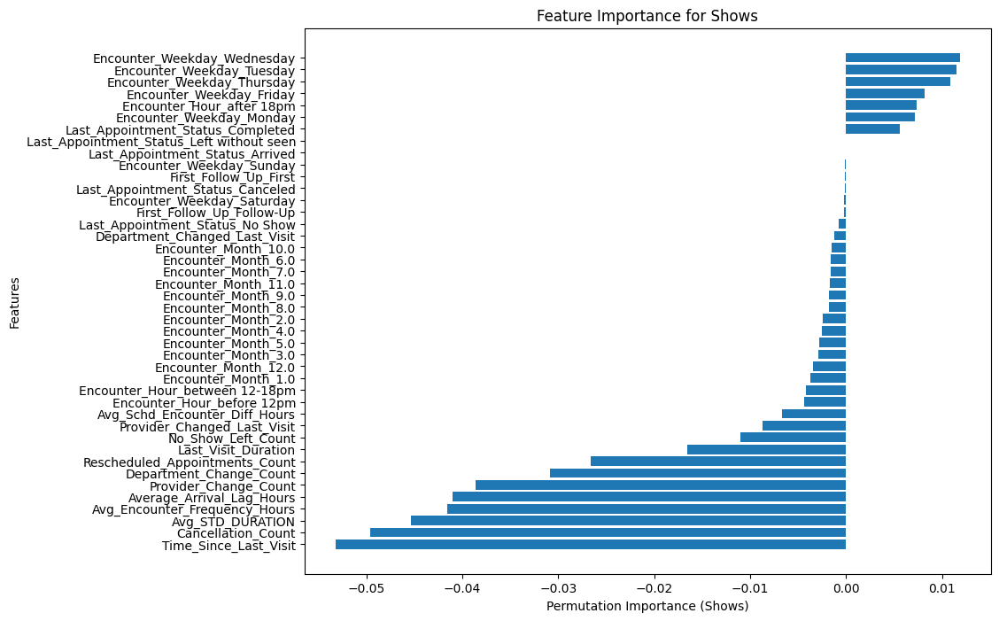

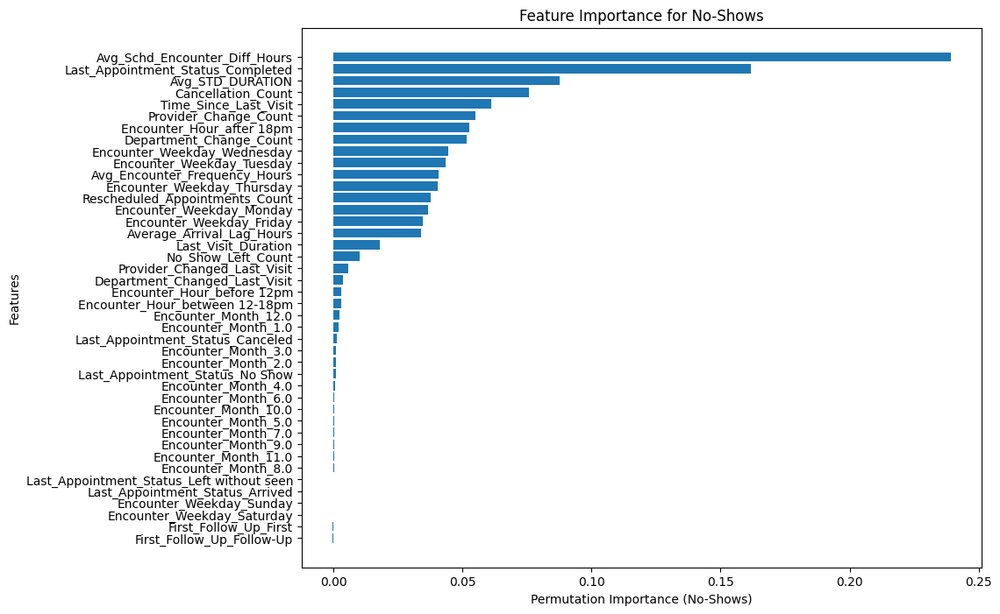

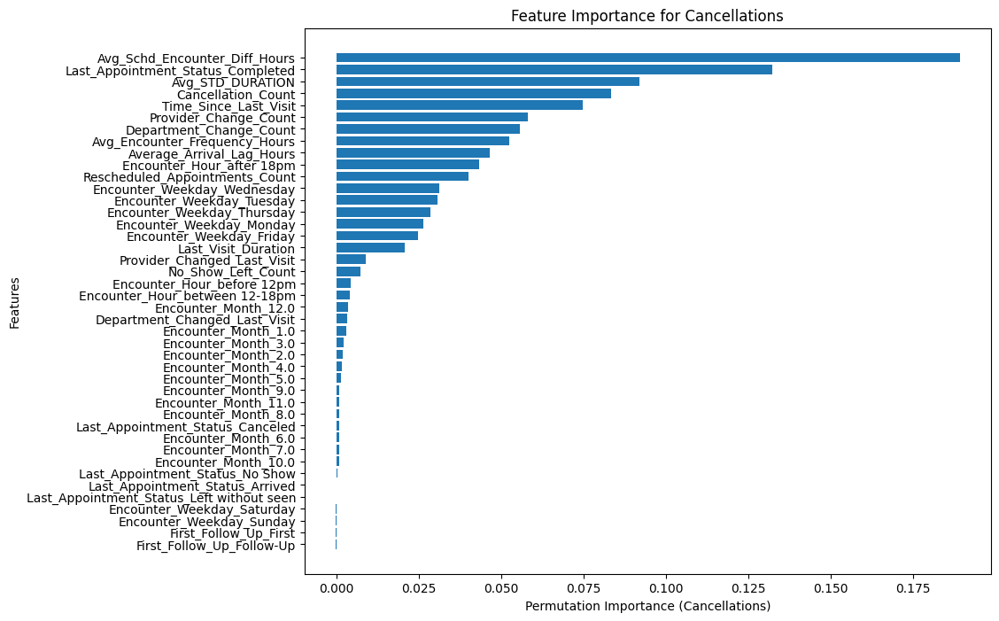

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.inspection import permutation_importance, PartialDependenceDisplay
from joblib import load


# Ensure test data is properly formatted
if isinstance(X_test_primary_benchmark, np.ndarray):
    X_sample = pd.DataFrame(X_test_primary_benchmark, columns=features)
else:
    X_sample = X_test_primary_benchmark

if isinstance(y_test_primary_benchmark, np.ndarray):
    y_sample = pd.Series(y_test_primary_benchmark)
else:
    y_sample = y_test_primary_benchmark

# Define class labels
class_labels = ["Shows", "No-Shows", "Cancellations"]


# Permutation Importance for Each Class
for class_index, class_label in enumerate(class_labels):  # Enumerate over labels
    result = permutation_importance(
        model_primary,
        X_sample,
        y_sample == class_index,  # Treat this class as the target
        scoring="accuracy",
        n_repeats=20,
        random_state=42
    )

    # Plot feature importance for the current class
    sorted_idx = result.importances_mean.argsort()
    plt.figure(figsize=(10, 8))
    plt.barh(np.array(features)[sorted_idx], result.importances_mean[sorted_idx])
    plt.xlabel(f"Permutation Importance ({class_label})")
    plt.ylabel("Features")
    plt.title(f"Feature Importance for {class_label}")
    plt.show()



Interaction Effects (2D PDP)

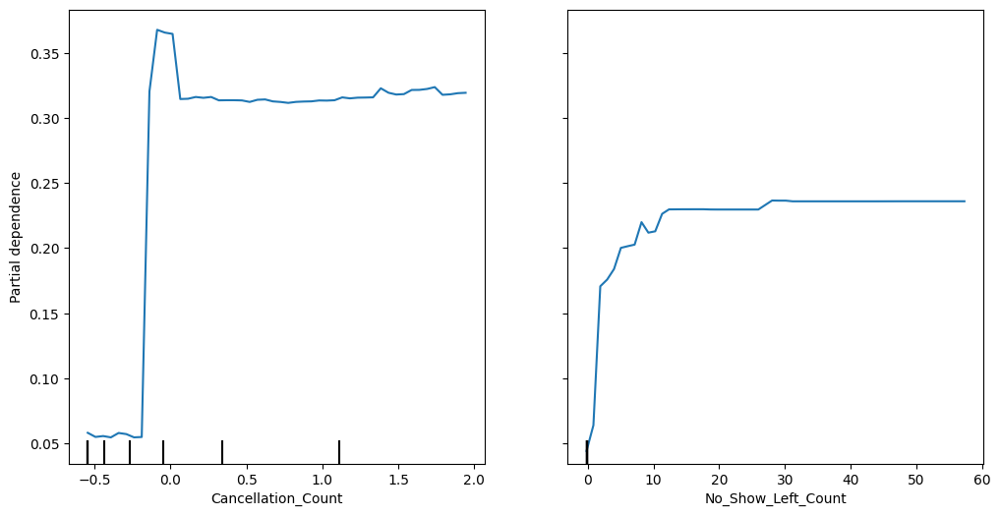

In [44]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.inspection import permutation_importance, PartialDependenceDisplay
from joblib import load

# Ensure test data is properly formatted
if isinstance(X_test_primary_benchmark, np.ndarray):
    X_sample = pd.DataFrame(X_test_primary_benchmark, columns=features)
else:
    X_sample = X_test_primary_benchmark

if isinstance(y_test_primary_benchmark, np.ndarray):
    y_sample = pd.Series(y_test_primary_benchmark)
else:
    y_sample = y_test_primary_benchmark

# Define class labels
class_labels = ["Shows", "No-Shows", "Cancellations"]
# 2. Partial Dependence Plot (PDP) on the Sample
# Choose a feature and class for PDP analysis
fig, ax = plt.subplots(figsize=(12, 6))
PartialDependenceDisplay.from_estimator(
    model_primary,
    X_sample,
    features=['Cancellation_Count', 'No_Show_Left_Count'
    ],  # Replace with top features
    target=1,  # Class of interest
    grid_resolution=50,
    ax=ax
)
plt.show()

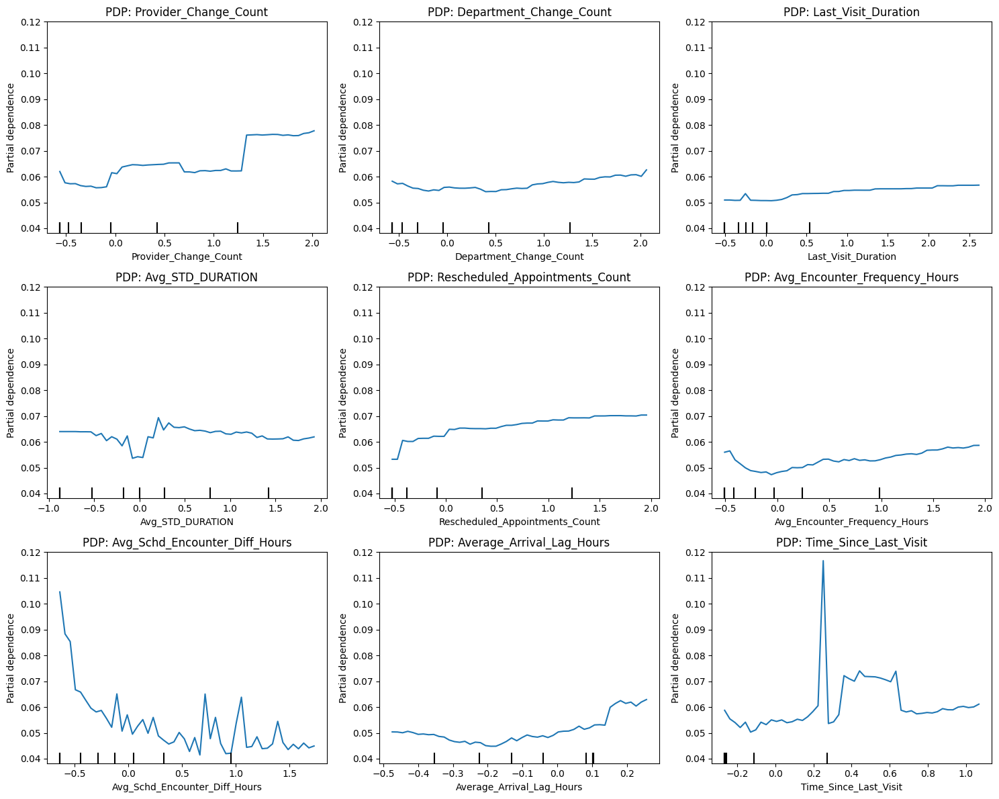

In [42]:
from sklearn.inspection import PartialDependenceDisplay
import matplotlib.pyplot as plt
import math

# Define class labels
class_labels = ["Shows", "No-Shows", "Cancellations"]

# Features to analyze
features = [
    'Provider_Change_Count', 'Department_Change_Count',
    'Last_Visit_Duration', 'Avg_STD_DURATION', 'Rescheduled_Appointments_Count',
    'Avg_Encounter_Frequency_Hours', 'Avg_Schd_Encounter_Diff_Hours', 'Average_Arrival_Lag_Hours',
    'Time_Since_Last_Visit'
]

# Determine the number of rows and columns dynamically
n_features = len(features)
n_cols = 3  # Number of columns
n_rows = math.ceil(n_features / n_cols)  # Dynamically calculate rows

# Create the figure and axes
fig, ax = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15, 12))  # Adjust layout to fit all features
ax = ax.flatten()  # Flatten the axes for easy indexing

# Generate the PDP and set individual titles
pdp_display = PartialDependenceDisplay.from_estimator(
    model_primary,
    X_sample,
    features=features,
    target=1,  # Class of interest ("No-Shows")
    grid_resolution=50,
    ax=ax[:n_features]  # Use only the required number of axes
)

# Set titles for each subplot
for idx, feature_name in enumerate(features):
    ax[idx].set_title(f"PDP: {feature_name}")  # Add a title to each subplot

# Remove unused subplots (if any)
for extra_ax in ax[n_features:]:
    extra_ax.remove()

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


In [27]:
hcdfs = [
    'Cancellation_Count', 'No_Show_Left_Count', 'Provider_Change_Count', 'Department_Change_Count',
    'Last_Visit_Duration', 'Avg_STD_DURATION', 'Rescheduled_Appointments_Count',
    'Avg_Encounter_Frequency_Hours', 'Avg_Schd_Encounter_Diff_Hours', 'Average_Arrival_Lag_Hours',
    'Time_Since_Last_Visit'
]

lcdfs = [
    'First_Follow_Up_First', 'First_Follow_Up_Follow-Up',
    'Encounter_Month_1.0', 'Encounter_Month_2.0', 'Encounter_Month_3.0', 'Encounter_Month_4.0',
    'Encounter_Month_5.0', 'Encounter_Month_6.0', 'Encounter_Month_7.0', 'Encounter_Month_8.0',
    'Encounter_Month_9.0', 'Encounter_Month_10.0', 'Encounter_Month_11.0', 'Encounter_Month_12.0',
    'Encounter_Weekday_Friday', 'Encounter_Weekday_Monday', 'Encounter_Weekday_Saturday',
    'Encounter_Weekday_Sunday', 'Encounter_Weekday_Thursday', 'Encounter_Weekday_Tuesday',
    'Encounter_Weekday_Wednesday', 'Last_Appointment_Status_Arrived',
    'Last_Appointment_Status_Canceled', 'Last_Appointment_Status_Completed',
    'Last_Appointment_Status_Left without seen', 'Last_Appointment_Status_No Show',
    'Encounter_Hour_after 18pm', 'Encounter_Hour_before 12pm',
    'Encounter_Hour_between 12-18pm', 'Department_Changed_Last_Visit',
    'Provider_Changed_Last_Visit'
]

[0 1 2]


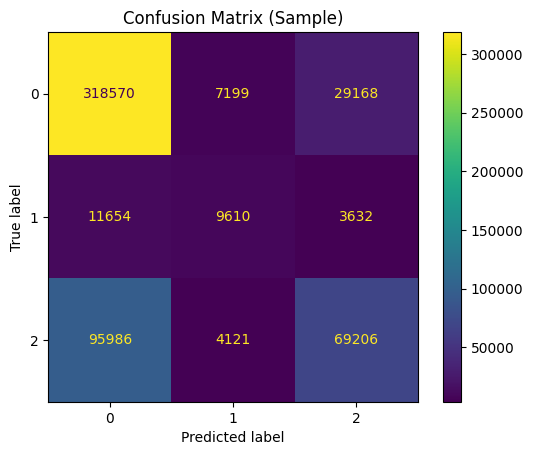

In [45]:
from sklearn.metrics import ConfusionMatrixDisplay

# Predict on the sample
y_pred_sample = model_primary.predict(X_sample)

# Plot confusion matrix
ConfusionMatrixDisplay.from_predictions(y_sample, y_pred_sample, display_labels=[0, 1, 2])
plt.title("Confusion Matrix (Sample)")
plt.show()


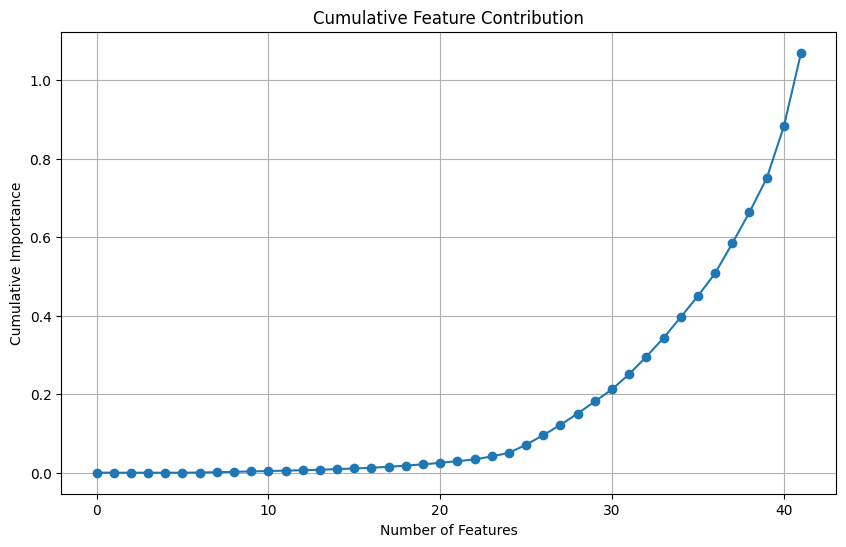

In [ ]:
# Cumulative Contribution
cumulative_importance = np.cumsum(result.importances_mean[sorted_idx])
plt.figure(figsize=(10, 6))
plt.plot(cumulative_importance, marker='o')
plt.xlabel("Number of Features")
plt.ylabel("Cumulative Importance")
plt.title("Cumulative Feature Contribution")
plt.grid()
plt.show()


**SHAP**

In [47]:
pip install shap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 540.1/540.1 kB 8.9 MB/s eta 0:00:00


In [48]:
import shap
import pandas as pd
import numpy as np

Type of shap_values: <class 'numpy.ndarray'>
Number of classes in shap_values: 3
Shape of shap_values[0]: (42, 3)
Shape of shap_values[1]: (42, 3)
Shape of shap_values[2]: (42, 3)

--- SHAP Explanation for Patient 0 ---

Class: Class 0


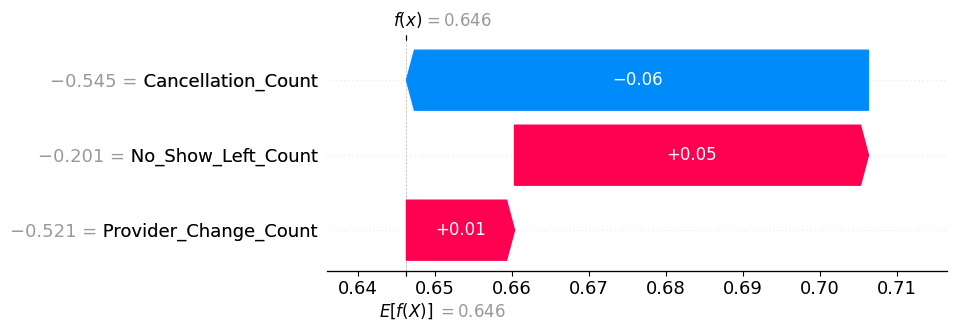


Class: Class 1


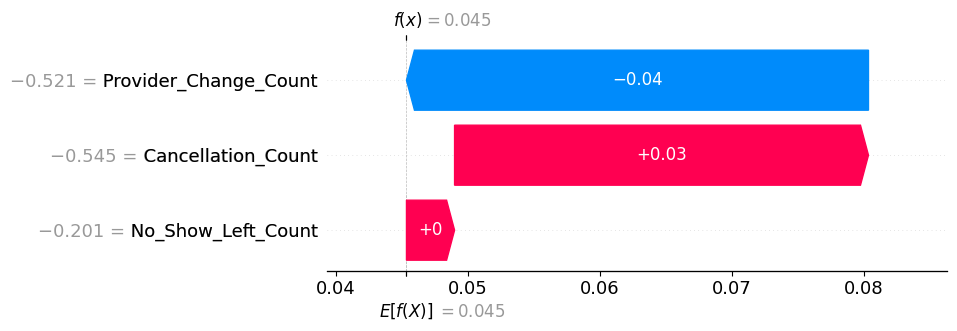


Class: Class 2


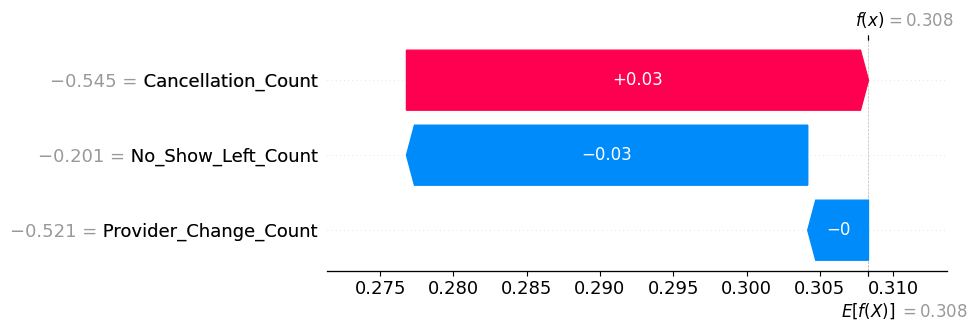


--- SHAP Explanation for Patient 1 ---

Class: Class 0


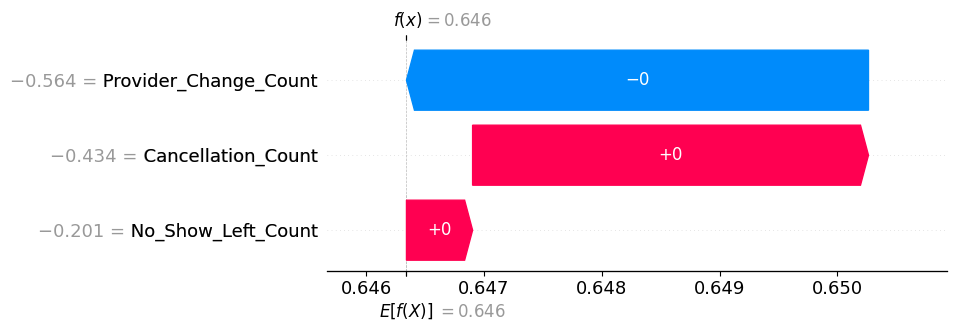


Class: Class 1


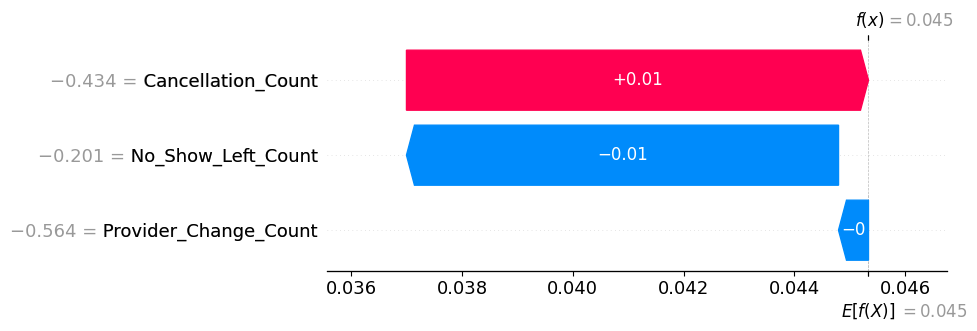


Class: Class 2


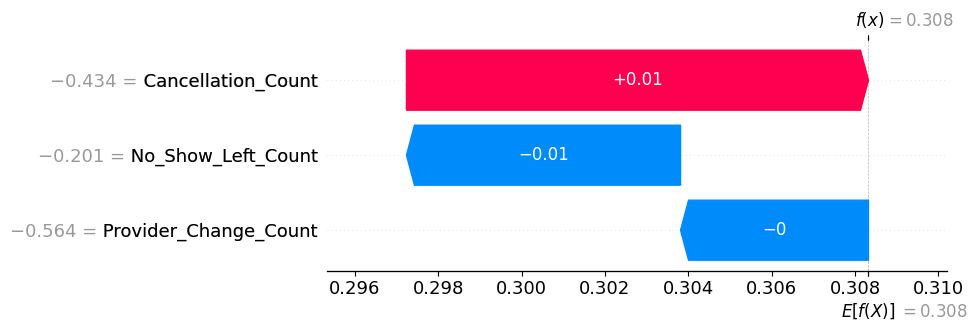


--- SHAP Explanation for Patient 2 ---

Class: Class 0


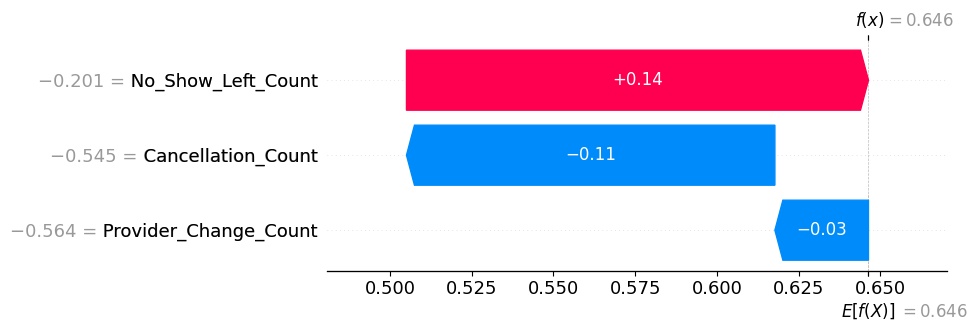


Class: Class 1


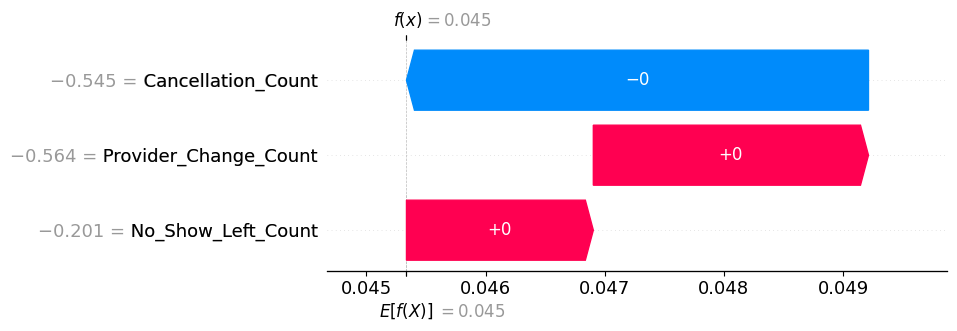


Class: Class 2


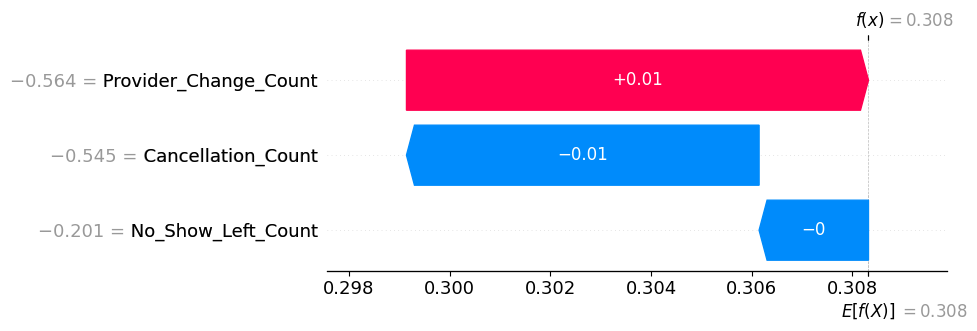

In [ ]:
import shap

# Ensure X_test_primary_benchmark is a DataFrame
if isinstance(X_test_primary_benchmark, np.ndarray):
    X_test_primary_benchmark = pd.DataFrame(X_test_primary_benchmark, columns=features)

# Subsample 5 patients from the test dataset
X_small = X_test_primary_benchmark.sample(n=3, random_state=42)


# Initialize the SHAP TreeExplainer
explainer = shap.TreeExplainer(model_primary)

# Generate SHAP values for the subsample
shap_values = explainer.shap_values(X_small)

# Debug: Confirm SHAP output structure
print(f"Type of shap_values: {type(shap_values)}")
print(f"Number of classes in shap_values: {len(shap_values)}")  # Should be 3
for i, sv in enumerate(shap_values):
    print(f"Shape of shap_values[{i}]: {sv.shape}")  # Should be (5, n_features)

# Reset the index of the subsample
X_small = X_small.reset_index(drop=True)

# Generate SHAP explanations for the subsample
for i, row in X_small.iterrows():
    print(f"\n--- SHAP Explanation for Patient {i} ---")
    for class_idx, class_name in enumerate(["Class 0", "Class 1", "Class 2"]):  # Adjust class names if needed
        print(f"\nClass: {class_name}")
        shap.waterfall_plot(shap.Explanation(
            values=shap_values[class_idx][i],  # SHAP values for this patient and class
            base_values=explainer.expected_value[class_idx],  # Base value for this class
            data=row.to_numpy(),
            feature_names=features
        ))


In [52]:
features = [
    'Cancellation_Count', 'No_Show_Left_Count', 'Provider_Change_Count', 'Department_Change_Count',
    'Last_Visit_Duration', 'Avg_STD_DURATION', 'Rescheduled_Appointments_Count',
    'Avg_Encounter_Frequency_Hours', 'Avg_Schd_Encounter_Diff_Hours', 'Average_Arrival_Lag_Hours',
    'Time_Since_Last_Visit', 'First_Follow_Up_First', 'First_Follow_Up_Follow-Up',
    'Encounter_Month_1.0', 'Encounter_Month_2.0', 'Encounter_Month_3.0', 'Encounter_Month_4.0',
    'Encounter_Month_5.0', 'Encounter_Month_6.0', 'Encounter_Month_7.0', 'Encounter_Month_8.0',
    'Encounter_Month_9.0', 'Encounter_Month_10.0', 'Encounter_Month_11.0', 'Encounter_Month_12.0',
    'Encounter_Weekday_Friday', 'Encounter_Weekday_Monday', 'Encounter_Weekday_Saturday',
    'Encounter_Weekday_Sunday', 'Encounter_Weekday_Thursday', 'Encounter_Weekday_Tuesday',
    'Encounter_Weekday_Wednesday', 'Last_Appointment_Status_Arrived',
    'Last_Appointment_Status_Canceled', 'Last_Appointment_Status_Completed',
    'Last_Appointment_Status_Left without seen', 'Last_Appointment_Status_No Show',
    'Encounter_Hour_after 18pm', 'Encounter_Hour_before 12pm',
    'Encounter_Hour_between 12-18pm', 'Department_Changed_Last_Visit',
    'Provider_Changed_Last_Visit'
]


# Ensure unique_patient_ids is defined
unique_patient_ids = np.unique(test_PT_IDs_primary)  # Extract unique patient IDs

# Initialize SHAP TreeExplainer with default settings (model_output="raw")
explainer = shap.TreeExplainer(model_primary)

# Process data for the first 10 patients
aggregated_patient_explanations = {}
for patient_id in unique_patient_ids[:5]:  # Limit to the first 2 patients
    print(f"\n--- Processing Patient ID: {patient_id} ---")

    # Filter rows belonging to the current patient
    patient_mask = test_PT_IDs_primary == patient_id
    patient_rows = X_test_primary_benchmark[patient_mask]  # Rows for the current patient

    # Run SHAP on all rows for the patient
    shap_values = explainer.shap_values(patient_rows)

    # Aggregate SHAP values across all rows for this patient
    aggregated_explanations = {}
    if isinstance(shap_values, list):  # For multiclass
        for class_idx, class_name in enumerate(["Shows", "No-shows", "Cancellation"]):  # Adjust class names if needed
            # Compute mean SHAP values across appointments for each feature
            shap_mean = np.mean(shap_values[class_idx], axis=0)
            aggregated_explanations[class_name] = dict(zip(features, shap_mean))
    else:
        # If shap_values is a single array (unlikely for tree models), process directly
        shap_mean = np.mean(shap_values, axis=0)
        aggregated_explanations["Combined"] = dict(zip(features, shap_mean))

    # Store aggregated SHAP explanations for this patient
    aggregated_patient_explanations[patient_id] = aggregated_explanations

    # Print aggregated explanations
    print(f"Aggregated SHAP Explanations for Patient {patient_id}:")
    for class_name, explanation in aggregated_explanations.items():
        print(f"\n{class_name}:")
        print(explanation)



--- Processing Patient ID: 0000C0F3-3936-4E57-8113-EA5CB520DAFA ---
Aggregated SHAP Explanations for Patient 0000C0F3-3936-4E57-8113-EA5CB520DAFA:

Combined:
{'Cancellation_Count': array([-0.13173731,  0.00329249,  0.12844483]), 'No_Show_Left_Count': array([ 0.00484984, -0.00340622, -0.00144363]), 'Provider_Change_Count': array([-0.07484764,  0.00438084,  0.0704668 ]), 'Department_Change_Count': array([-0.01473959,  0.00085648,  0.01388311]), 'Last_Visit_Duration': array([-0.0058017 ,  0.00219835,  0.00360335]), 'Avg_STD_DURATION': array([-0.08300518, -0.00442735,  0.08743253]), 'Rescheduled_Appointments_Count': array([ 0.00571482,  0.00087673, -0.00659155]), 'Avg_Encounter_Frequency_Hours': array([-0.13431284,  0.00491096,  0.12940189]), 'Avg_Schd_Encounter_Diff_Hours': array([-0.08852978, -0.02299127,  0.11152105]), 'Average_Arrival_Lag_Hours': array([ 0.01812421, -0.0074418 , -0.01068241]), 'Time_Since_Last_Visit': array([-0.04018614, -0.00211507,  0.0423012 ]), 'First_Follow_Up_Fi


--- Plotting SHAP Values for Patient ID: 0000C0F3-3936-4E57-8113-EA5CB520DAFA ---


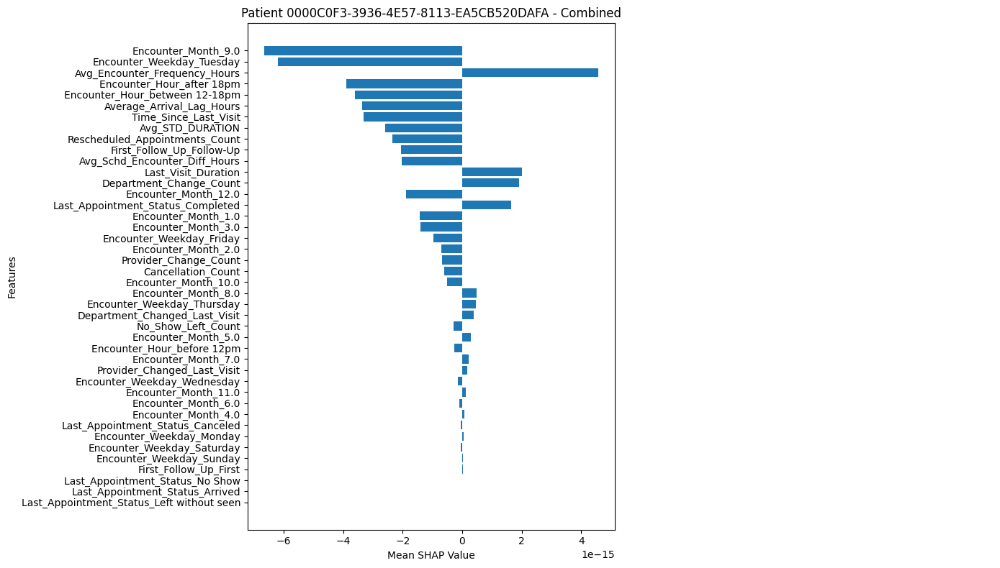


--- Plotting SHAP Values for Patient ID: 0000C974-F261-4B56-22FC-71797176E2C5 ---


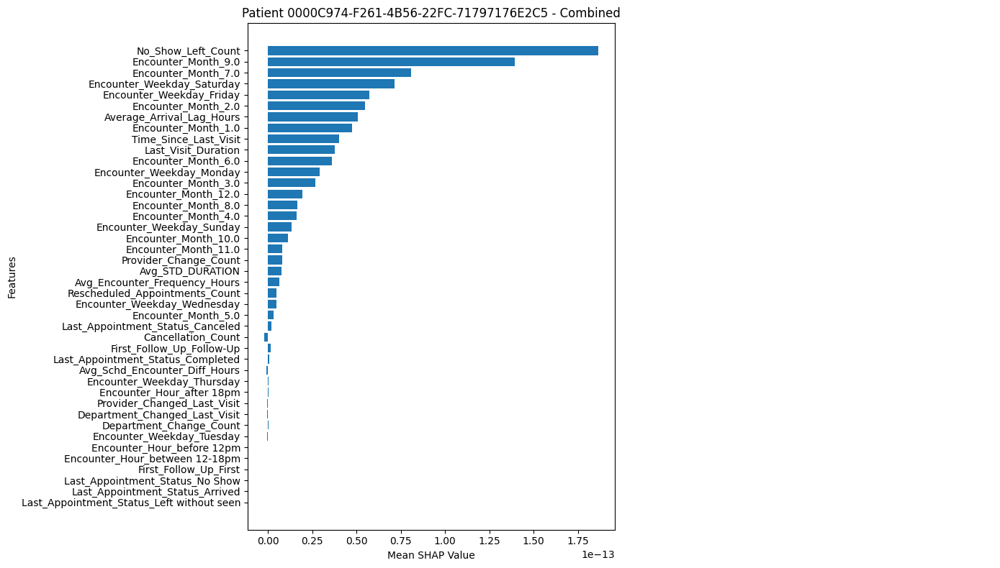


--- Plotting SHAP Values for Patient ID: 00025DDF-0FD6-4B60-1604-C9D2A3940035 ---


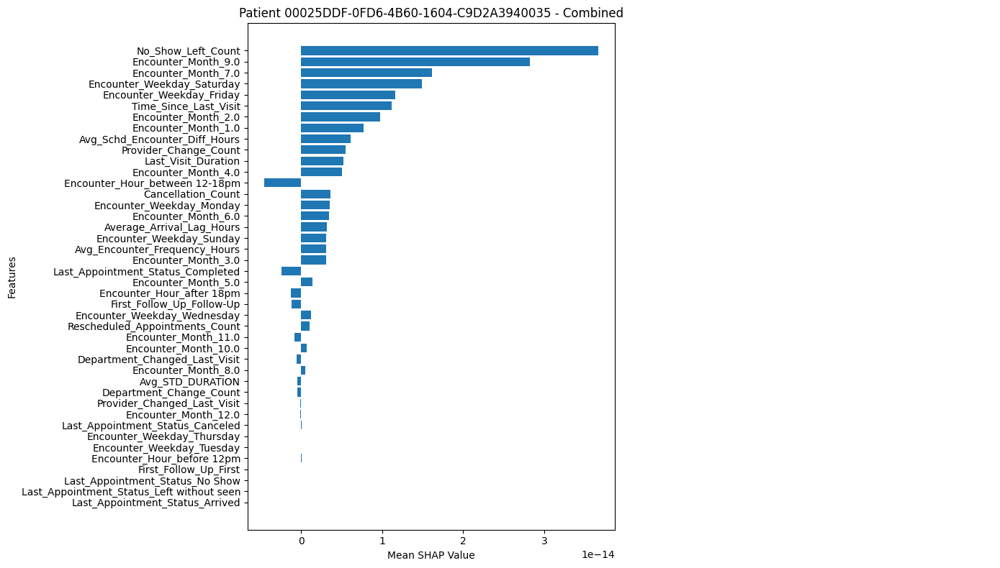


--- Plotting SHAP Values for Patient ID: 0002ADEB-E47B-4225-CC72-E385EC79D571 ---


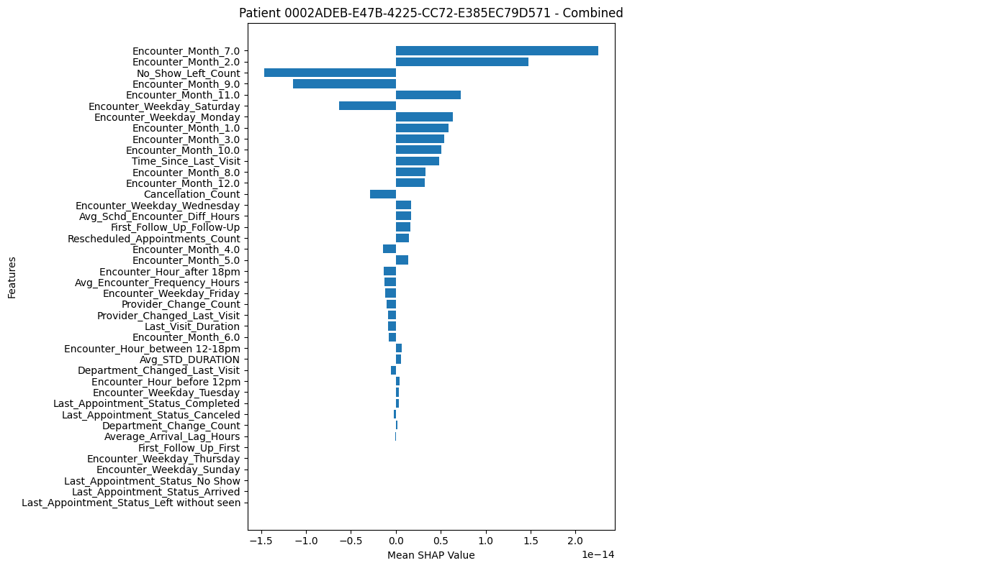


--- Plotting SHAP Values for Patient ID: 00033652-C4DD-4511-8C55-607D6F169F6D ---


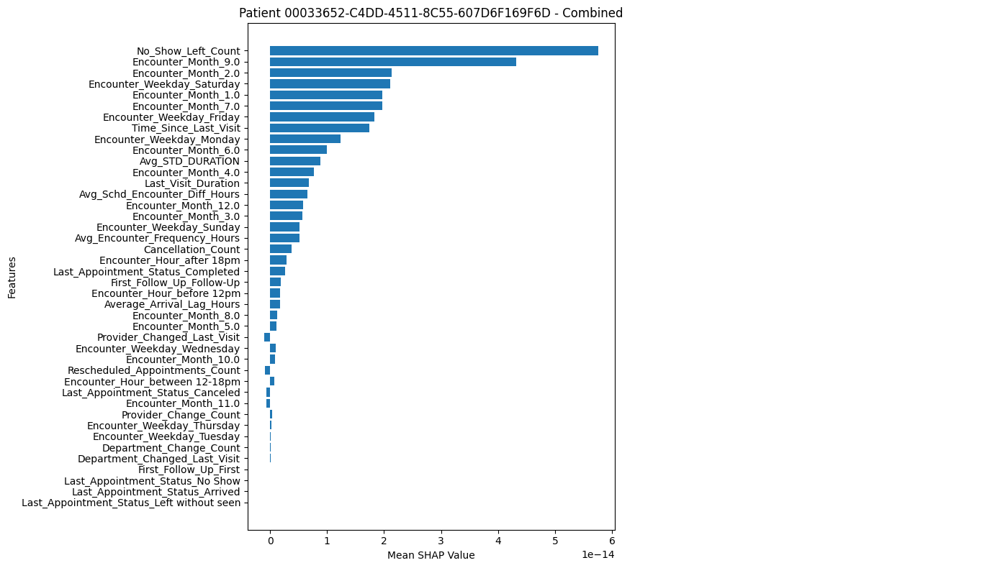

In [54]:
import matplotlib.pyplot as plt
import numpy as np

# Plot aggregated SHAP values for each patient
for patient_id, explanations in aggregated_patient_explanations.items():
    print(f"\n--- Plotting SHAP Values for Patient ID: {patient_id} ---")

    # Get the total number of classes for the patient
    num_classes = len(explanations)
    fig, axes = plt.subplots(nrows=(num_classes + 1) // 2, ncols=2, figsize=(14, 8))  # Adjust layout
    axes = axes.flatten()  # Flatten the axes array for easier indexing

    for idx, (class_name, shap_values) in enumerate(explanations.items()):
        # Aggregate SHAP values for each feature (if they are arrays)
        aggregated_shap = {feature: np.mean(value) if isinstance(value, np.ndarray) else value
                           for feature, value in shap_values.items()}

        # Sort SHAP values by magnitude for better visualization
        sorted_shap = dict(sorted(aggregated_shap.items(), key=lambda item: abs(item[1]), reverse=True))

        # Plot the SHAP values
        ax = axes[idx]
        ax.barh(list(sorted_shap.keys()), list(sorted_shap.values()))
        ax.set_xlabel("Mean SHAP Value")
        ax.set_ylabel("Features")
        ax.set_title(f"Patient {patient_id} - {class_name}")
        ax.invert_yaxis()  # Reverse the order for better readability

    # Remove any unused subplots
    for unused_ax in axes[len(explanations):]:
        unused_ax.axis('off')

    plt.tight_layout()
    plt.show()


**LIME**

In [ ]:
pip install lime

In [ ]:
import lime
import lime.lime_tabular
import pandas as pd
import numpy as np

# Ensure X_test_primary_benchmark is a DataFrame with feature names
if isinstance(X_test_primary_benchmark, np.ndarray):
    X_test_primary_benchmark = pd.DataFrame(X_test_primary_benchmark, columns=features)

# Ensure y_test_primary_benchmark is a Pandas Series
if isinstance(y_test_primary_benchmark, np.ndarray):
    y_test_primary_benchmark = pd.Series(y_test_primary_benchmark, name="Target")

# Subsample the data for faster LIME explanations
X_small = X_test_primary_benchmark.sample(n=10, random_state=42)  # Subsample 10 rows
y_small = y_test_primary_benchmark.loc[X_small.index]

# Ensure feature names are provided
feature_names = features  # List of feature names
class_names = ["Show", "No-show", "Cancel"]  # Replace with your actual class labels

# Create LIME Explainer
explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_primary_benchmark,  # Ensure training data is a DataFrame
    feature_names=feature_names,
    class_names=class_names,
    mode="classification",
    discretize_continuous=True  # Discretize continuous features for better explanations
)

# Generate LIME explanations for each instance in the subsample
# Generate LIME explanations for each instance in the subsample
for i, row in X_small.iterrows():
    print(f"\n--- LIME Explanation for Instance {i} ---")
    # Explicitly specify class labels to explain
    explanation = explainer.explain_instance(
        row.to_numpy(),               # Data point as numpy array
        model_primary.predict_proba,   # Prediction function
        labels=[0, 1, 2],              # Indices of your classes: Show, No-show, Cancel
    )
    # Display explanation
    explanation.show_in_notebook()



--- LIME Explanation for Instance 403490 ---



--- LIME Explanation for Instance 437579 ---



--- LIME Explanation for Instance 195307 ---



--- LIME Explanation for Instance 308078 ---



--- LIME Explanation for Instance 288621 ---



--- LIME Explanation for Instance 222391 ---



--- LIME Explanation for Instance 507960 ---



--- LIME Explanation for Instance 279740 ---



--- LIME Explanation for Instance 508022 ---



--- LIME Explanation for Instance 92870 ---


Aggregation LIME for each patient

In [ ]:
import pandas as pd
import numpy as np

# Ensure unique_patient_ids is defined
unique_patient_ids = np.unique(test_PT_IDs_primary)  # Extract unique patient IDs

# Ensure X_test_primary_benchmark contains only features
X_test_primary_benchmark = X_test_primary_benchmark[:, :len(features)]  # Select only numerical columns

# Initialize a dictionary to store aggregated LIME explanations for each patient
aggregated_patient_explanations = {}

# Process data for each patient ID
for patient_id in unique_patient_ids[:5]:  # Limit to the first 5 patients
    print(f"\n--- Processing Patient ID: {patient_id} ---")

    # Filter rows belonging to the current patient
    patient_mask = test_PT_IDs_primary == patient_id
    patient_rows = X_test_primary_benchmark[patient_mask]  # Rows for the current patient

    patient_explanations = []

    # Iterate over each appointment for the patient
    for row in patient_rows:
        # Convert row to a NumPy array (ensure it's numerical)
        row = np.array(row, dtype=float)  # Force numerical conversion

        # Run LIME on the row (single appointment)
        explanation = explainer.explain_instance(
            row,                            # Single data point (as numpy array)
            model_primary.predict_proba,    # Prediction function
            labels=[1]                # Indices of your classes: Show, No-show, Cancel
        )
        # Extract feature contributions and append to the list
        patient_explanations.append(dict(explanation.as_list()))

    # Aggregate the results across all appointments
    if patient_explanations:
        # Convert list of dictionaries to DataFrame for aggregation
        explanation_df = pd.DataFrame(patient_explanations)
        # Average the contributions across all appointments
        aggregated_explanation = explanation_df.mean().to_dict()
        aggregated_patient_explanations[patient_id] = aggregated_explanation
        print(f"Aggregated Explanation for Patient {patient_id}:")
        print(aggregated_explanation)





--- Processing Patient ID: 0000C0F3-3936-4E57-8113-EA5CB520DAFA ---
Aggregated Explanation for Patient 0000C0F3-3936-4E57-8113-EA5CB520DAFA:
{'Encounter_Weekday_Sunday <= 0.00': 0.16320977126469557, 'No_Show_Left_Count <= 0.00': 0.07774112891709949, 'Encounter_Month_8.0 <= 0.00': -0.05081071091041816, 'Encounter_Month_2.0 <= 0.00': -0.04819945967587239, '2.00 < Cancellation_Count <= 12.00': -0.047870547665919395, 'Last_Appointment_Status_No Show <= 0.00': 0.04493656907201092, 'Encounter_Month_3.0 <= 0.00': -0.04260759562331129, 'Encounter_Month_11.0 <= 0.00': -0.039195705460322174, 'Avg_Encounter_Frequency_Hours > 114.89': 0.039005388348835955, 'Encounter_Weekday_Saturday <= 0.00': -0.03878128796088202}

--- Processing Patient ID: 0000C974-F261-4B56-22FC-71797176E2C5 ---
Aggregated Explanation for Patient 0000C974-F261-4B56-22FC-71797176E2C5:
{'Encounter_Weekday_Sunday <= 0.00': 0.06469821089929334, 'No_Show_Left_Count <= 0.00': 0.09147521441836957, 'Avg_Encounter_Frequency_Hours <= 0

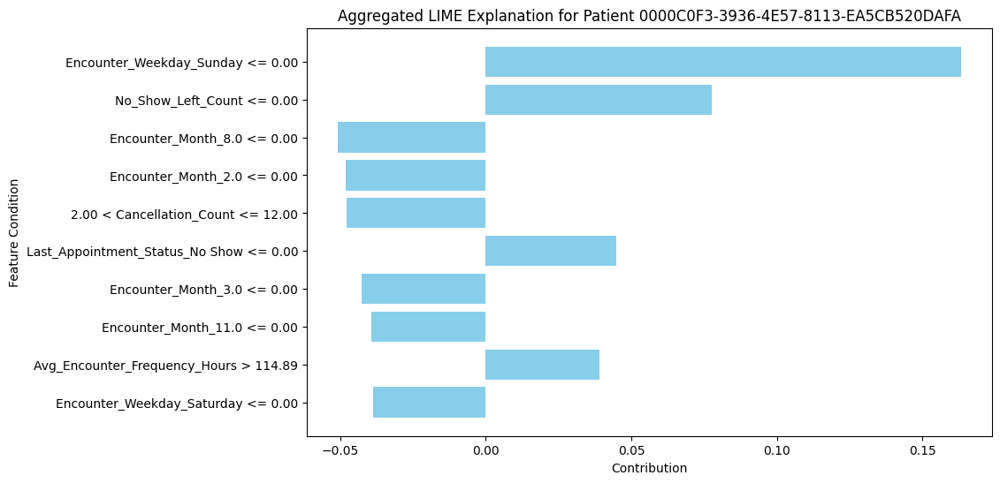

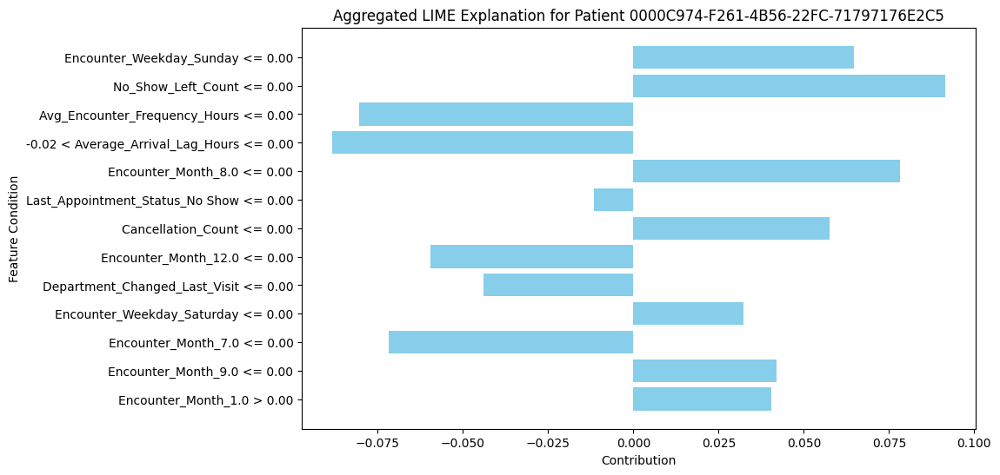

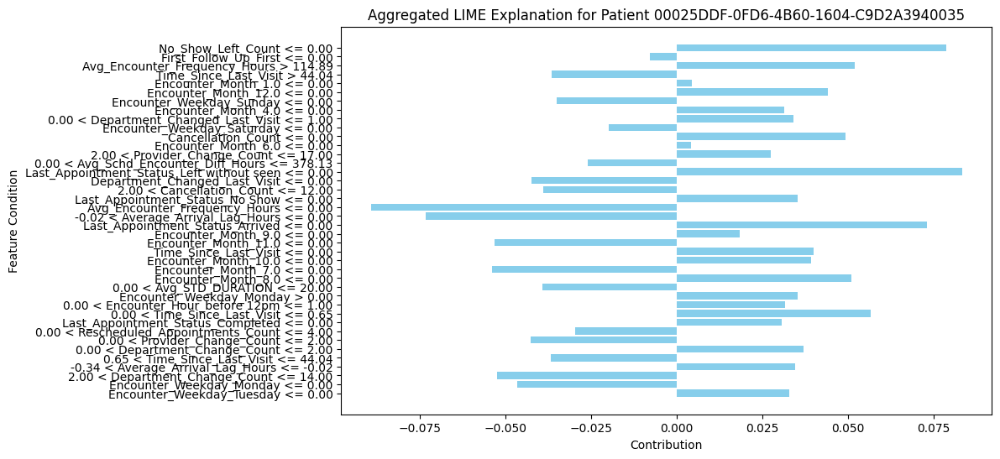

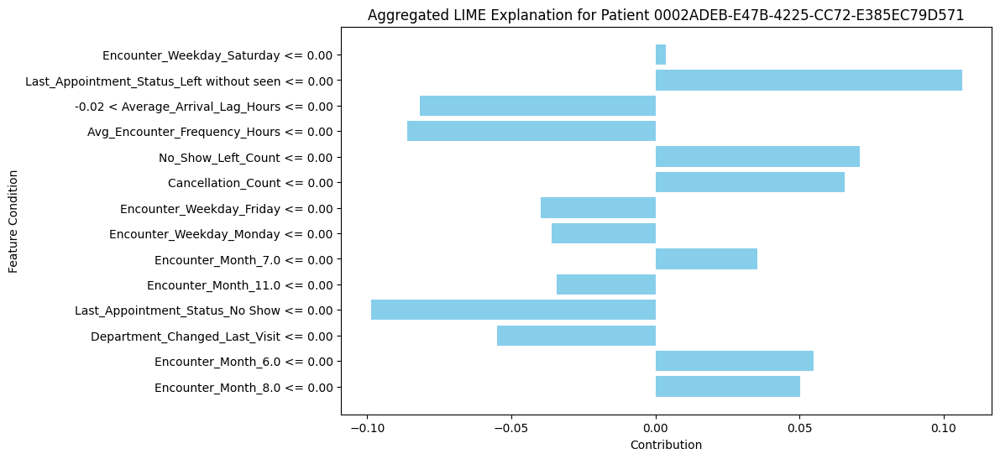

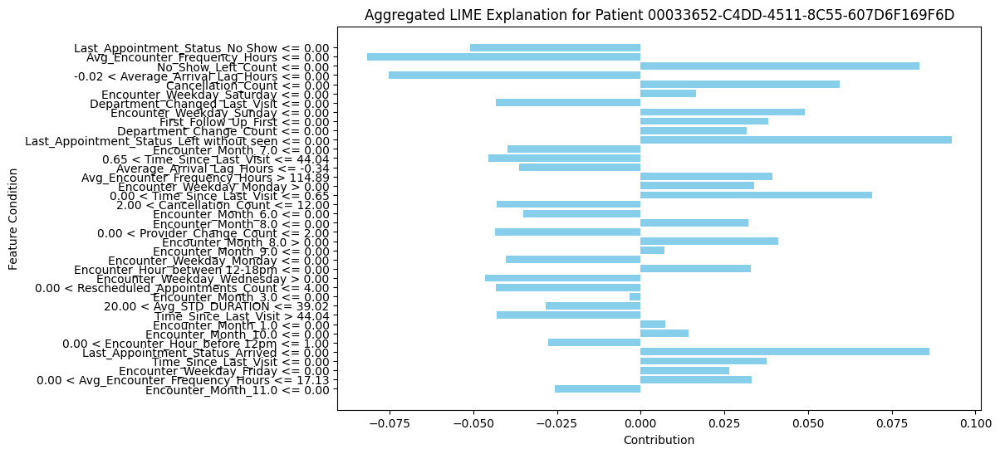

In [ ]:
import matplotlib.pyplot as plt

for patient_id, explanation in aggregated_patient_explanations.items():
    plt.figure(figsize=(10, 6))
    plt.barh(list(explanation.keys()), list(explanation.values()), color='skyblue')
    plt.title(f"Aggregated LIME Explanation for Patient {patient_id}")
    plt.xlabel("Contribution")
    plt.ylabel("Feature Condition")
    plt.gca().invert_yaxis()  # Highest contributions on top
    plt.show()


accuracy tradeoff curve

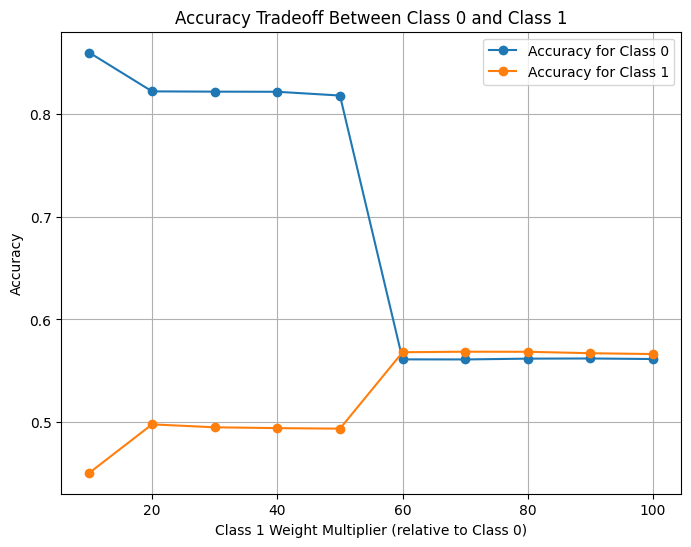

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Function to evaluate tradeoff between classes
def evaluate_tradeoff(X_train, X_test, y_train, y_test):
    class_0_accuracies = []
    class_1_accuracies = []
    weight_combinations = []

    # Define weight pairs
    weight_multipliers = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

    for w1_multiplier in weight_multipliers:
        class_weight = {0: 1, 1: w1_multiplier, 2: 1}  # Adjust weights for class 1
        weight_combinations.append(w1_multiplier)

        # Create and train the model
        model = DecisionTreeClassifier(class_weight=class_weight, random_state=42)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Compute per-class accuracy
        unique_classes = np.unique(y_test)
        class_accuracies = {}
        for cls in unique_classes:
            cls_idx = (y_test == cls)
            class_acc = accuracy_score(y_test[cls_idx], y_pred[cls_idx])
            class_accuracies[cls] = class_acc

        class_0_accuracies.append(class_accuracies.get(0, 0))
        class_1_accuracies.append(class_accuracies.get(1, 0))

    # Plot the tradeoff curve
    plt.figure(figsize=(8, 6))
    plt.plot(weight_multipliers, class_0_accuracies, label="Accuracy for Class 0", marker='o')
    plt.plot(weight_multipliers, class_1_accuracies, label="Accuracy for Class 1", marker='o')
    plt.xlabel('Class 1 Weight Multiplier (relative to Class 0)')
    plt.ylabel('Accuracy')
    plt.title('Accuracy Tradeoff Between Class 0 and Class 1')
    plt.legend()
    plt.grid(True)
    plt.show()

    return weight_combinations, class_0_accuracies, class_1_accuracies

# Run the evaluation with your dataset variables
weight_combinations, acc_0, acc_1 = evaluate_tradeoff(
    X_train_primary_benchmark,
    X_test_primary_benchmark,
    y_train_primary_benchmark,
    y_test_primary_benchmark
)


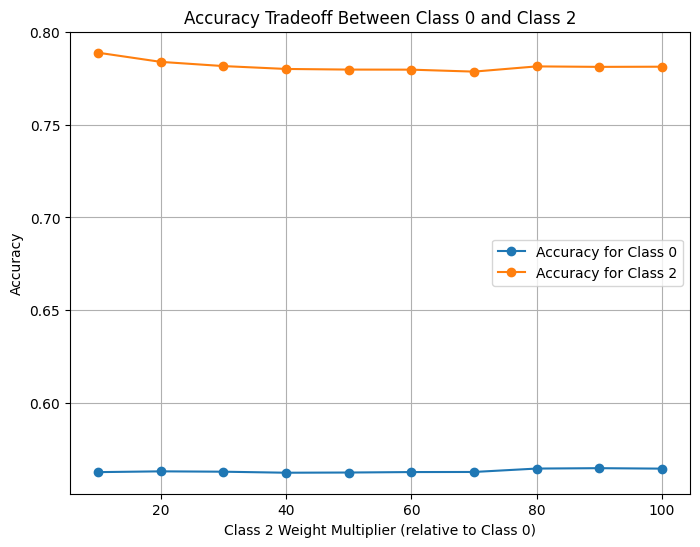

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

# Function to evaluate tradeoff between classes 0 and 2
def evaluate_tradeoff(X_train, X_test, y_train, y_test):
    class_0_accuracies = []
    class_2_accuracies = []
    weight_combinations = []

    # Define weight pairs
    weight_multipliers = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]

    for w2_multiplier in weight_multipliers:
        class_weight = {0: 1, 1: 1, 2: w2_multiplier}  # Adjust weights for class 2
        weight_combinations.append(w2_multiplier)

        # Create and train the model
        model = DecisionTreeClassifier(class_weight=class_weight, random_state=42)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)

        # Compute per-class accuracy
        unique_classes = np.unique(y_test)
        class_accuracies = {}
        for cls in unique_classes:
            cls_idx = (y_test == cls)
            class_acc = accuracy_score(y_test[cls_idx], y_pred[cls_idx])
            class_accuracies[cls] = class_acc

        class_0_accuracies.append(class_accuracies.get(0, 0))
        class_2_accuracies.append(class_accuracies.get(2, 0))

    # Plot the tradeoff curve
    plt.figure(figsize=(8, 6))
    plt.plot(weight_multipliers, class_0_accuracies, label="Accuracy for Class 0", marker='o')
    plt.plot(weight_multipliers, class_2_accuracies, label="Accuracy for Class 2", marker='o')
    plt.xlabel('Class 2 Weight Multiplier (relative to Class 0)')
    plt.ylabel('Accuracy')
    plt.title('Accuracy Tradeoff Between Class 0 and Class 2')
    plt.legend()
    plt.grid(True)
    plt.show()

    return weight_combinations, class_0_accuracies, class_2_accuracies

# Run the evaluation with your dataset variables
weight_combinations, acc_0, acc_2 = evaluate_tradeoff(
    X_train_primary_benchmark,
    X_test_primary_benchmark,
    y_train_primary_benchmark,
    y_test_primary_benchmark
)


feature importance

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_feature_importance(model, feature_names, model_name):
    """
    Visualize feature importance as a bar chart.

    Parameters:
    - model: Trained model with feature_importances_ attribute.
    - feature_names: List of feature names corresponding to the input data.
    - model_name: Name of the model (used for the chart title).
    """
    if hasattr(model, "feature_importances_"):
        # Get feature importances and sort them
        importances = model.feature_importances_
        sorted_indices = importances.argsort()[::-1]  # Indices sorted by descending importance

        # Sort feature names and importances
        sorted_features = np.array(feature_names)[sorted_indices]
        sorted_importances = importances[sorted_indices]

        # Plot feature importance
        plt.figure(figsize=(10, 8))
        plt.barh(sorted_features, sorted_importances, color='skyblue')
        plt.xlabel("Feature Importance", fontsize=12)
        plt.ylabel("Features", fontsize=12)
        plt.title(f"Feature Importance for {model_name}", fontsize=14)
        plt.gca().invert_yaxis()  # Invert y-axis to show highest importance at the top
        plt.tight_layout()
        plt.show()
    else:
        print(f"Feature importance is not available for the model: {model_name}")



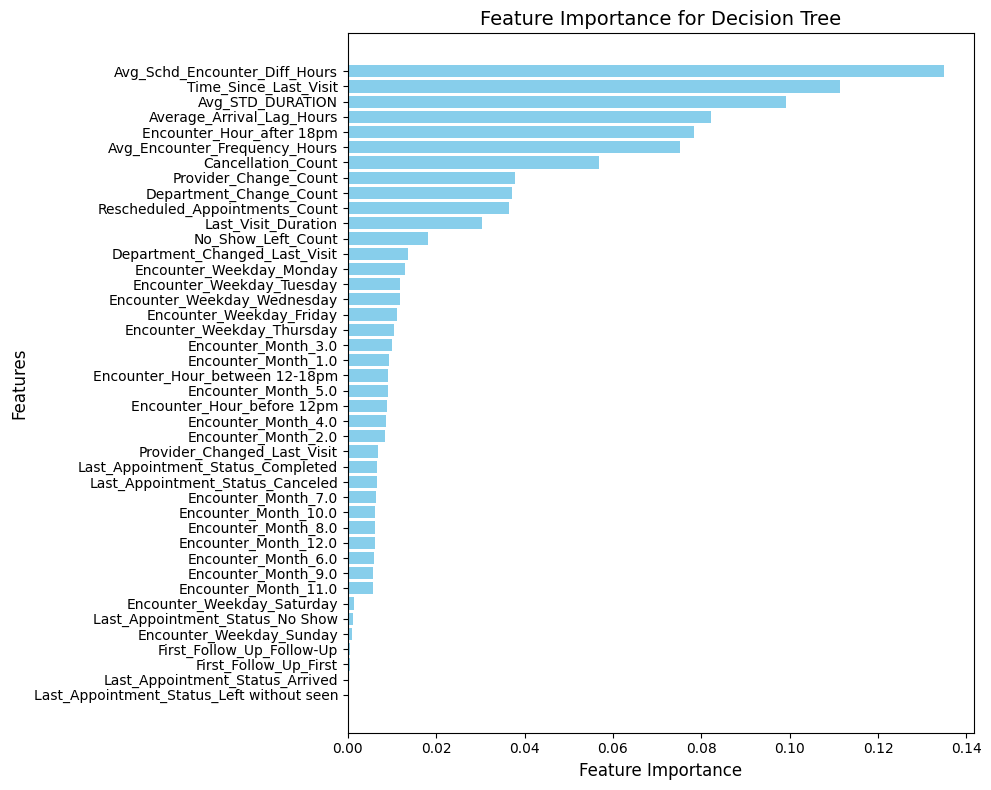

In [ ]:
primary_model_name = "Decision Tree"  # Replace with your model name
dt_primary = primary_models[primary_model_name]  # Retrieve the model

# Visualize feature importance
visualize_feature_importance(dt_primary, features, primary_model_name)

In [ ]:
from sklearn.utils.class_weight import compute_class_weight

# Calculate class weights
class_weights = compute_class_weight(
    'balanced', classes=np.unique(y_train), y=y_train
)
class_weights_dict = {i: w for i, w in enumerate(class_weights)}

print("Class Weights:", class_weights_dict)

Class Weights: {0: 0.5157218262985069, 1: 7.352526510282776, 2: 1.081124898855965}


DT unbalanced CR

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")

[########################################] 1/1 models completed
Evaluating Decision Tree Model...

Primary Head Label Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.7235
Precision: 0.7235
Recall:    0.7235
F1 Score:  0.7235

Classification Report:
              precision    recall  f1-score   support

           0       0.75      0.90      0.82    354937
           1       0.46      0.39      0.42     24896
           2       0.68      0.41      0.51    169313

    accuracy                           0.72    549146
   macro avg       0.63      0.56      0.58    549146
weighted avg       0.71      0.72      0.70    549146

AUC Score (Multiclass): 0.8291
--------------------------------------------------

Cancellation Reasons Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.7329
Precision: 0.7329
Recall:    0.7329
F1 Score:  0.7329

Classification Report:
              precision    recall  f1-score   support

           0       0.4

evaluation with the manual class weights inputs

In [ ]:
def evaluate_model(name, model, X_train, X_test, y_train, y_test, class_weights=None):
    """
    Evaluate a machine learning model with an option to handle custom class imbalance.
    If the model supports 'class_weight', custom weights are applied if provided.

    Parameters:
        name (str): Name of the model.
        model (object): Machine learning model to evaluate.
        X_train (array): Training data features.
        X_test (array): Testing data features.
        y_train (array): Training data labels.
        y_test (array): Testing data labels.
        class_weights (dict): Optional dictionary of class weights.
    """
    # Check if the model supports class_weight
    if hasattr(model, "class_weight"):
        if class_weights is not None:
            model.set_params(class_weight=class_weights)
        else:
            model.set_params(class_weight="balanced")

    # Fit the model on training data
    model.fit(X_train, y_train)

    # Make predictions on test data
    y_pred = model.predict(X_test)

    # Calculate evaluation metrics
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred, average='micro', zero_division=0)
    rec = recall_score(y_test, y_pred, average='micro', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='micro', zero_division=0)

    # Print basic metrics
    print(f"{name} Performance Metrics:")
    print(f"Accuracy:  {acc:.4f}")
    print(f"Precision: {prec:.4f}")
    print(f"Recall:    {rec:.4f}")
    print(f"F1 Score:  {f1:.4f}")

    # Generate and print the classification report
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred, zero_division=0))

    # Attempt to compute AUC score
    if hasattr(model, "predict_proba"):
        y_scores = model.predict_proba(X_test)
        if len(np.unique(y_test)) == 2:
            # Binary classification
            auc = roc_auc_score(y_test, y_scores[:, 1])
            print(f"AUC Score (Binary): {auc:.4f}")
        else:
            # Multiclass classification
            auc = roc_auc_score(y_test, y_scores, multi_class='ovr', average='micro')
            print(f"AUC Score (Multiclass): {auc:.4f}")
    elif hasattr(model, "decision_function"):
        y_scores = model.decision_function(X_test)
        if len(np.unique(y_test)) == 2:
            # Binary classification
            auc = roc_auc_score(y_test, y_scores)
            print(f"AUC Score (Binary): {auc:.4f}")
        else:
            # Multiclass classification
            auc = roc_auc_score(y_test, y_scores, multi_class='ovr', average='micro')
            print(f"AUC Score (Multiclass): {auc:.4f}")
    else:
        print("Model does not support probability predictions or decision function, skipping AUC calculation.")

    print("-" * 50)


In [ ]:
class_weights_intense = {0: 0.4, 1: 100.0, 2: 4.0}

from sklearn.tree import DecisionTreeClassifier

# Example with Decision Tree
dt_model = DecisionTreeClassifier()

evaluate_model(
    name="Decision Tree",
    model=dt_model,
    X_train=X_train,
    X_test=X_test,
    y_train=y_train,
    y_test=y_test,
    class_weights=class_weights_intense)  # Pass custom weights

Decision Tree Performance Metrics:
Accuracy:  0.5136
Precision: 0.5136
Recall:    0.5136
F1 Score:  0.5136

Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.56      0.67    354937
           1       0.07      0.56      0.12     24896
           2       0.67      0.41      0.51    169313

    accuracy                           0.51    549146
   macro avg       0.52      0.51      0.43    549146
weighted avg       0.75      0.51      0.60    549146

AUC Score (Multiclass): 0.7564
--------------------------------------------------


play with treshhold

In [ ]:
# Set a custom threshold for class 1
threshold_class_1 = .9

# Adjust predictions
y_pred_custom = np.where(y_probs[:, 1] >= threshold_class_1, 1, np.argmax(y_probs, axis=1))


In [ ]:

# Evaluate
print(classification_report(y_test, y_pred_custom, zero_division=0))

              precision    recall  f1-score   support

           0       0.75      0.86      0.80    354937
           1       0.27      0.45      0.34     24896
           2       0.67      0.40      0.50    169313

    accuracy                           0.70    549146
   macro avg       0.56      0.57      0.55    549146
weighted avg       0.71      0.70      0.69    549146



no shows prob distribution

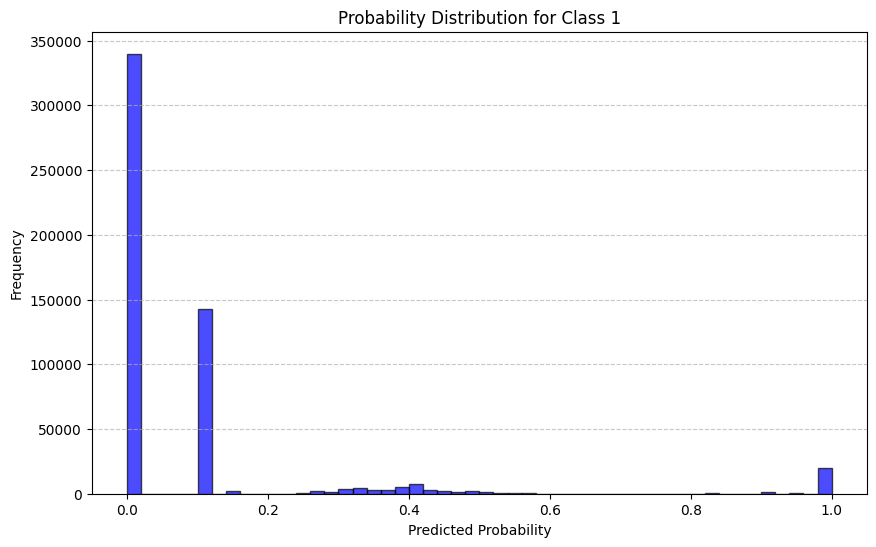

In [ ]:
import matplotlib.pyplot as plt

# Ensure you have predicted probabilities from the model
# Replace 'model' and 'X_test' with your actual variables
y_probs = model.predict_proba(X_test)

# Extract probabilities for class 1
class_1_probs = y_probs[:, 1]

# Plot the histogram
plt.figure(figsize=(10, 6))
plt.hist(class_1_probs, bins=50, color='blue', alpha=0.7, edgecolor='black')
plt.title("Probability Distribution for Class 1")
plt.xlabel("Predicted Probability")
plt.ylabel("Frequency")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


In [ ]:
# Find the optimal threshold
precision, recall, thresholds = precision_recall_curve((y_test == 1).astype(int), y_probs[:, 1])
optimal_idx = np.where(recall >= 0.90)[0][0]
optimal_threshold = thresholds[optimal_idx]
print(f"Optimal Threshold for Recall >= 90%: {optimal_threshold}")

Optimal Threshold for Recall >= 90%: 0.0


RF unbalanced CR

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")

[########################################] 1/1 models completed
Evaluating Random Forest Model...

Primary Head Label Benchmark for Random Forest:
Random Forest Performance Metrics:
Accuracy:  0.7362
Precision: 0.7362
Recall:    0.7362
F1 Score:  0.7362

Classification Report:
              precision    recall  f1-score   support

           0       0.73      0.96      0.83    354937
           1       0.66      0.28      0.40     24896
           2       0.79      0.34      0.48    169313

    accuracy                           0.74    549146
   macro avg       0.73      0.53      0.57    549146
weighted avg       0.74      0.74      0.70    549146

AUC Score (Multiclass): 0.8951
--------------------------------------------------

Cancellation Reasons Benchmark for Random Forest:
Random Forest Performance Metrics:
Accuracy:  0.7539
Precision: 0.7539
Recall:    0.7539
F1 Score:  0.7539

Classification Report:
              precision    recall  f1-score   support

           0       0.7

evaluate model balanced

In [ ]:
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score,
    f1_score, roc_auc_score, classification_report
)
import numpy as np

def evaluate_model(name, model, X_train, X_test, y_train, y_test):
    """
    Evaluate a machine learning model, including handling class imbalance for certain models.
    If the model supports 'class_weight', it is set to 'balanced'.
    """
    # Check if the model supports class_weight
    if hasattr(model, "class_weight"):
        model.set_params(class_weight="balanced")

    # Fit the model on training data
    model.fit(X_train, y_train)

    # Make predictions on test data
    y_pred = model.predict(X_test)

    # Calculate evaluation metrics
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred, average='micro', zero_division=0)
    rec = recall_score(y_test, y_pred, average='micro', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='micro', zero_division=0)

    # Print basic metrics
    print(f"{name} Performance Metrics:")
    print(f"Accuracy:  {acc:.4f}")
    print(f"Precision: {prec:.4f}")
    print(f"Recall:    {rec:.4f}")
    print(f"F1 Score:  {f1:.4f}")

    # Generate and print the classification report
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred, zero_division=0))

    # Attempt to compute AUC score
    if hasattr(model, "predict_proba"):
        y_scores = model.predict_proba(X_test)
        if len(np.unique(y_test)) == 2:
            # Binary classification
            auc = roc_auc_score(y_test, y_scores[:, 1])
            print(f"AUC Score (Binary): {auc:.4f}")
        else:
            # Multiclass classification
            auc = roc_auc_score(y_test, y_scores, multi_class='ovr', average='micro')
            print(f"AUC Score (Multiclass): {auc:.4f}")
    elif hasattr(model, "decision_function"):
        y_scores = model.decision_function(X_test)
        if len(np.unique(y_test)) == 2:
            # Binary classification
            auc = roc_auc_score(y_test, y_scores)
            print(f"AUC Score (Binary): {auc:.4f}")
        else:
            # Multiclass classification
            auc = roc_auc_score(y_test, y_scores, multi_class='ovr', average='micro')
            print(f"AUC Score (Multiclass): {auc:.4f}")
    else:
        print("Model does not support probability predictions or decision function, skipping AUC calculation.")

    print("-" * 50)



RF micro balanced CR

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")


[########################################] 1/1 models completed
Evaluating Random Forest Model...

Primary Head Label Benchmark for Random Forest:
Random Forest Performance Metrics:
Accuracy:  0.6283
Precision: 0.6283
Recall:    0.6283
F1 Score:  0.6283

Classification Report:
              precision    recall  f1-score   support

           0       0.79      0.63      0.70    354937
           1       0.24      0.38      0.30     24896
           2       0.49      0.66      0.56    169313

    accuracy                           0.63    549146
   macro avg       0.51      0.56      0.52    549146
weighted avg       0.68      0.63      0.64    549146

AUC Score (Multiclass): 0.8673
--------------------------------------------------

Cancellation Reasons Benchmark for Random Forest:
Random Forest Performance Metrics:
Accuracy:  0.5623
Precision: 0.5623
Recall:    0.5623
F1 Score:  0.5623

Classification Report:
              precision    recall  f1-score   support

           0       0.1

xgboost micro balanced CR

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    # Primary Head Label
    print(f"\nPrimary Head Label Benchmark for {name}:")
    evaluate_model(name, model, X_train_primary_benchmark, X_test_primary_benchmark, y_train_primary_benchmark, y_test_primary_benchmark)

    # Cancellation Reasons
    print(f"Cancellation Reasons Benchmark for {name}:")
    evaluate_model(name, model, X_train_cancellation_benchmark, X_test_cancellation_benchmark, y_train_cancellation_benchmark, y_test_cancellation_benchmark)

    # No-Show Reasons
    print(f"No-Show Reasons Benchmark for {name}:")
    evaluate_model(name, model, X_train_noshow_benchmark, X_test_noshow_benchmark, y_train_noshow_benchmark, y_test_noshow_benchmark)

    print(f"Completed {idx}/{total_models}: {name} model.\n{'=' * 50}")

[########################################] 1/1 models completed
Primary Head Label Benchmark for XGBoost:


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:41:17] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Performance Metrics:
Accuracy:  0.6501
Precision: 0.6501
Recall:    0.6501
F1 Score:  0.6501

Classification Report:
              precision    recall  f1-score   support

           0       0.65      0.99      0.79    354937
           1       0.63      0.01      0.02     24896
           2       0.64      0.02      0.04    169313

    accuracy                           0.65    549146
   macro avg       0.64      0.34      0.28    549146
weighted avg       0.64      0.65      0.52    549146

AUC Score (Multiclass): 0.8288
--------------------------------------------------
Cancellation Reasons Benchmark for XGBoost:


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:41:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Performance Metrics:
Accuracy:  0.6934
Precision: 0.6934
Recall:    0.6934
F1 Score:  0.6934

Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.01      0.01     44230
           1       0.83      0.01      0.01     50943
           2       0.83      0.03      0.05      3880
           3       0.75      0.01      0.01     69890
           4       0.80      0.01      0.03       297
           5       0.78      0.10      0.17        73
           6       0.69      1.00      0.82    379833

    accuracy                           0.69    549146
   macro avg       0.79      0.17      0.16    549146
weighted avg       0.72      0.69      0.57    549146

AUC Score (Multiclass): 0.9196
--------------------------------------------------
No-Show Reasons Benchmark for XGBoost:


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [02:43:06] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Performance Metrics:
Accuracy:  0.9548
Precision: 0.9548
Recall:    0.9548
F1 Score:  0.9548

Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.01      0.02      2696
           1       0.93      0.00      0.00      7034
           2       0.75      0.01      0.01       553
           3       0.71      0.00      0.00      7226
           4       1.00      0.09      0.17        75
           5       0.58      0.01      0.01      7312
           6       0.95      1.00      0.98    524250

    accuracy                           0.95    549146
   macro avg       0.83      0.16      0.17    549146
weighted avg       0.95      0.95      0.93    549146

AUC Score (Multiclass): 0.9912
--------------------------------------------------
Completed 1/1: XGBoost model.


XGBoost manual classweights

In [ ]:
from xgboost import XGBClassifier
from sklearn.utils.class_weight import compute_class_weight
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report, roc_auc_score

# Function to compute manual class weights
def compute_manual_class_weights(y):
    """
    Compute manual class weights as the inverse of class frequencies.
    """
    class_weights = compute_class_weight('balanced', classes=np.unique(y), y=y)
    weights = np.array([class_weights[label] for label in y])
    return weights

# Function to train and evaluate XGBoost with manual class weights
def train_xgboost_with_weights(name, X_train, X_test, y_train, y_test):
    """
    Train XGBoost with manual class weights and evaluate on the test set.
    """
    # Compute class weights for training data
    sample_weights = compute_manual_class_weights(y_train)

    # Initialize XGBoost model
    model = XGBClassifier(
        use_label_encoder=False,
        eval_metric="mlogloss",
        max_depth=5,
        learning_rate=0.1,
        n_estimators=100,
        random_state=42
    )

    # Train the model with sample weights
    model.fit(X_train, y_train, sample_weight=sample_weights)

    # Make predictions on the test data
    y_pred = model.predict(X_test)

    # Evaluate the model
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred, average='micro', zero_division=0)
    rec = recall_score(y_test, y_pred, average='micro', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='micro', zero_division=0)

    # Print metrics
    print(f"{name} Performance Metrics:")
    print(f"Accuracy:  {acc:.4f}")
    print(f"Precision: {prec:.4f}")
    print(f"Recall:    {rec:.4f}")
    print(f"F1 Score:  {f1:.4f}")

    # Classification report
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred, zero_division=0))

    # AUC Score
    if hasattr(model, "predict_proba"):
        y_proba = model.predict_proba(X_test)
        if len(np.unique(y_test)) == 2:
            auc = roc_auc_score(y_test, y_proba[:, 1])
            print(f"AUC Score (Binary): {auc:.4f}")
        else:
            y_test_binarized = np.eye(len(np.unique(y_train)))[y_test]
            auc = roc_auc_score(y_test_binarized, y_proba, multi_class='ovr', average='micro')
            print(f"AUC Score (Multiclass): {auc:.4f}")
    else:
        print("AUC not available for this model.")
    print("-" * 50)

# Example: Run XGBoost with manual class weights for each benchmark
print("\nPrimary Head Label Benchmark for XGBoost:")
train_xgboost_with_weights(
    "XGBoost - Primary Head",
    X_train_primary_benchmark,
    X_test_primary_benchmark,
    y_train_primary_benchmark,
    y_test_primary_benchmark
)

print("\nCancellation Reasons Benchmark for XGBoost:")
train_xgboost_with_weights(
    "XGBoost - Cancellation Reasons",
    X_train_cancellation_benchmark,
    X_test_cancellation_benchmark,
    y_train_cancellation_benchmark,
    y_test_cancellation_benchmark
)

print("\nNo-Show Reasons Benchmark for XGBoost:")
train_xgboost_with_weights(
    "XGBoost - No-Show Reasons",
    X_train_noshow_benchmark,
    X_test_noshow_benchmark,
    y_train_noshow_benchmark,
    y_test_noshow_benchmark
)



Primary Head Label Benchmark for XGBoost:


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [17:42:13] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost - Primary Head Performance Metrics:
Accuracy:  0.3326
Precision: 0.3326
Recall:    0.3326
F1 Score:  0.3326

Classification Report:
              precision    recall  f1-score   support

           0       0.73      0.22      0.34    354937
           1       0.08      0.63      0.14     24896
           2       0.36      0.52      0.43    169313

    accuracy                           0.33    549146
   macro avg       0.39      0.46      0.30    549146
weighted avg       0.59      0.33      0.36    549146

AUC Score (Multiclass): 0.5966
--------------------------------------------------

Cancellation Reasons Benchmark for XGBoost:


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [17:42:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost - Cancellation Reasons Performance Metrics:
Accuracy:  0.2170
Precision: 0.2170
Recall:    0.2170
F1 Score:  0.2170

Classification Report:
              precision    recall  f1-score   support

           0       0.11      0.46      0.17     44230
           1       0.15      0.19      0.17     50943
           2       0.03      0.57      0.05      3880
           3       0.19      0.13      0.15     69890
           4       0.00      0.35      0.00       297
           5       0.01      0.89      0.01        73
           6       0.78      0.20      0.32    379833

    accuracy                           0.22    549146
   macro avg       0.18      0.40      0.13    549146
weighted avg       0.59      0.22      0.27    549146

AUC Score (Multiclass): 0.6775
--------------------------------------------------

No-Show Reasons Benchmark for XGBoost:


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [17:44:07] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost - No-Show Reasons Performance Metrics:
Accuracy:  0.3454
Precision: 0.3454
Recall:    0.3454
F1 Score:  0.3454

Classification Report:
              precision    recall  f1-score   support

           0       0.02      0.36      0.05      2696
           1       0.03      0.25      0.05      7034
           2       0.01      0.91      0.01       553
           3       0.03      0.40      0.05      7226
           4       0.00      0.47      0.00        75
           5       0.05      0.23      0.08      7312
           6       0.99      0.35      0.51    524250

    accuracy                           0.35    549146
   macro avg       0.16      0.42      0.11    549146
weighted avg       0.94      0.35      0.49    549146

AUC Score (Multiclass): 0.7477
--------------------------------------------------


SMOTE on data

In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, classification_report
import numpy as np

# Function to apply SMOTE and return oversampled data
def apply_smote(X_train, y_train, head_name):
    """
    Apply SMOTE to the training data for a specific head.
    """
    smote = SMOTE(random_state=42)
    X_resampled, y_resampled = smote.fit_resample(X_train, y_train)
    print(f"\nSMOTE applied for {head_name}. Class distribution after resampling:")
    unique, counts = np.unique(y_resampled, return_counts=True)
    print(dict(zip(unique, counts)))
    return X_resampled, y_resampled

# Step 1: Apply SMOTE to each head's training data
X_train_primary_resampled, y_train_primary_resampled = apply_smote(
    X_train_primary_benchmark, y_train_primary_benchmark, "Primary Head"
)

X_train_cancellation_resampled, y_train_cancellation_resampled = apply_smote(
    X_train_cancellation_benchmark, y_train_cancellation_benchmark, "Cancellation Reasons"
)

X_train_noshow_resampled, y_train_noshow_resampled = apply_smote(
    X_train_noshow_benchmark, y_train_noshow_benchmark, "No-Show Reasons"
)


SMOTE applied for Primary Head. Class distribution after resampling:
{0: 1419746, 1: 1419746, 2: 1419746}

SMOTE applied for Cancellation Reasons. Class distribution after resampling:
{0: 1519330, 1: 1519330, 2: 1519330, 3: 1519330, 4: 1519330, 5: 1519330, 6: 1519330}

SMOTE applied for No-Show Reasons. Class distribution after resampling:
{0: 2096998, 1: 2096998, 2: 2096998, 3: 2096998, 4: 2096998, 5: 2096998, 6: 2096998}


In [ ]:
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score,
    f1_score, roc_auc_score, classification_report
)
import numpy as np
# Step 2: Function to train and evaluate any model on resampled data
def train_and_evaluate(name, model, X_train, X_test, y_train, y_test):
    """
    Train the model on oversampled data and evaluate it on test data.
    """
    # Train the model
    model.fit(X_train, y_train)

    # Make predictions on the test data
    y_pred = model.predict(X_test)

        # Calculate basic evaluation metrics
    acc = accuracy_score(y_test, y_pred)
    prec = precision_score(y_test, y_pred, average='micro', zero_division=0)
    rec = recall_score(y_test, y_pred, average='micro', zero_division=0)
    f1 = f1_score(y_test, y_pred, average='micro', zero_division=0)

    # Print basic metrics
    print(f"{name} Performance Metrics:")
    print(f"Accuracy:  {acc:.4f}")
    print(f"Precision: {prec:.4f}")
    print(f"Recall:    {rec:.4f}")
    print(f"F1 Score:  {f1:.4f}")


    # Generate and print the classification report
    print("\nClassification Report:")
    print(classification_report(y_test, y_pred, zero_division=0))

# Attempt to compute AUC score
    # Attempt to compute AUC score
    if hasattr(model, "predict_proba"):
        y_scores = model.predict_proba(X_test)
        if len(np.unique(y_test)) == 2:
            # Binary classification
            auc = roc_auc_score(y_test, y_scores[:, 1])
            print(f"AUC Score (Binary): {auc:.4f}")
        else:
            # Multiclass classification
            auc = roc_auc_score(y_test, y_scores, multi_class='ovr', average='micro')
            print(f"AUC Score (Multiclass): {auc:.4f}")
    elif hasattr(model, "decision_function"):
        y_scores = model.decision_function(X_test)
        if len(np.unique(y_test)) == 2:
            # Binary classification
            auc = roc_auc_score(y_test, y_scores)
            print(f"AUC Score (Binary): {auc:.4f}")
        else:
            # Multiclass classification
            auc = roc_auc_score(y_test, y_scores, multi_class='ovr', average='micro')
            print(f"AUC Score (Multiclass): {auc:.4f}")
    else:
        print("Model does not support probability predictions or decision function, skipping AUC calculation.")

    print("-" * 50)


MLP on SMOTE

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    # Primary Head Label
    print(f"\nPrimary Head Label Benchmark for {name}:")
    train_and_evaluate(name, model, X_train_primary_resampled, X_test_primary_benchmark, y_train_primary_resampled, y_test_primary_benchmark)

    # Cancellation Reasons
    print(f"Cancellation Reasons Benchmark for {name}:")
    train_and_evaluate(name, model, X_train_cancellation_resampled, X_test_cancellation_benchmark, y_train_cancellation_resampled, y_test_cancellation_benchmark)

    # No-Show Reasons
    print(f"No-Show Reasons Benchmark for {name}:")
    train_and_evaluate(name, model, X_train_noshow_resampled, X_test_noshow_benchmark, y_train_noshow_resampled, y_test_noshow_benchmark)

    print(f"Completed {idx}/{total_models}: {name} model.\n{'=' * 50}")

[########################################] 1/1 models completed
Primary Head Label Benchmark for MLP:


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


MLP Performance Metrics:
Accuracy:  0.3709
Precision: 0.3709
Recall:    0.3709
F1 Score:  0.3709

Classification Report:
              precision    recall  f1-score   support

           0       0.71      0.28      0.40    354937
           1       0.08      0.50      0.14     24896
           2       0.36      0.54      0.43    169313

    accuracy                           0.37    549146
   macro avg       0.38      0.44      0.32    549146
weighted avg       0.57      0.37      0.40    549146

AUC Score (Multiclass): 0.6347
--------------------------------------------------
Cancellation Reasons Benchmark for MLP:


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


MLP Performance Metrics:
Accuracy:  0.2146
Precision: 0.2146
Recall:    0.2146
F1 Score:  0.2146

Classification Report:
              precision    recall  f1-score   support

           0       0.10      0.52      0.17     44230
           1       0.15      0.19      0.17     50943
           2       0.02      0.62      0.04      3880
           3       0.16      0.08      0.11     69890
           4       0.01      0.20      0.01       297
           5       0.01      0.66      0.02        73
           6       0.78      0.20      0.32    379833

    accuracy                           0.21    549146
   macro avg       0.18      0.35      0.12    549146
weighted avg       0.58      0.21      0.27    549146

AUC Score (Multiclass): 0.7031
--------------------------------------------------
No-Show Reasons Benchmark for MLP:


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


MLP Performance Metrics:
Accuracy:  0.3436
Precision: 0.3436
Recall:    0.3436
F1 Score:  0.3436

Classification Report:
              precision    recall  f1-score   support

           0       0.01      0.46      0.03      2696
           1       0.02      0.29      0.05      7034
           2       0.01      0.71      0.01       553
           3       0.03      0.31      0.05      7226
           4       0.00      0.41      0.01        75
           5       0.04      0.21      0.07      7312
           6       0.98      0.35      0.51    524250

    accuracy                           0.34    549146
   macro avg       0.16      0.39      0.10    549146
weighted avg       0.94      0.34      0.49    549146

AUC Score (Multiclass): 0.7683
--------------------------------------------------
Completed 1/1: MLP model.


DT on Smote data

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    # Primary Head Label
    print(f"\nPrimary Head Label Benchmark for {name}:")
    train_and_evaluate(name, model, X_train_primary_resampled, X_test_primary_benchmark, y_train_primary_resampled, y_test_primary_benchmark)

    # Cancellation Reasons
    print(f"Cancellation Reasons Benchmark for {name}:")
    train_and_evaluate(name, model, X_train_cancellation_resampled, X_test_cancellation_benchmark, y_train_cancellation_resampled, y_test_cancellation_benchmark)

    # No-Show Reasons
    print(f"No-Show Reasons Benchmark for {name}:")
    train_and_evaluate(name, model, X_train_noshow_resampled, X_test_noshow_benchmark, y_train_noshow_resampled, y_test_noshow_benchmark)

    print(f"Completed {idx}/{total_models}: {name} model.\n{'=' * 50}")

[########################################] 1/1 models completed
Primary Head Label Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.5932
Precision: 0.5932
Recall:    0.5932
F1 Score:  0.5932

Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.55      0.66    354937
           1       0.21      0.43      0.28     24896
           2       0.46      0.71      0.56    169313

    accuracy                           0.59    549146
   macro avg       0.50      0.56      0.50    549146
weighted avg       0.68      0.59      0.61    549146

AUC Score (Multiclass): 0.7873
--------------------------------------------------
Cancellation Reasons Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.4929
Precision: 0.4929
Recall:    0.4929
F1 Score:  0.4929

Classification Report:
              precision    recall  f1-score   support

           0       0.15      0.61      0.24     44230
    

XGboost on Smote data

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    # Primary Head Label
    print(f"\nPrimary Head Label Benchmark for {name}:")
    train_and_evaluate(name, model, X_train_primary_resampled, X_test_primary_benchmark, y_train_primary_resampled, y_test_primary_benchmark)

    # Cancellation Reasons
    print(f"Cancellation Reasons Benchmark for {name}:")
    train_and_evaluate(name, model, X_train_cancellation_resampled, X_test_cancellation_benchmark, y_train_cancellation_resampled, y_test_cancellation_benchmark)

    # No-Show Reasons
    print(f"No-Show Reasons Benchmark for {name}:")
    train_and_evaluate(name, model, X_train_noshow_resampled, X_test_noshow_benchmark, y_train_noshow_resampled, y_test_noshow_benchmark)

    print(f"Completed {idx}/{total_models}: {name} model.\n{'=' * 50}")

[########################################] 1/1 models completed
Primary Head Label Benchmark for XGBoost:


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:46:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Performance Metrics:
Accuracy:  0.5257
Precision: 0.5257
Recall:    0.5257
F1 Score:  0.5257

Classification Report:
              precision    recall  f1-score   support

           0       0.68      0.60      0.63    354937
           1       0.10      0.15      0.12     24896
           2       0.37      0.43      0.40    169313

    accuracy                           0.53    549146
   macro avg       0.38      0.39      0.38    549146
weighted avg       0.55      0.53      0.54    549146

AUC Score (Multiclass): 0.7785
--------------------------------------------------
Cancellation Reasons Benchmark for XGBoost:


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:47:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Performance Metrics:
Accuracy:  0.4520
Precision: 0.4520
Recall:    0.4520
F1 Score:  0.4520

Classification Report:
              precision    recall  f1-score   support

           0       0.11      0.37      0.17     44230
           1       0.17      0.09      0.12     50943
           2       0.04      0.46      0.07      3880
           3       0.29      0.05      0.08     69890
           4       0.01      0.08      0.01       297
           5       0.01      0.71      0.02        73
           6       0.73      0.58      0.65    379833

    accuracy                           0.45    549146
   macro avg       0.19      0.34      0.16    549146
weighted avg       0.57      0.45      0.48    549146

AUC Score (Multiclass): 0.8248
--------------------------------------------------
No-Show Reasons Benchmark for XGBoost:


/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [15:57:12] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBoost Performance Metrics:
Accuracy:  0.8098
Precision: 0.8098
Recall:    0.8098
F1 Score:  0.8098

Classification Report:
              precision    recall  f1-score   support

           0       0.06      0.24      0.10      2696
           1       0.04      0.08      0.05      7034
           2       0.01      0.56      0.02       553
           3       0.07      0.08      0.07      7226
           4       0.04      0.24      0.07        75
           5       0.05      0.14      0.07      7312
           6       0.96      0.84      0.90    524250

    accuracy                           0.81    549146
   macro avg       0.18      0.31      0.18    549146
weighted avg       0.92      0.81      0.86    549146

AUC Score (Multiclass): 0.9580
--------------------------------------------------
Completed 1/1: XGBoost model.



MLP results balanced

In [ ]:
from sklearn.metrics import classification_report
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Function to train MLP with progress tracking
def train_mlp_with_progress(model, X_train, X_test, y_train, y_test, max_iter=100):
    """
    Train MLPClassifier with progress tracking, displaying metrics after every iteration.
    """
    model.warm_start = True  # Allows incremental training
    model.max_iter = 1  # Perform one iteration at a time

    print(f"\nTraining MLPClassifier for {max_iter} iterations...")
    for iteration in range(1, max_iter + 1):
        model.fit(X_train, y_train)  # Incremental training for one iteration
        y_pred = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred, average='weighted', zero_division=0)
        recall = recall_score(y_test, y_pred, average='weighted', zero_division=0)
        f1 = f1_score(y_test, y_pred, average='weighted', zero_division=0)

        # Print progress and metrics
        print(f"Iteration {iteration}/{max_iter}: Accuracy: {accuracy:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, F1 Score: {f1:.4f}")

    print("\nFinal Classification Report:")
    print(classification_report(y_test, y_pred, zero_division=0))

# Define models
models = {
    'MLP': MLPClassifier(hidden_layer_sizes=(128, 64), random_state=42)
}

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
scaler = StandardScaler()

for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Scale features for MLP and other models sensitive to feature scaling
    if name == "MLP":
        X_train_primary_scaled = scaler.fit_transform(X_train_primary_benchmark)
        X_test_primary_scaled = scaler.transform(X_test_primary_benchmark)

        # Track progress for MLP
        print(f"\nPrimary Head Label Benchmark for {name}:")
        train_mlp_with_progress(model, X_train_primary_scaled, X_test_primary_scaled, y_train_primary_benchmark, y_test_primary_benchmark)

    else:
        # Primary Head Label Benchmark
        print(f"\nPrimary Head Label Benchmark for {name}:")
        evaluate_model(name, model,
                       X_train_primary_benchmark, X_test_primary_benchmark,
                       y_train_primary_benchmark, y_test_primary_benchmark)

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")


[########################################] 1/1 models completed
Evaluating MLP Model...

Primary Head Label Benchmark for MLP:

Training MLPClassifier for 100 iterations...


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 1/100: Accuracy: 0.6471, Precision: 0.6104, Recall: 0.6471, F1 Score: 0.5133


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 2/100: Accuracy: 0.6473, Precision: 0.6085, Recall: 0.6473, F1 Score: 0.5151


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1) reached and the optimization hasn't converged yet.
  warnings.warn(


Iteration 3/100: Accuracy: 0.6473, Precision: 0.6083, Recall: 0.6473, F1 Score: 0.5154


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


Iteration 4/100: Accuracy: 0.6472, Precision: 0.6155, Recall: 0.6472, F1 Score: 0.5129


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


Iteration 5/100: Accuracy: 0.6474, Precision: 0.6052, Recall: 0.6474, F1 Score: 0.5173


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


Iteration 6/100: Accuracy: 0.6472, Precision: 0.6157, Recall: 0.6472, F1 Score: 0.5129


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


KeyboardInterrupt: 

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")


[########################################] 1/1 models completed
Evaluating MLP Model...

Primary Head Label Benchmark for MLP:


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


MLP Performance Metrics:
Accuracy:  0.6463
Precision: 0.6463
Recall:    0.6463
F1 Score:  0.6463

Classification Report:
              precision    recall  f1-score   support

           0       0.65      1.00      0.79    354937
           1       0.00      0.00      0.00     24896
           2       0.41      0.00      0.00    169313

    accuracy                           0.65    549146
   macro avg       0.35      0.33      0.26    549146
weighted avg       0.54      0.65      0.51    549146

AUC Score (Multiclass): 0.8183
--------------------------------------------------

Cancellation Reasons Benchmark for MLP:


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


MLP Performance Metrics:
Accuracy:  0.6917
Precision: 0.6917
Recall:    0.6917
F1 Score:  0.6917

Classification Report:
              precision    recall  f1-score   support

           0       0.00      0.00      0.00     44230
           1       0.00      0.00      0.00     50943
           2       0.00      0.00      0.00      3880
           3       0.00      0.00      0.00     69890
           4       0.00      0.00      0.00       297
           5       0.00      0.00      0.00        73
           6       0.69      1.00      0.82    379833

    accuracy                           0.69    549146
   macro avg       0.10      0.14      0.12    549146
weighted avg       0.48      0.69      0.57    549146

AUC Score (Multiclass): 0.9122
--------------------------------------------------

No-Show Reasons Benchmark for MLP:


/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:697: UserWarning: Training interrupted by user.
  warnings.warn("Training interrupted by user.")


MLP Performance Metrics:
Accuracy:  0.9547
Precision: 0.9547
Recall:    0.9547
F1 Score:  0.9547

Classification Report:
              precision    recall  f1-score   support

           0       0.50      0.00      0.00      2696
           1       0.00      0.00      0.00      7034
           2       0.00      0.00      0.00       553
           3       0.00      0.00      0.00      7226
           4       0.00      0.00      0.00        75
           5       0.57      0.00      0.00      7312
           6       0.95      1.00      0.98    524250

    accuracy                           0.95    549146
   macro avg       0.29      0.14      0.14    549146
weighted avg       0.92      0.95      0.93    549146

AUC Score (Multiclass): 0.9891
--------------------------------------------------

Completed 1/1: MLP Model.


DT balanced micro with classification report

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    print(f"\n{'=' * 50}")
    print(f"Evaluating {name} Model...")

    # Primary Head Label Benchmark
    print(f"\nPrimary Head Label Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_primary_benchmark, X_test_primary_benchmark,
                   y_train_primary_benchmark, y_test_primary_benchmark)

    # Cancellation Reasons Benchmark
    print(f"\nCancellation Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_cancellation_benchmark, X_test_cancellation_benchmark,
                   y_train_cancellation_benchmark, y_test_cancellation_benchmark)

    # No-Show Reasons Benchmark
    print(f"\nNo-Show Reasons Benchmark for {name}:")
    evaluate_model(name, model,
                   X_train_noshow_benchmark, X_test_noshow_benchmark,
                   y_train_noshow_benchmark, y_test_noshow_benchmark)

    print(f"\nCompleted {idx}/{total_models}: {name} Model.")
    print(f"{'=' * 50}")


[########################################] 1/1 models completed
Evaluating Decision Tree Model...

Primary Head Label Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.6104
Precision: 0.6104
Recall:    0.6104
F1 Score:  0.6104

Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.56      0.67    354937
           1       0.23      0.47      0.31     24896
           2       0.48      0.73      0.58    169313

    accuracy                           0.61    549146
   macro avg       0.52      0.59      0.52    549146
weighted avg       0.70      0.61      0.63    549146

AUC Score (Multiclass): 0.8077
--------------------------------------------------

Cancellation Reasons Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.5426
Precision: 0.5426
Recall:    0.5426
F1 Score:  0.5426

Classification Report:
              precision    recall  f1-score   support

           0       0.1

DT balanced macro

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    # Primary Head Label
    print(f"\nPrimary Head Label Benchmark for {name}:")
    evaluate_model(name, model, X_train_primary_benchmark, X_test_primary_benchmark, y_train_primary_benchmark, y_test_primary_benchmark)

    # Cancellation Reasons
    print(f"Cancellation Reasons Benchmark for {name}:")
    evaluate_model(name, model, X_train_cancellation_benchmark, X_test_cancellation_benchmark, y_train_cancellation_benchmark, y_test_cancellation_benchmark)

    # No-Show Reasons
    print(f"No-Show Reasons Benchmark for {name}:")
    evaluate_model(name, model, X_train_noshow_benchmark, X_test_noshow_benchmark, y_train_noshow_benchmark, y_test_noshow_benchmark)

    print(f"Completed {idx}/{total_models}: {name} model.\n{'=' * 50}")

[########################################] 1/1 models completed
Primary Head Label Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.6109
Precision: 0.5154
Recall:    0.5876
F1 Score:  0.5209
AUC Score (Multiclass): 0.7187
--------------------------------------------------
Cancellation Reasons Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.5427
Precision: 0.3154
Recall:    0.5043
F1 Score:  0.2912
AUC Score (Multiclass): 0.7532
--------------------------------------------------
No-Show Reasons Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.8732
Precision: 0.2695
Recall:    0.5042
F1 Score:  0.2989
AUC Score (Multiclass): 0.7241
--------------------------------------------------
Completed 1/1: Decision Tree model.


DT unbalanced macro

In [ ]:
# Simple progress bar
def print_progress_bar(completed, total, length=40):
    progress = int(length * completed / total)
    bar = f"[{'#' * progress}{'.' * (length - progress)}]"
    print(f"\r{bar} {completed}/{total} models completed", end="", flush=True)

# Step 9: Train and evaluate models with a simple progress bar
total_models = len(models)
for idx, (name, model) in enumerate(models.items(), start=1):
    print_progress_bar(idx, total_models)

    # Primary Head Label
    print(f"\nPrimary Head Label Benchmark for {name}:")
    evaluate_model(name, model, X_train_primary_benchmark, X_test_primary_benchmark, y_train_primary_benchmark, y_test_primary_benchmark)

    # Cancellation Reasons
    print(f"Cancellation Reasons Benchmark for {name}:")
    evaluate_model(name, model, X_train_cancellation_benchmark, X_test_cancellation_benchmark, y_train_cancellation_benchmark, y_test_cancellation_benchmark)

    # No-Show Reasons
    print(f"No-Show Reasons Benchmark for {name}:")
    evaluate_model(name, model, X_train_noshow_benchmark, X_test_noshow_benchmark, y_train_noshow_benchmark, y_test_noshow_benchmark)

    print(f"Completed {idx}/{total_models}: {name} model.\n{'=' * 50}")

[########################################] 1/1 models completed
Primary Head Label Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.7233
Precision: 0.6264
Recall:    0.5619
F1 Score:  0.5798
AUC Score (Multiclass): 0.7218
--------------------------------------------------
Cancellation Reasons Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.7306
Precision: 0.5477
Recall:    0.4126
F1 Score:  0.4629
AUC Score (Multiclass): 0.7492
--------------------------------------------------
No-Show Reasons Benchmark for Decision Tree:
Decision Tree Performance Metrics:
Accuracy:  0.9467
Precision: 0.4717
Recall:    0.4513
F1 Score:  0.4596
AUC Score (Multiclass): 0.7181
--------------------------------------------------
Completed 1/1: Decision Tree model.
